# Segmentation training v2

# Changes from v.1:
1) migrated from OpenCV to native tf image load
2) classes extended up to 31, color for visualization added
3) TFRecord and versioning support
4) Model json profile added

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import os
import sys
import math
import time
import json
import shutil
import random
from tqdm.notebook import tqdm

import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelBinarizer

import cv2

from tensorflow.keras.preprocessing import image
from tensorflow.keras               import utils

sys.path.insert(0, os.path.abspath('.'))
sys.path.insert(0, os.path.abspath('..'))

# from segmentation.config import *
# from segmentation.json2mask import rescale_coordinates, 
from tf_load import tf
from utils.io import load_image

%matplotlib inline

In [11]:
def random_color():
    r = random.randint(0, 255)
    g = random.randint(0, 255)
    b = random.randint(0, 255)
    return (r,g,b)

In [12]:
#функция потерь 
def dice_coef(y_true, y_pred):
    return (2. * tf.math.reduce_sum(y_true * y_pred) + 1.) / (tf.math.reduce_sum(y_true) + tf.math.reduce_sum(y_pred) + 1.)

In [13]:
# segmentation classes

# class index: {class_id, class description, class color, class bitmask}
# color is for debug and quality check

# CLASSES = {
#     0 : {"id": 'Unlabelled', "descr": "Пустой",                       "color": (0, 0, 0), "mask": 0x00},
#     1 : {"id": "iBasePrice", "descr": "Базовая цена (целая часть)",   "color": (0, 0, 0), "mask": 0x01},
#     2 : {"id": "fBasePrice", "descr": "Базовая цена (дробная часть)", "color": (0, 0, 0), "mask": 0x02},
#     3 : {"id": "iPromoPrice", "descr": "Промо цена (целая часть)",    "color": (0, 0, 0), "mask": 0x04},
#     4 : {"id": "fPromoPrice", "descr": "Промо цена (дробная часть)",  "color": (0, 0, 0), "mask": 0x08},
#     5 : {"id": "iCardPrice", "descr": "Цена по карте (целая часть)",  "color": (0, 0, 0), "mask": 0x10},
#     6 : {"id": "fCardPrice", "descr": "Цена по карте (дробная часть)","color": (0, 0, 0), "mask": 0x20},
#     7 : {"id": "iOldPrice", "descr": "Старая цена (целая часть)",     "color": (0, 0, 0), "mask": 0x40},
#     8 : {"id": "fOldPrice", "descr": "Старая цена (дробная часть)",   "color": (0, 0, 0), "mask": 0x80},
#     9 : {"id": "Name", "descr": "Наименование товара",                "color": (0, 0, 0), "mask": 0x100},
#     10: {"id": "Description", "descr": "Описание товара",             "color": (0, 0, 0), "mask": 0x200},
#     11: {"id": "BarCode", "descr": "Штрих-код",                       "color": (0, 0, 0), "mask": 0x400},
#     12: {"id": "Vendor", "descr": "Торговая организация (юрлицо)",    "color": (0, 0, 0), "mask": 0x800},
#     13: {"id": "Manufacturer", "descr": "Производитель",              "color": (0, 0, 0), "mask": 0x1000},
#     14: {"id": "SKU", "descr": "Код товара",                          "color": (0, 0, 0), "mask": 0x2000},
#     15: {"id": "Date", "descr": "Дата",                               "color": (0, 0, 0), "mask": 0x4000},
#     16: {"id": "Discount", "descr": "Скидка %",                       "color": (0, 0, 0), "mask": 0x8000},
#     17: {"id": "Volume", "descr": "Объем",                            "color": (0, 0, 0), "mask": 0x10000},
#     18: {"id": "Alc", "descr": "Крепость  алк %",                     "color": (0, 0, 0), "mask": 0x20000},
#     19: {"id": "iHSPrice", "descr": "Оптовая цена (целая часть)",     "color": (0, 0, 0), "mask": 0x40000},
#     20: {"id": "fHSPrice", "descr": "Оптовая цена (дробная часть)",   "color": (0, 0, 0), "mask": 0x80000},
#     21: {"id": "ItemV", "descr": "Единица измерения кол-ва",          "color": (0, 0, 0), "mask": 0x100000},
#     22: {"id": "Country", "descr": "Страна производства",             "color": (0, 0, 0), "mask": 0x200000},
#     23: {"id": "QR", "descr": "QR код",                               "color": (0, 0, 0), "mask": 0x400000},
#     24: {"id": "Category", "descr": "Товарная категория",             "color": (0, 0, 0), "mask": 0x800000},
#     25: {"id": "BulkPrice", "descr": "Оптовая цена (за несколько)",   "color": (0, 0, 0), "mask": 0x1000000},
#     26: {"id": "BulkAmount", "descr": "Оптовое кол-во",               "color": (0, 0, 0), "mask": 0x2000000},
#     27: {"id": "Promo", "descr": "Значок или признак промо",          "color": (0, 0, 0), "mask": 0x4000000},
#     28: {"id": "fVolume", "descr": "Цена за объем, дробная",          "color": (0, 0, 0), "mask": 0x8000000},
#     29: {"id": "iVolume", "descr": "Цена за объем, целая чсть",       "color": (0, 0, 0), "mask": 0x10000000},
#     30: {"id": "address", "descr": "Адрес магазина",                  "color": (0, 0, 0), "mask": 0x20000000}
# }
CLASSES = {
    0 : {"id": 'Unlabelled', "descr": "Пустой",                       "color": (0, 0, 0)},
    1 : {"id": "iBasePrice", "descr": "Базовая цена (целая часть)",   "color": (0, 0, 0)},
    2 : {"id": "fBasePrice", "descr": "Базовая цена (дробная часть)", "color": (0, 0, 0)},
    3 : {"id": "iPromoPrice", "descr": "Промо цена (целая часть)",    "color": (0, 0, 0)},
    4 : {"id": "fPromoPrice", "descr": "Промо цена (дробная часть)",  "color": (0, 0, 0)},
    5 : {"id": "iCardPrice", "descr": "Цена по карте (целая часть)",  "color": (0, 0, 0)},
    6 : {"id": "fCardPrice", "descr": "Цена по карте (дробная часть)","color": (0, 0, 0)},
    7 : {"id": "iOldPrice", "descr": "Старая цена (целая часть)",     "color": (0, 0, 0)},
    8 : {"id": "fOldPrice", "descr": "Старая цена (дробная часть)",   "color": (0, 0, 0)},
    9 : {"id": "Name", "descr": "Наименование товара",                "color": (0, 0, 0)},
    10: {"id": "Description", "descr": "Описание товара",             "color": (0, 0, 0)},
    11: {"id": "BarCode", "descr": "Штрих-код",                       "color": (0, 0, 0)},
    12: {"id": "Vendor", "descr": "Торговая организация (юрлицо)",    "color": (0, 0, 0)},
    13: {"id": "Manufacturer", "descr": "Производитель",              "color": (0, 0, 0)},
    14: {"id": "SKU", "descr": "Код товара",                          "color": (0, 0, 0)},
    15: {"id": "Date", "descr": "Дата",                               "color": (0, 0, 0)},
    16: {"id": "Discount", "descr": "Скидка %",                       "color": (0, 0, 0)},
    17: {"id": "Volume", "descr": "Объем",                            "color": (0, 0, 0)},
    18: {"id": "Alc", "descr": "Крепость  алк %",                     "color": (0, 0, 0)},
    19: {"id": "iHSPrice", "descr": "Оптовая цена (целая часть)",     "color": (0, 0, 0)},
    20: {"id": "fHSPrice", "descr": "Оптовая цена (дробная часть)",   "color": (0, 0, 0)},
    21: {"id": "ItemV", "descr": "Единица измерения кол-ва",          "color": (0, 0, 0)},
    22: {"id": "Country", "descr": "Страна производства",             "color": (0, 0, 0)},
    23: {"id": "QR", "descr": "QR код",                               "color": (0, 0, 0)},
    24: {"id": "Category", "descr": "Товарная категория",             "color": (0, 0, 0)},
    25: {"id": "BulkPrice", "descr": "Оптовая цена (за несколько)",   "color": (0, 0, 0)},
    26: {"id": "BulkAmount", "descr": "Оптовое кол-во",               "color": (0, 0, 0)},
    27: {"id": "Promo", "descr": "Значок или признак промо",          "color": (0, 0, 0)},
    28: {"id": "fVolume", "descr": "Цена за объем, дробная",          "color": (0, 0, 0)},
    29: {"id": "iVolume", "descr": "Цена за объем, целая чсть",       "color": (0, 0, 0)},
    30: {"id": "address", "descr": "Адрес магазина",                  "color": (0, 0, 0)}
}



# assigning unique color for each class
colors_in_use = []

for key in CLASSES:
    while True:
        color = random_color()
        if not color in colors_in_use:
            colors_in_use.append(color)
            CLASSES[key]["color"] = color
            break
            
CLASSES[0]["color"] = (0,0,0) # Unlabelled is zerowed

# цвета классов, параметры доступны по индексу
CLASS_COLORS = [CLASSES[cls]["color"] for cls  in CLASSES]
LABEL_TO_COLOR = {CLASSES[cls]["id"]: CLASSES[cls]["color"] for cls  in CLASSES}
# LABEL_TO_MASK = {CLASSES[cls]["id"]: CLASSES[cls]["mask"] for cls  in CLASSES}
LABEL_TO_INDEX = {CLASSES[cls]["id"]: cls for cls  in CLASSES}
CLASS_LABELS = [CLASSES[cls]["id"] for cls in CLASSES]


# classes that affine transform is applied for
CLASSES_TO_ROTATE = [
                        "iBasePrice", "fBasePrice", 
                        "iPromoPrice", "fPromoPrice", 
                        "iCardPrice", "fCardPrice",
                        "iOldPrice", "fOldPrice"
                    ]

CLASSES_TO_ROTATE = [LABEL_TO_INDEX[cls_label] for cls_label in LABEL_TO_INDEX if cls_label in CLASSES_TO_ROTATE]


# model parameters
MODEL_NAME = 'Unet_480x352x3_rgb_encoder_VGG16_class_num_31'
MODEL_VERSION = 1.0
MODEL_DESCRIPTION = "Unet-based 480x352 rgb VGG16 encoder with 31 classes. Trained on 1500 images from aromam datases plus 300 imsges from gm dataset"
DTYPE = tf.float32
IMG_WIDTH = 480
IMG_HEIGHT = 352 
IMG_CHANNELS = 3
IMG_SIZE = (IMG_HEIGHT, IMG_WIDTH)
INPUT_SHAPE = (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS)
NUM_CLASSES = len(CLASSES)
MODEL_PROFILE_PATH = f"/home/menshoff/cronalabs/pricetag/data/models/{MODEL_NAME}"
SAVED_MODEL_PATH = f'{MODEL_PROFILE_PATH}/saved_model/'


In [14]:
# dataset parameters
DATASET_NAME = "aromam"
DATASET_VERSION = 'v3'
DATASET_PATH = f"/home/menshoff/cronalabs/pricetag/data/datasets/segmentation/{DATASET_NAME}/{DATASET_VERSION}/"

#source data, shape vary
SOURCE_IMG_PATH = os.path.join(DATASET_PATH, f'source/img/')
SOURCE_LABELS_PATH =  os.path.join(DATASET_PATH, f'source/labels/')

#target data path
TARGET_DIR_PATH = os.path.join(DATASET_PATH, f'target/')
TARGET_IMG_PATH = os.path.join(TARGET_DIR_PATH, 'img/')
TARGET_LABELS_PATH = os.path.join(TARGET_DIR_PATH, 'labels/')

#target tfrecord paths
TFRECORD_DIR_PATH = os.path.join(TARGET_DIR_PATH, f'tfrecord/')
TFRECORD_COMPRESSION_LEVEL = 5

DATASET_TRAIN_PATH = os.path.join(TFRECORD_DIR_PATH, 'train.tfrecord')
DATASET_TEST_PATH = os.path.join(TFRECORD_DIR_PATH, 'test.tfrecord')



In [15]:
# training parаmeters
BATCH_SIZE = 5 
VAL_SIZE = 0.1
TEST_SIZE = 0.1
EPOCHS = 30
LR = 1e-4
LOSS = 'categorical_crossentropy'
METRICS = [dice_coef]
OPTIMIZER = tf.keras.optimizers.Adam(lr=1e-3, amsgrad=True)

# pre-trained wights
ENCODER_WEIGTHS = '/home/menshoff/cronalabs/pricetag/data/training/segmentation/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5'

MODEL_TRAINING_DIR = '/home/menshoff/cronalabs/pricetag/data/training/segmentation/'
MODEL_CHECKPOINT_PATH = os.path.join(MODEL_TRAINING_DIR, "checkpoints")
TENSORBOARD_LOG_DIR = os.path.join(MODEL_TRAINING_DIR, "tf_log") 
MODEL_WEIGHTS_FNAME = os.path.join(MODEL_TRAINING_DIR, 'unet1.h5')

IO_DEVICE="CPU:0" # "GPU:0"

CALLBACKS = [
#     tf.keras.callbacks.LearningRateScheduler(lambda epoch: 1e-4 * 10**(epoch / 10)),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10),
#     tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
    tf.keras.callbacks.ModelCheckpoint(MODEL_WEIGHTS_FNAME,save_best_only=True),
    tf.keras.callbacks.TensorBoard(log_dir = TENSORBOARD_LOG_DIR)
]

# inference parameters
INFERENCE_BATCH_SIZE = 1  #(10 images batch eats 1 Gb GPU RAM)
MIN_SEGMENT_AREA = 28 * 28 # mnist image size
MAX_SEGMENT_AREA = 32 * 32 # 

In [16]:
# model profile, might be exported to json
MODEL_PROFILE = {
                    "name":MODEL_NAME,
                    "version": MODEL_VERSION,
                    "backend": f"tensorflow{tf.version.VERSION}",
                    "description": MODEL_DESCRIPTION,
                    "dataset": DATASET_VERSION,
                    "metrics":"dice",
                    "input_dtype":repr(DTYPE),
                    "input_shape":{
                        "width": IMG_WIDTH,
                        "height": IMG_HEIGHT,
                        "channels": IMG_CHANNELS
                    },
                    "path_to_saved_model":SAVED_MODEL_PATH,
                    "inference_batch_size": INFERENCE_BATCH_SIZE,
                    "classes": CLASSES,
                    "scores": {
                        "dice coefficient": None,
                        LOSS: None
                    },
                    "config":{
                        "min_segment_area": MIN_SEGMENT_AREA,
                        "max_segment_area": MAX_SEGMENT_AREA 
                    },
                    "preprocessing": [

                    ]
                    
                }

In [29]:
# creating model's folder structure
folders_to_create = [
                    TARGET_DIR_PATH,
                     TARGET_IMG_PATH, 
                     TARGET_LABELS_PATH, 
                     TFRECORD_DIR_PATH, 
                     MODEL_PROFILE_PATH,
                     SAVED_MODEL_PATH,
                     MODEL_TRAINING_DIR,
                     MODEL_CHECKPOINT_PATH,
                     TENSORBOARD_LOG_DIR
                    ]

for folder in folders_to_create:
    if os.path.exists(folder):
        print(f"Clearing folder: {folder}")
        shutil.rmtree(folder)
    os.mkdir(folder)
    print(f"Creating folder: {folder}")        

Clearing folder: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/
Creating folder: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/
Creating folder: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/img/
Creating folder: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/labels/
Creating folder: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/tfrecord/
Clearing folder: /home/menshoff/cronalabs/pricetag/data/models/Unet_480x352x3_rgb_encoder_VGG16_class_num_31
Creating folder: /home/menshoff/cronalabs/pricetag/data/models/Unet_480x352x3_rgb_encoder_VGG16_class_num_31
Creating folder: /home/menshoff/cronalabs/pricetag/data/models/Unet_480x352x3_rgb_encoder_VGG16_class_num_31/saved_model/
Clearing folder: /home/menshoff/cronalabs/pricetag/data/training/segmentation/
Creating folder: /home/menshoff/cronalabs/pricetag/data/training/segmentation/
Cr

In [30]:
# tools for VGG Image Annotator (VIA) labbelling format 
def create_dataset_source_VIA(src_path, 
                              dst_path, 
                              target_shape=INPUT_SHAPE, 
                              debug=True  # shows annotations 
                             ):
    
    IMG_HEIGHT, IMG_WIDTH = target_shape[:2]
    
#     for path in [TARGET_IMG_PATH, TARGET_LABELS_PATH, TARGET_JSON_PATH]:
#         if not os.path.exist(path):
#             os.mkdir(path)
    source_img_fnames = os.listdir(SOURCE_IMG_PATH)
    source_lbl_fnames = os.listdir(SOURCE_LABELS_PATH)

    print(f"Building segmentation dataset source data. Images source path: {SOURCE_IMG_PATH}. Labels source path: {SOURCE_LABELS_PATH}:")
    
    if not os.path.exists(dst_path):
        os.mkdir(dst_path)
    if not os.path.exists(dst_path):
        os.mkdir(dst_path)
    else:
        shutil.rmtree(dst_path, ignore_errors = True)
        os.mkdir(dst_path)
        
    labels = dict()
    for lbl_fname in source_lbl_fnames:
        lbl_path = os.path.join(SOURCE_LABELS_PATH, lbl_fname)
        with open(lbl_path) as f:
            labels.update(json.load(f))
            
#     fnames = [key.split('.')[0] for key in labels]
    labels = {key.split('.')[0]: labels[key] for key in labels}
    try:
        
        labels.pop('region')
        labels.pop('file')
        labels.pop('_via_settings')
        labels.pop('_via_img_metadata')
        labels.pop('_via_attributes')
        labels.pop('_via_data_format_version')
        labels.pop('_via_image_id_list')
    except:
        pass

       
    for fkey in tqdm(labels, unit=' image', desc='Generating source data'):
        drop_file = False
#         print(fkey)
        
        img_fname = labels[fkey]['filename']
        source_img_path = os.path.join(SOURCE_IMG_PATH, img_fname)
        target_img_path = os.path.join(TARGET_IMG_PATH, img_fname)
        target_lbl_path = os.path.join(TARGET_LABELS_PATH, img_fname)
                      
        # reading and resizing image
        with tf.device(IO_DEVICE):
            try:
                img_raw = tf.io.read_file(source_img_path)
            except Exception as ex:
                print(ex)
                print(f'Dropping missing file: {source_img_path}')
                continue
            img_tensor = tf.io.decode_jpeg(img_raw)
            img_orig_h, img_orig_w = img_tensor.shape[:2]
            img_resized = tf.image.resize(img_tensor, (IMG_HEIGHT, IMG_WIDTH), method='nearest')  
            img_raw = tf.io.encode_jpeg(img_resized)
            

            # creating label image
            lbl_img = np.zeros(shape=target_shape)    
            color_lbl_img = np.zeros(shape=target_shape, dtype=np.uint8)   
            
            classes_num = 0

            for shape in labels[fkey]['regions']:
                classes_num += 1
                class_label = shape['region_attributes']['Классы']
                if class_label in CLASS_LABELS:
                    
                    

                    shape_type = shape['shape_attributes']['name']              
                    width_ratio = IMG_WIDTH / img_orig_w
                    higth_ratio = IMG_HEIGHT / img_orig_h                      
                    xs = [int(x * width_ratio) for x in shape['shape_attributes']['all_points_x']]
                    ys = [int(y * higth_ratio) for y in shape['shape_attributes']['all_points_y']]
                 
                    points = list(zip(xs, ys))
                    poly = np.array(points, dtype=np.int32)
                    class_index = LABEL_TO_INDEX[class_label]
                    class_color = (class_index, class_index, class_index)
                    
                    lbl_img = cv2.fillPoly(lbl_img, [poly], class_color)    
                    color_lbl_img = cv2.fillPoly(color_lbl_img, [poly], CLASSES[class_index]["color"])
                    

            img_tensor = tf.cast(lbl_img, dtype=tf.uint8)
            lbl_img_raw = tf.io.encode_jpeg(img_tensor)
            
            if classes_num == 0:
                print(f'No annotations found in image: {source_img_path}. Skipping...')
            else:
                tf.io.write_file(target_img_path, img_raw)
                tf.io.write_file(target_lbl_path, lbl_img_raw)
                
            if debug:
#                 plt.title(target_lbl_path)
                plt.rcParams["figure.figsize"] = (15,5)
                print(target_img_path)
                fig = plt.figure()
                ax_img = fig.add_subplot(1, 2, 1)
                ax_img.set(title='image')
                plt.imshow(img_resized)
                ax_lbl = fig.add_subplot(1, 2, 2)
                ax_lbl.set(title='label')
                plt.imshow(color_lbl_img)
                plt.show()


In [34]:
# prepare dataset source (images and labels are stored as files)
create_dataset_source_VIA('/home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/', 
                          '/home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/', 
                          debug=False)

Building segmentation dataset source data. Images source path: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/. Labels source path: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/labels/:


No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/acbe7b0a28b8c9fca1fbd5e3ab474586.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/ad2951a252f7999d751cc5b61ed6d17c.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/ad6596d9b2d796328b3b9dbf7ecedafb.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/af47ca44ba458592506d71f791d219bf.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/afe2f5ca35631f201d86072546d3a209.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/b5b69246a54f1b36c1263d8d89d9a453.jpg. Skipping...
No annotations found i

In [35]:
# generate dataset in tfrecord binary format (from VGG Image Annotator (VIA) labbelling format)

def _string_feature(value):
    '''Returns byte_list from a string'''
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value.encode('utf-8')]))


def _bytes_feature(value):
    """Returns a bytes_list from a string / byte."""
    if isinstance(value, type(tf.constant(0))):
        value = value.numpy() # BytesList won't unpack a string from an EagerTensor.
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))


def _float_feature(value):
    """Returns a float_list from a float / double."""
    return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))


def _int64_feature(value):
    """Returns an int64_list from a bool / enum / int / uint."""
    return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))


def gen_image_and_label(annotations, ds_type):
    '''generates image and label from annotations dict'''
    for fkey in tqdm(annotations, unit=' image', desc=f'Generating dataset: {ds_type}'):
        
        img = None
        label = None
        
        img_fname = annotations[fkey]['filename']
        source_img_path = os.path.join(SOURCE_IMG_PATH, img_fname)        

        # reading and resizing image
        with tf.device(IO_DEVICE):
            try:
                img_raw = tf.io.read_file(source_img_path)
                img_tensor = tf.io.decode_jpeg(img_raw)
                img_orig_h, img_orig_w = img_tensor.shape[:2]
                img_resized = tf.image.resize(img_tensor, (IMG_HEIGHT, IMG_WIDTH), method='nearest')  
                img = tf.cast(img_resized, tf.uint8).numpy()            

                # creating label, one channel 
                label = np.zeros(shape=(IMG_HEIGHT, IMG_WIDTH), dtype=np.uint8)           
                
                classes_num = 0

                for shape in annotations[fkey]['regions']:
                    class_label = shape['region_attributes']['Классы']
                    classes_num += 1
                    if class_label in CLASS_LABELS:

                        shape_type = shape['shape_attributes']['name']              
                        width_ratio = IMG_WIDTH / img_orig_w
                        higth_ratio = IMG_HEIGHT / img_orig_h                      
                        xs = [int(x * width_ratio) for x in shape['shape_attributes']['all_points_x']]
                        ys = [int(y * higth_ratio) for y in shape['shape_attributes']['all_points_y']]

                        points = list(zip(xs, ys))
                        poly = np.array(points, dtype=np.int32)
                        class_index = LABEL_TO_INDEX[class_label]
                        label = cv2.fillPoly(label, [poly], class_index)    
            except Exception as ex:
                print(ex)
                msg = f'Skipping missing file: {source_img_path}'
                print(msg)            
                
            if classes_num == 0:
                print(f'No annotations found in image: {source_img_path}. Skipping...')
                img = None
                label = None
                
            yield img_fname, img, label
            
            
def serialize_example(fname, image, label):  
    '''Serializes a single image-label example'''
#     img_raw = image.tobytes()
#     lbl_raw = label.tobytes()
    img_raw = image
    lbl

In [36]:
# generate dataset in tfrecord binary format (from VGG Image Annotator (VIA) labbelling format)

def _string_feature(value):
    '''Returns byte_list from a string'''
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value.encode('utf-8')]))


def _bytes_feature(value):
    """Returns a bytes_list from a string / byte."""
    if isinstance(value, type(tf.constant(0))):
        value = value.numpy() # BytesList won't unpack a string from an EagerTensor.
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))


def _float_feature(value):
    """Returns a float_list from a float / double."""
    return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))


def _int64_feature(value):
    """Returns an int64_list from a bool / enum / int / uint."""
    return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))


def gen_image_and_label(annotations, ds_type):
    '''generates image and label from annotations dict'''
    for fkey in tqdm(annotations, unit=' image', desc=f'Generating dataset: {ds_type}'):
        classes_num = 0
        img = None
        label = None
        
        img_fname = annotations[fkey]['filename']
        source_img_path = os.path.join(SOURCE_IMG_PATH, img_fname)        

        # reading and resizing image
        with tf.device(IO_DEVICE):
            try:
                img_raw = tf.io.read_file(source_img_path)
                img_tensor = tf.io.decode_jpeg(img_raw)
                img_orig_h, img_orig_w = img_tensor.shape[:2]
                img_resized = tf.image.resize(img_tensor, (IMG_HEIGHT, IMG_WIDTH), method='nearest')  
                img = tf.cast(img_resized, tf.uint8).numpy()            

                # creating label, one channel 
                label = np.zeros(shape=(IMG_HEIGHT, IMG_WIDTH), dtype=np.uint8)           
                
                classes_num = 0

                for shape in annotations[fkey]['regions']:
                    class_label = shape['region_attributes']['Классы']
                    classes_num += 1
                    if class_label in CLASS_LABELS:

                        shape_type = shape['shape_attributes']['name']              
                        width_ratio = IMG_WIDTH / img_orig_w
                        higth_ratio = IMG_HEIGHT / img_orig_h                      
                        xs = [int(x * width_ratio) for x in shape['shape_attributes']['all_points_x']]
                        ys = [int(y * higth_ratio) for y in shape['shape_attributes']['all_points_y']]

                        points = list(zip(xs, ys))
                        poly = np.array(points, dtype=np.int32)
                        mask_val = LABEL_TO_INDEX[class_label]
                        label = cv2.fillPoly(label, [poly], mask_val)    
            except Exception as ex:
                print(ex)
                msg = f'Skipping missing file: {source_img_path}'
                print(msg)            
                
            if classes_num == 0:
                print(f'No annotations found in image: {source_img_path}. Skipping...')
                img = None
                label = None
                
            yield img_fname, img, label
            
            
def serialize_example(fname, image, label):  
    '''Serializes a single image-label example'''
   
    img_raw = image.tobytes()
    lbl_raw = label.tobytes()
    example = tf.train.Example(features=tf.train.Features(feature={
                                'filename': _string_feature(fname),
                                'height': _int64_feature(image.shape[0]),
                                'width': _int64_feature(image.shape[1]),
                                'channels': _int64_feature(image.shape[2]),
                                'image': _bytes_feature(img_raw),
                                'label': _bytes_feature(lbl_raw)
                    }))    
    return example.SerializeToString()


def build_tfrecord_dataset_form_VIA(src_img_path=SOURCE_IMG_PATH,
                        src_lbl_path=SOURCE_LABELS_PATH,
                        dst_dir_path=TFRECORD_DIR_PATH, 
                        test_split=0.1, 
                        target_shape=INPUT_SHAPE,
                        compression_level=TFRECORD_COMPRESSION_LEVEL):
    '''generates dataset in tf_record format'''
     
    IMG_HEIGHT, IMG_WIDTH = target_shape[:2]
    source_img_fnames = os.listdir(SOURCE_IMG_PATH)
    source_lbl_fnames = os.listdir(SOURCE_LABELS_PATH)

    print(f"Building segmentation dataset (.tfrecord). Images source path: {SOURCE_IMG_PATH}. Labels source path: {SOURCE_LABELS_PATH}:")
    
    if not os.path.exists(dst_dir_path):
        os.mkdir(dst_dir_path)
    else:
        shutil.rmtree(dst_dir_path, ignore_errors = True)
        os.mkdir(dst_dir_path)
        
    target_train_path = os.path.join(dst_dir_path, 'train.tfrecord')
    target_test_path = os.path.join(dst_dir_path, 'test.tfrecord')

        
    # reading labels
    labels = dict()
    for lbl_fname in source_lbl_fnames:
        lbl_path = os.path.join(src_lbl_path, lbl_fname)
        with open(lbl_path) as f:
            labels.update(json.load(f))
           
    labels = {key.split('.')[0]: labels[key] for key in labels}
    # remove some junk fields
    try:
        labels.pop('region')
        labels.pop('file')
        labels.pop('_via_settings')
        labels.pop('_via_img_metadata')
        labels.pop('_via_attributes')
        labels.pop('_via_data_format_version')
        labels.pop('_via_image_id_list')
    except:
        pass

    lbl_size = len(labels)
    train_size = lbl_size - math.ceil(lbl_size * test_split)
    
    train_annotations = {key: labels[key] for key in list(labels.keys())[:train_size]}
    test_annotations = {key: labels[key] for key in list(labels.keys())[train_size:]}
    
    options=tf.io.TFRecordOptions(compression_type='GZIP', compression_level=compression_level)
    # train dataset
    with tf.io.TFRecordWriter(target_train_path, options=options) as ds_writer:
        for fname, image, label in gen_image_and_label(train_annotations, 'train'):
            if image is not None:
                if label is not None:
                    serialized_example = serialize_example(fname, image, label)                    
                    ds_writer.write(serialized_example)
                    
    # test dataset
    with tf.io.TFRecordWriter(target_test_path, options=options) as ds_writer:
        for fname, image, label in gen_image_and_label(test_annotations, 'test'):
            if image is not None:
                if label is not None:            
                    eserialized_example = serialize_example(fname, image, label)                    
                    ds_writer.write(serialized_example)
      

In [37]:
# build dataset
# if os.path.exists(TFRECORD_DIR_PATH):
#     shutil.rmtree(TFRECORD_DIR_PATH)
#     os.mkdir(TFRECORD_DIR_PATH)
build_tfrecord_dataset_form_VIA(test_split=TEST_SIZE, compression_level=0)

Building segmentation dataset (.tfrecord). Images source path: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/. Labels source path: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/labels/:


No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/acbe7b0a28b8c9fca1fbd5e3ab474586.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/ad2951a252f7999d751cc5b61ed6d17c.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/ad6596d9b2d796328b3b9dbf7ecedafb.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/af47ca44ba458592506d71f791d219bf.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/afe2f5ca35631f201d86072546d3a209.jpg. Skipping...
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/b5b69246a54f1b36c1263d8d89d9a453.jpg. Skipping...
No annotations found i

/home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/21024b144060e614b59a430f6b9d8e0a.jpg; No such file or directory [Op:ReadFile]
Skipping missing file: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/21024b144060e614b59a430f6b9d8e0a.jpg
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/21024b144060e614b59a430f6b9d8e0a.jpg. Skipping...
/home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/27502f8dd0874e0b184de5049a4664bc.jpg; No such file or directory [Op:ReadFile]
Skipping missing file: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/27502f8dd0874e0b184de5049a4664bc.jpg
No annotations found in image: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/source/img/27502f8dd0874e0b184de5049a4664bc.jpg. Skipping...
/home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3

In [38]:
# tf record item extraction fn
def _parse_tf_record(example):
    
    features = {    
        'filename': tf.io.FixedLenFeature([], tf.string),
        'height': tf.io.FixedLenFeature([], tf.int64),
        'width': tf.io.FixedLenFeature([], tf.int64),
        'channels': tf.io.FixedLenFeature([], tf.int64),
        'image': tf.io.FixedLenFeature([], tf.string),
        'label': tf.io.FixedLenFeature([], tf.string) 
    }
    sample = tf.io.parse_single_example(example, features)
    
    filename = sample['filename']    
    img_shape = tf.stack([sample['height'], sample['width'], sample['channels']])    

    image = tf.io.decode_raw(sample['image'], tf.uint8)
    image = tf.reshape(image, img_shape)
    
    label = tf.io.decode_raw(sample['label'], tf.uint8)
    label = tf.reshape(label, img_shape[:2])
    
    label = tf.one_hot(label, NUM_CLASSES)
    
#     return filename, img_shape, image, label    
    return image, label  


# функция загрузки датасета
def load_tfrecord_dataset(dataset_path):
    print(f'loading dataset: {dataset_path}')
    raw_dataset = tf.data.TFRecordDataset(dataset_path, compression_type="GZIP")
    dataset = raw_dataset.map(_parse_tf_record, num_parallel_calls=tf.data.AUTOTUNE)
    print(f'loading dataset: Done')
    return dataset

In [39]:
# lbl_path = "/home/menshoff/cronalabs/pricetag/data/datasets/aromam/source/segmentation/labels/part1.json"
# with open(lbl_path) as f:
#     lbl = json.load(f)
    
# labels = {key.split('.')[0]: lbl[key] for key in lbl}
# print(labels)
# print(labels['00ac3de5778d38cf9ead3b783d0bf2e2']['regions'])

In [40]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2DTranspose, concatenate, Activation, MaxPooling2D, Conv2D, BatchNormalization
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing import image
from tensorflow.keras               import utils

In [41]:
#функция генерации сети
def unet(num_classes, input_shape):
    img_input = Input(input_shape)

    # Block 1
    x = Conv2D(64, (3, 3), padding='same', name='block1_conv1')(img_input)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, (3, 3), padding='same', name='block1_conv2')(x)
    x = BatchNormalization()(x)
    block_1_out = Activation('relu')(x)

    x = MaxPooling2D()(block_1_out)

    # Block 2
    x = Conv2D(128, (3, 3), padding='same', name='block2_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(128, (3, 3), padding='same', name='block2_conv2')(x)
    x = BatchNormalization()(x)
    block_2_out = Activation('relu')(x)

    x = MaxPooling2D()(block_2_out)

    # Block 3
    x = Conv2D(256, (3, 3), padding='same', name='block3_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(256, (3, 3), padding='same', name='block3_conv2')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(256, (3, 3), padding='same', name='block3_conv3')(x)
    x = BatchNormalization()(x)
    block_3_out = Activation('relu')(x)

    x = MaxPooling2D()(block_3_out)

    # Block 4
    x = Conv2D(512, (3, 3), padding='same', name='block4_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block4_conv2')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block4_conv3')(x)
    x = BatchNormalization()(x)
    block_4_out = Activation('relu')(x)

    x = MaxPooling2D()(block_4_out)

    # Block 5
    x = Conv2D(512, (3, 3), padding='same', name='block5_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block5_conv2')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block5_conv3')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)


    # Load pretrained weights.
    for_pretrained_weight = MaxPooling2D()(x)
    vgg16 = Model(img_input, for_pretrained_weight)
    vgg16.load_weights(ENCODER_WEIGTHS, by_name=True)

    # UP 1
    x = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_4_out])
    x = Conv2D(512, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # UP 2
    x = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_3_out])
    x = Conv2D(256, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(256, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # UP 3
    x = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_2_out])
    x = Conv2D(128, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(128, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # UP 4
    x = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_1_out])
    x = Conv2D(64, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(num_classes, (3, 3), activation='softmax', padding='same')(x)

    model = Model(img_input, x)
    model.compile(optimizer=Adam(),
                  loss='categorical_crossentropy',
                  metrics=[dice_coef])
    #model.summary()
    return model

In [42]:
# u-net - like network, vgg16 encoder
# def unet(num_classes, input_shape):
    
#     model_input = tf.keras.Input(shape=input_shape)

#     # Block 1
#     x = tf.keras.layers.Conv2D(64, (3, 3), padding='same', name='block1_conv1')(model_input)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')(x)

#     x = tf.keras.layers.Conv2D(64, (3, 3), padding='same', name='block1_conv2')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     block_1_out = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.MaxPooling2D()(block_1_out)

#     # Block 2
#     x = tf.keras.layers.Conv2D(128, (3, 3), padding='same', name='block2_conv1')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(128, (3, 3), padding='same', name='block2_conv2')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     block_2_out = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.MaxPooling2D()(block_2_out)

#     # Block 3
#     x = tf.keras.layers.Conv2D(256, (3, 3), padding='same', name='block3_conv1')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(256, (3, 3), padding='same', name='block3_conv2')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(256, (3, 3), padding='same', name='block3_conv3')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     block_3_out = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.MaxPooling2D()(block_3_out)

#     # Block 4
#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same', name='block4_conv1')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same', name='block4_conv2')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same', name='block4_conv3')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     block_4_out = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.MaxPooling2D()(block_4_out)

#     # Block 5
#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same', name='block5_conv1')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same', name='block5_conv2')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same', name='block5_conv3')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     block_5_out = tf.keras.layers.Activation('relu')


#     # Load pretrained weights.
#     for_pretrained_weight = tf.keras.layers.MaxPooling2D()(block_5_out)
#     vgg16 = tf.keras.model.Model(img_input, for_pretrained_weight)
#     vgg16.load_weights(MODEL_WEIGHTS_FNAME, by_name=True)

#     # UP 1
#     x = tf.keras.layers.Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.concatenate([x, block_4_out])
#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(512, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     # UP 2
#     x = tf.keras.layers.Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.concatenate([x, block_3_out])
#     x = tf.keras.layers.Conv2D(256, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(256, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     # UP 3
#     x = tf.keras.layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.concatenate([x, block_2_out])
#     x = tf.keras.layers.Conv2D(128, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(128, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     # UP 4
#     x = tf.keras.layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.concatenate([x, block_1_out])
#     x = tf.keras.layers.Conv2D(64, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     x = tf.keras.layers.Conv2D(64, (3, 3), padding='same')(x)
#     x = tf.keras.layers.BatchNormalization()(x)
#     x = tf.keras.layers.Activation('relu')

#     model_output = tf.keras.layers.Conv2D(num_classes, (3, 3), activation='softmax', padding='same')(x)

#     model = tf.keras.Model(model_input, model_output)
#     model.compile(optimizer=OPTIMIZER,
#                   loss=LOSS,
#                   metrics=METRICS)
#     return model

In [43]:
# train dataset loading
load_tfrecord_dataset(DATASET_TRAIN_PATH)
ds_train = load_tfrecord_dataset(DATASET_TRAIN_PATH)

ds_train_batched=ds_train.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE).cache()


loading dataset: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/tfrecord/train.tfrecord
loading dataset: Done
loading dataset: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/tfrecord/train.tfrecord
loading dataset: Done


In [45]:
# creating the model
model = unet(num_classes=NUM_CLASSES, input_shape=INPUT_SHAPE)#(IMG_WIDTH,IMG_HEIGHT,IMG_CHANNELS))

In [46]:
# model.summary()

In [47]:
# %load_ext tensorboard
# %tensorboard --logdir TENSORBOARD_LOG_DIR

In [48]:
# training
t1 = time.time()
model.fit(
        ds_train_batched,        
        batch_size=BATCH_SIZE,
        epochs=EPOCHS,
#         validation_split=0.1,
        callbacks=CALLBACKS,
        verbose=1)
t2 = time.time()
print(f"Training time: {(t2-t1)/60:.2f} minutes")

Epoch 1/30
220/220 [==============================] - 157s 660ms/step - loss: 0.9822 - dice_coef: 0.6342
Epoch 2/30
220/220 [==============================] - 133s 605ms/step - loss: 0.5915 - dice_coef: 0.7596
Epoch 3/30
220/220 [==============================] - 130s 592ms/step - loss: 0.5436 - dice_coef: 0.7722
Epoch 4/30
220/220 [==============================] - 130s 592ms/step - loss: 0.4990 - dice_coef: 0.7857
Epoch 5/30
220/220 [==============================] - 131s 596ms/step - loss: 0.4842 - dice_coef: 0.7897
Epoch 6/30
220/220 [==============================] - 131s 594ms/step - loss: 0.4673 - dice_coef: 0.7943
Epoch 7/30
220/220 [==============================] - 135s 616ms/step - loss: 0.4428 - dice_coef: 0.8033
Epoch 8/30
220/220 [==============================] - 132s 601ms/step - loss: 0.4286 - dice_coef: 0.8085
Epoch 9/30
220/220 [==============================] - 132s 599ms/step - loss: 0.4177 - dice_coef: 0.8129
Epoch 10/30
220/220 [==============================] - 

In [49]:
# saving weights
model.save_weights(MODEL_WEIGHTS_FNAME)

# model = unet()
# model.load_weights(MODEL_WEIGHTS_FNAME)

In [ ]:
#Загрузка данных (тестовая выборка)
ds_test = load_tfrecord_dataset(DATASET_TEST_PATH)
ds_test_batched=ds_test.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE).cache()

loss, dice_c = model.evaluate(ds_test_batched, verbose=1)
print(f"loss: {loss:.2f}, dice coefficient: {dice_c:.2f}")

MODEL_PROFILE["scores"]["loss"] = loss
MODEL_PROFILE["scores"]["dice_coef"] = dice_c

# saving model profile
with open(os.path.join(MODEL_PROFILE_PATH, "profile.json"), 'w') as f:
    json.dump(MODEL_PROFILE, f)

In [17]:
# saving a model graph
tf.saved_model.save(model, SAVED_MODEL_PATH)

NameError: name 'model' is not defined

# Quality check

In [18]:
# 
model = tf.saved_model.load(SAVED_MODEL_PATH)

loading dataset: /home/menshoff/cronalabs/pricetag/data/datasets/segmentation/aromam/v3/target/tfrecord/test.tfrecord
loading dataset: Done


24/24 [==============================] - 5s 201ms/step - loss: 0.7259 - dice_coef: 0.9304
loss: 0.73, dice coefficient: 0.93


In [55]:
# tf.keras.backend.clear_session()

In [19]:
def load_image(img_path, target_size=None):
    img_str = tf.io.read_file(img_path)
    img_tensor = tf.io.decode_jpeg(img_str)
    if target_size:
        img_tensor = tf.image.resize(img_tensor, target_size)
    image = tf.cast(img_tensor, dtype=tf.uint8)
    return image.numpy()

In [20]:
def print_legend():
    
    n = len(CLASSES)
    raws = 6
    current_raw = 0
    for i in range(n):
        current_raw += 1
        color = CLASSES[i]["color"]
        img = np.zeros(shape=[32, 32, 3], dtype=np.uint8)
        for y in range(img.shape[0]):
            for x in range(img.shape[1]):
                img[y,x] = color

        f = plt.figure(figsize=(6,1))        
        plt.title(f'{i} : {CLASSES[i]["id"]}', ha='left')        
        if i % raws == 0:
#             plt.subplot(1, raws, current_raw)
            plt.imshow(img)
        else:
            current_raw = 1
#             plt.subplot(2, raws, current_raw)
            plt.imshow(img)        

        plt.show()  

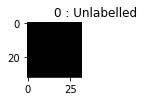

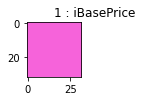

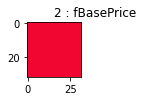

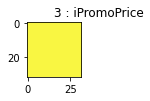

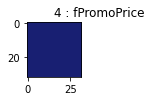

...

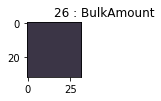

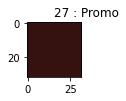

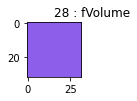

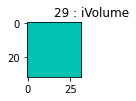

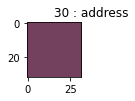

In [21]:
print_legend()

In [40]:
# визуализация точности
def process_image(filename):

    # original image
    original_image = load_image(TARGET_IMG_PATH + filename)#, target_size=IMG_SIZE)

    # original label
    label = load_image(TARGET_LABELS_PATH + filename)#, target_size=IMG_SIZE) 
    #
    Yclass_test = np.zeros(INPUT_SHAPE, dtype=np.uint8)
    for y in range(IMG_SIZE[0]):
        for x in range(IMG_SIZE[1]):
            class_index = label[y,x][0]
            if class_index in CLASSES:
                color = CLASSES[class_index]["color"]
                Yclass_test[y,x]= color

    # predicted
#     x_test = np.array(original_image, dtype=np.uint8)
#     x_test   = np.expand_dims(x_test, axis=0)
#     predictions = model.predict(x_test)
    x_test = tf.constant(original_image, dtype=tf.float32)
    x_test   = x_test[tf.newaxis, ...]    
    predictions = model(x_test)
    predictions = np.argmax(predictions, axis=3)
        
    #
    Yclass_answ = np.zeros(INPUT_SHAPE)
    for y in range(IMG_SIZE[0]):
        for x in range(IMG_SIZE[1]):
            class_index = predictions[0,y,x]
            color = CLASSES[class_index]["color"]
            Yclass_answ[y,x] = color
            #if predictions[0,y,x] != 0:
            #print(predictions[0,y,x])
            
    Yclass_answ = np.array(Yclass_answ, dtype=np.uint8)
    
    # ground true and prediction difference, 
    # если  есть разница, тогда класс оригинального ответа
    #        нет разницы - класс 11 -белый
    Yclass_diff = np.zeros(INPUT_SHAPE, dtype=np.uint8)
    for y in range(IMG_SIZE[0]):
        for x in range(IMG_SIZE[1]):
            if all(np.equal(Yclass_test[y,x], Yclass_answ[y,x])):
                Yclass_diff[y,x] = np.zeros(shape=(3,), dtype=np.uint8)
            else:
               
                Yclass_diff[y,x] = Yclass_test[y,x]
    
    img = np.hstack(
                    (
                        original_image, 
                        Yclass_test, 
                        Yclass_answ,
                        Yclass_diff
                    )
    )
    
    plt.figure(figsize=(22,8))
    plt.title("original image\
                                                                         label\
                                                                         prediction\
                                                                         difference")
    plt.imshow(img)
    plt.show()


d86c324f527ecb86e1312fd2ea571a11.jpg


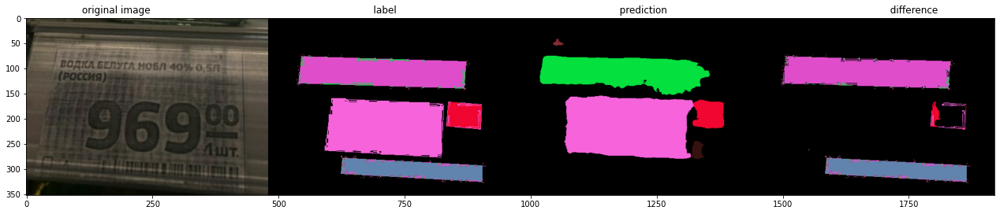

08117b9cc6e938be893148f8d948a54a.jpg


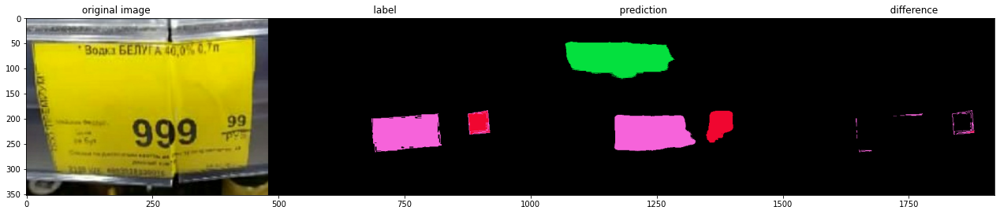

c964ff98d94bf809c5af847e52b7356b_0.jpg


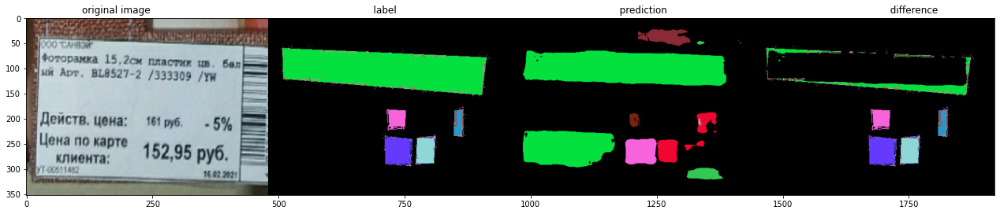

57dbf7aa0f7040fd0b2c3cae256c397d.jpg


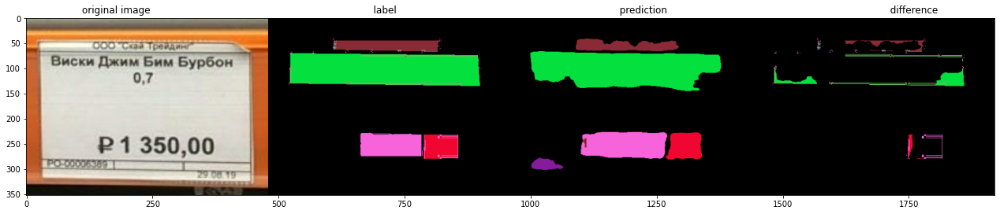

f3e0e05a26e702beec512e95a892df1b.jpg


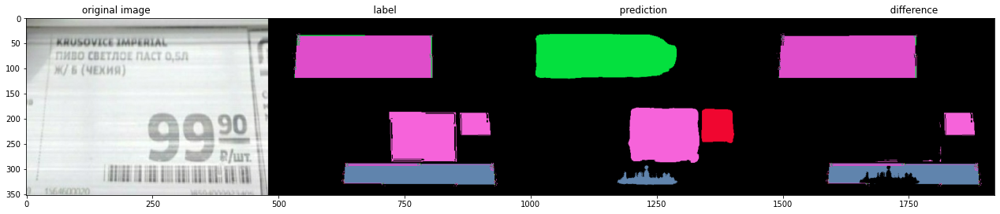

1a5c04c47cb031b54812ed66c720382c.jpg


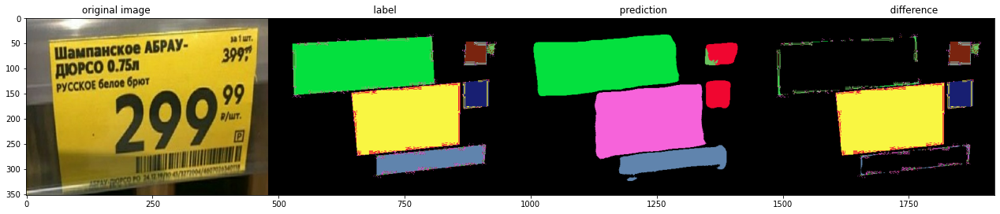

58f92746ae8ace3a9dc4468882851a60.jpg


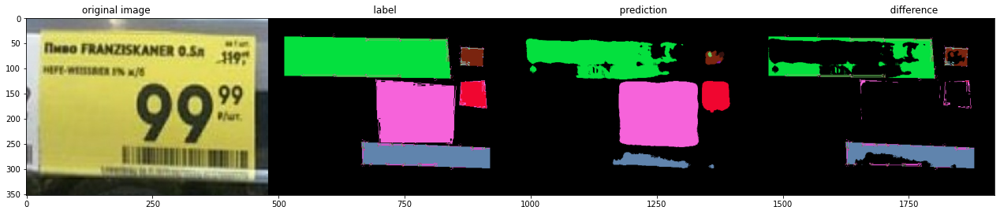

1513b852471983d52d75e0ff85689ae6.jpg


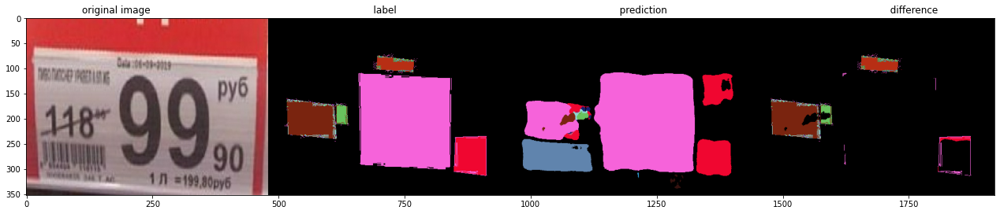

3a5a597b2fa0a84d1d48b5d6f7aeeade.jpg


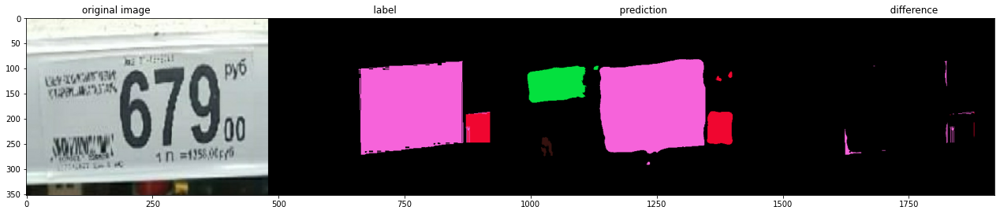

fa86a161cd64302010ea2ef7ede31aad.jpg


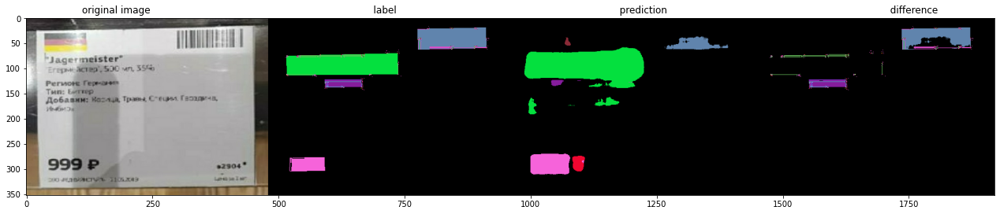

d598a15487956a42a23a62d666ba7ea6.jpg


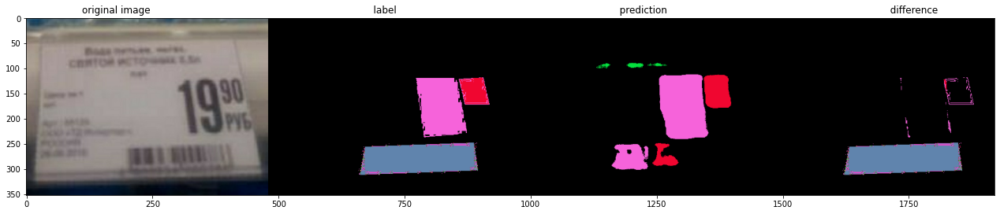

ffdea4ceff21da57881f60164ee89815.jpg


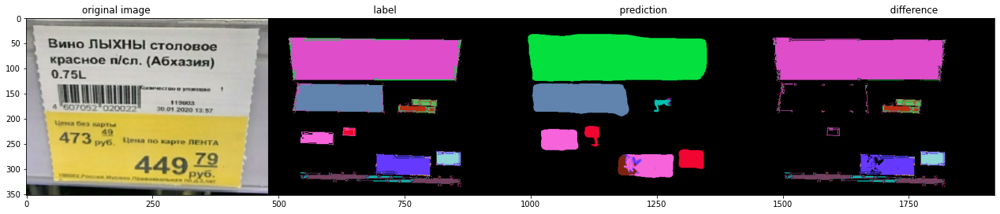

3b5ef3d812ff443becf510d72368e88e.jpg


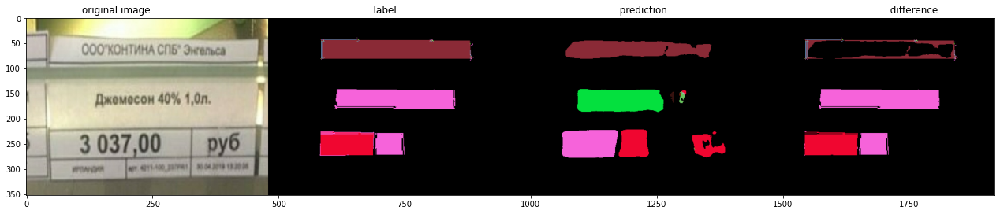

e6950e392132180e064cf20597b05fe6.jpg


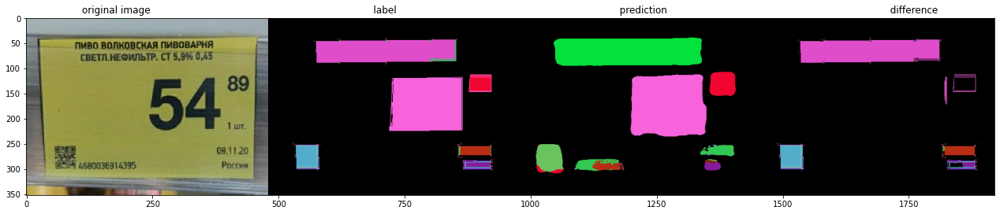

c8ef8e85e4e3ef360cc4312cbcc32ccc.jpg


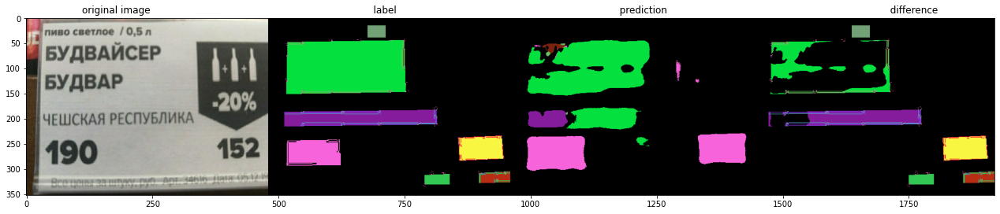

3775ac0bd56f4d14b70e5c396030bf3d.jpg


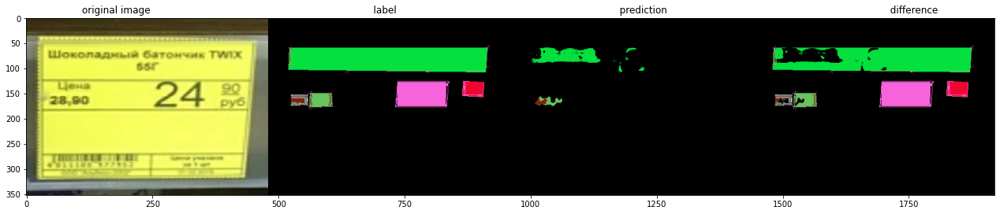

3e7fcba9f9ac54a2c18cbd3d2e272ff6.jpg


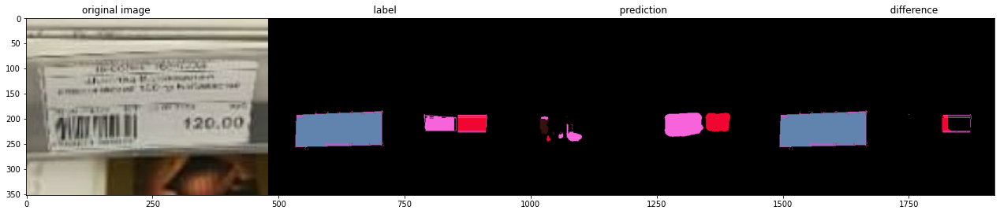

5439f3b6d914c65a056c8207eb6ecbf5.jpg


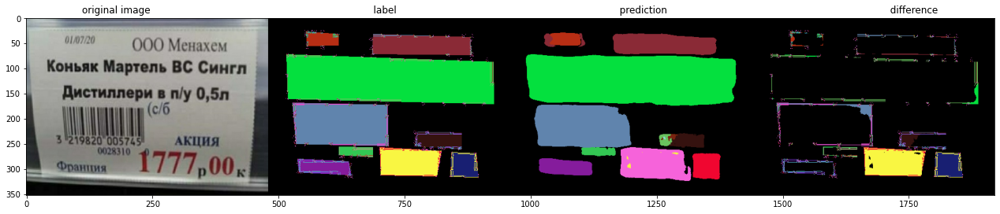

3997d27ac2ad2794a7c27935c3febe65_0.jpg


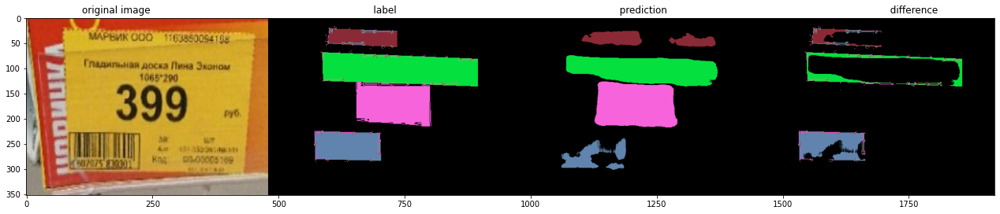

df4c9a599a45ac5b0f57aafc7acfe565.jpg


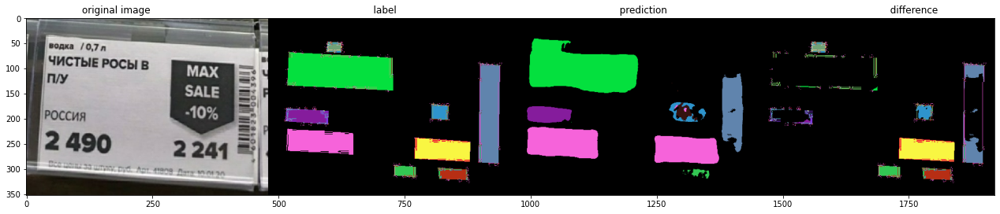

49eed4fe56a1c1ee69f7c9c75662be43.jpg


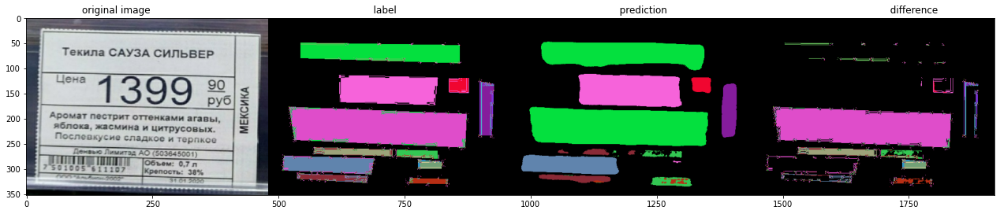

1680106a05806230c80360f0de949ceb.jpg


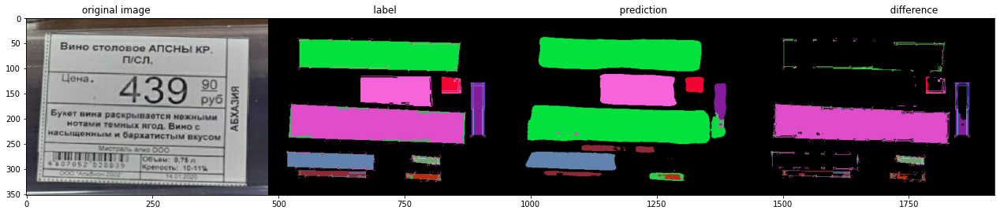

0e2b129e1f09f8b22463d401dce99776.jpg


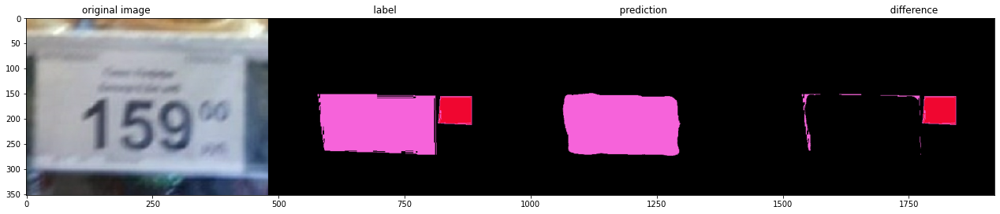

3f556947063cf581cb77e0503b21ed96.jpg


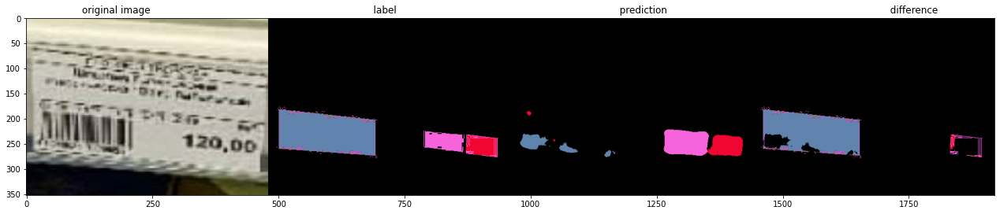

de23c5593a8121d8e13e99b886c082e9.jpg


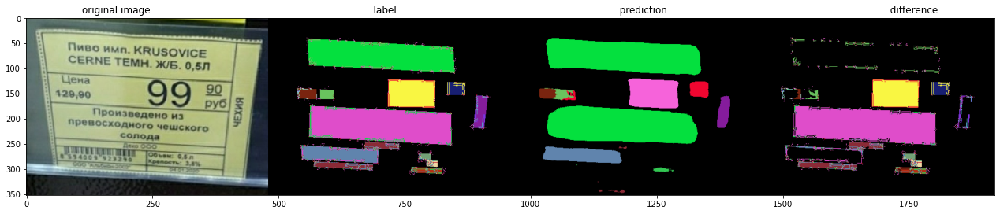

1c0dceac6c6800724bb9749694e8d65e_0.jpg


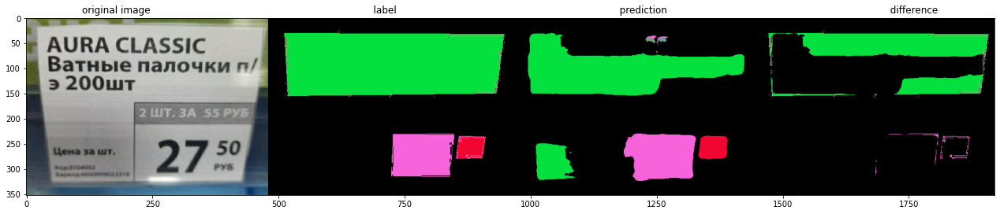

3312c637d93da8b5c23ea964b62b83bf_0.jpg


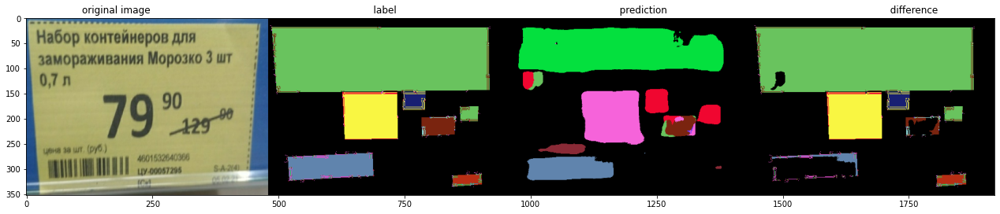

2eba1fffef97d05ebaebbe980abc62b4.jpg


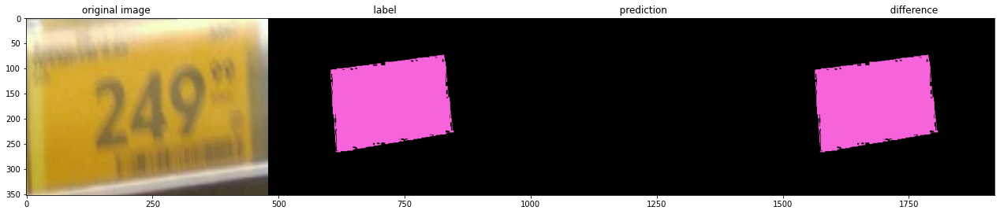

fb693d01bad338b74fb29b1ddf9558aa.jpg


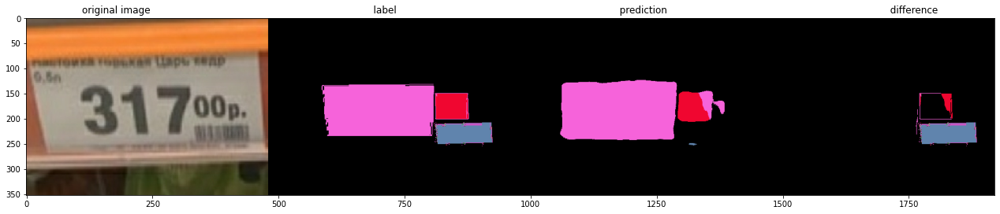

0c82a0b8dc11f5647579ef160dc92cc1.jpg


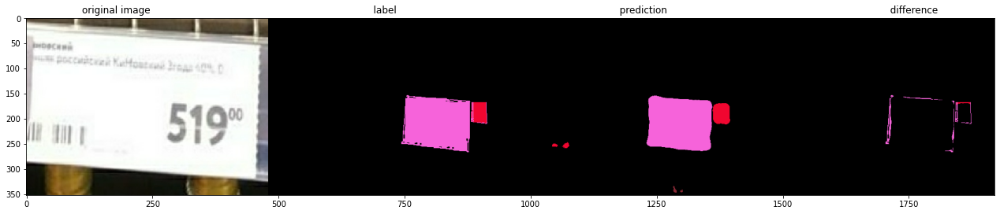

5c2c51b7450b249cdabf5df6c38485c1_0.jpg


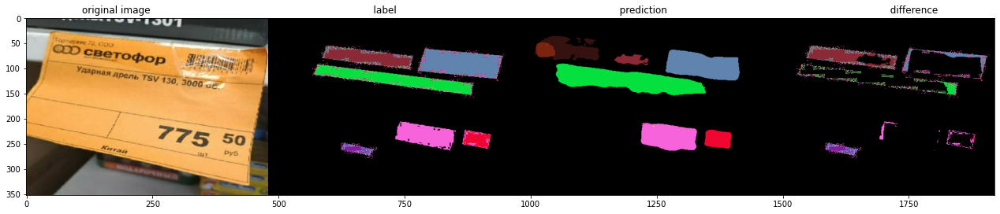

32d55bfec469a45e44a6bad1cb3ed396.jpg


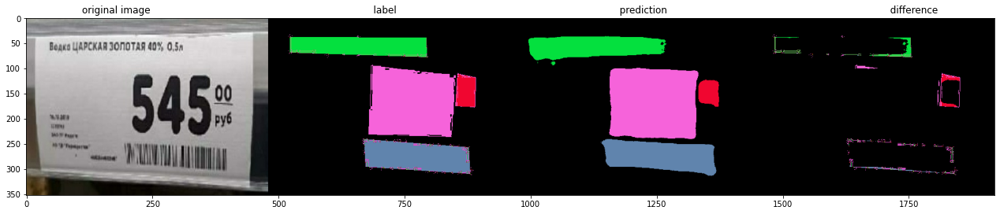

3be47e9950d9c074b76e504f083b965f.jpg


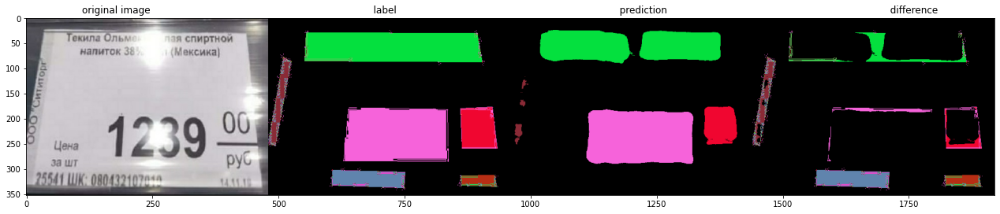

43b2ee50d5c855a36450178094d6351d.jpg


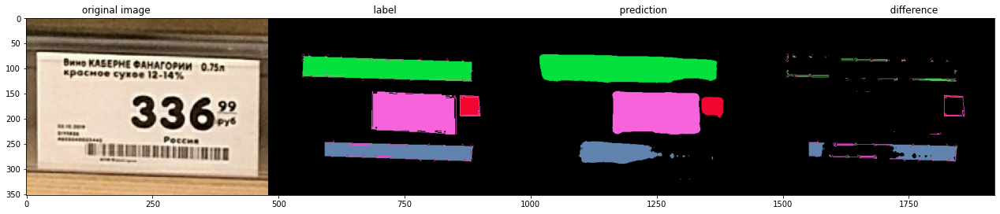

c6e4650ea81836614b36a777e447589e.jpg


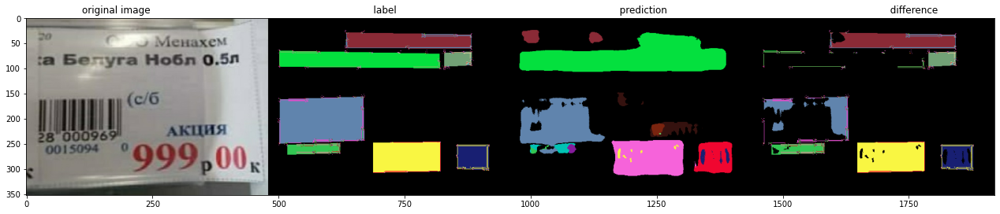

40c18ac7f194d3944ec4b5f8a9862ae7_0.jpg


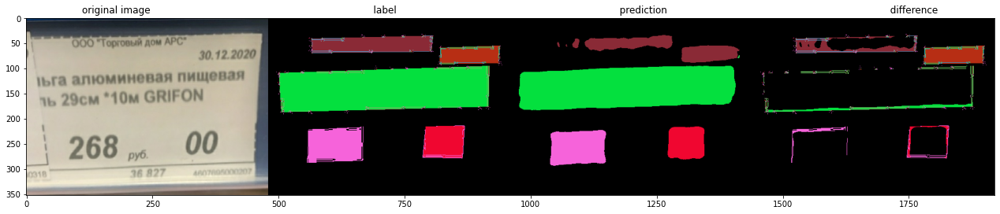

1ac5acbf4a6f3e04e6bb8b85f5e4a598.jpg


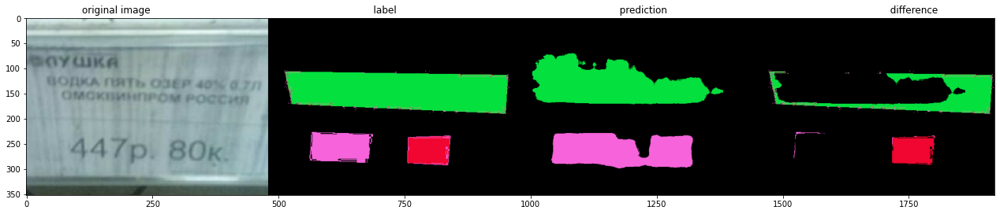

d91914e3f0dab553aae6bb784b882d2f.jpg


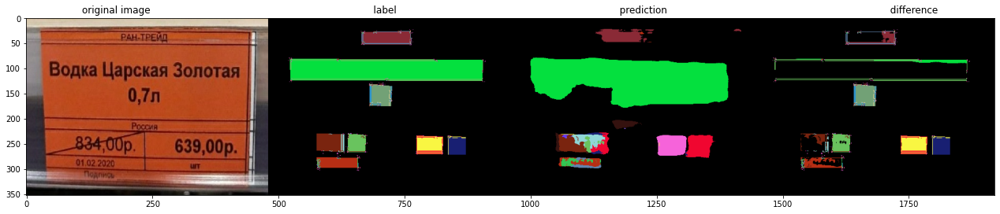

af8d811ec11b59bb3ce403d266ed33c0.jpg


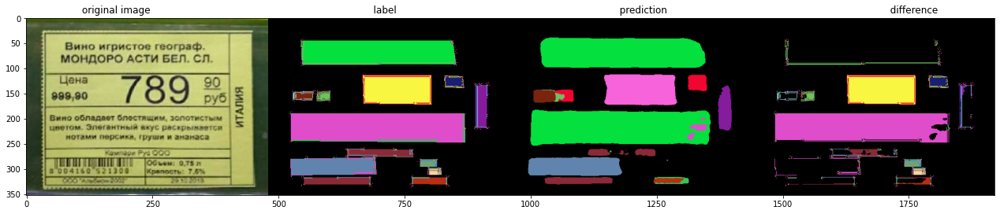

b764c7a5c83ebcac5fed93f49e7bab13.jpg


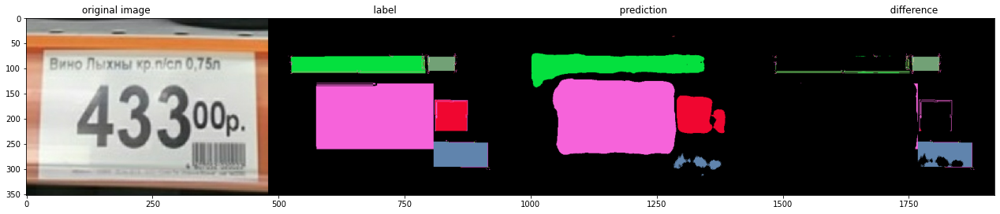

f450e12eda885baeda47da8cdb7a1fab.jpg


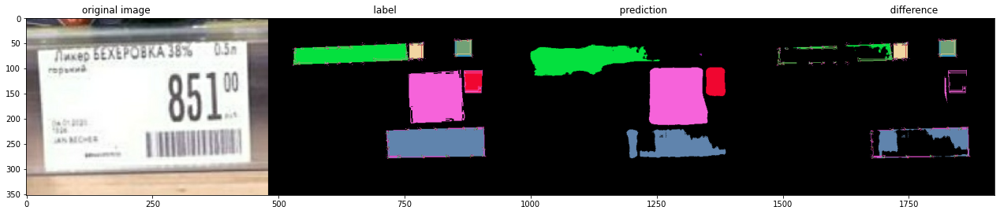

2e3be5c244d56df0b9518f6ec5e1015f.jpg


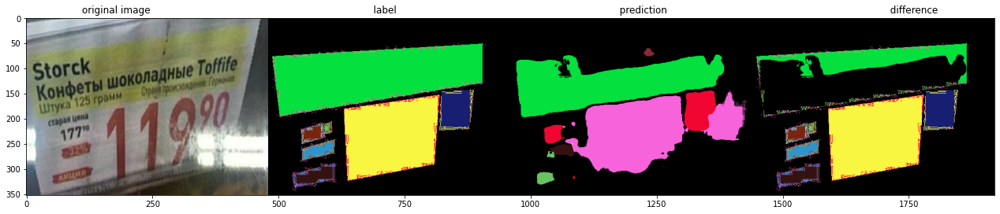

cec32f6e578d4607d537eea751a75b10.jpg


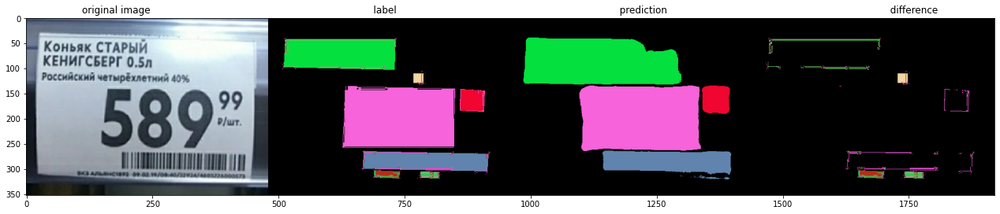

fbb74971030459113568e1d5988bec76_0.jpg


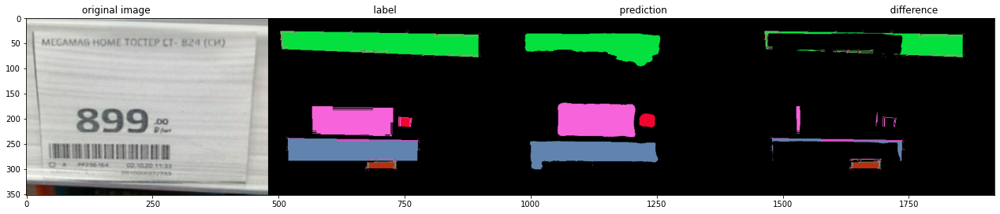

f4b97fa6650b22dd9c2a954b0142f400.jpg


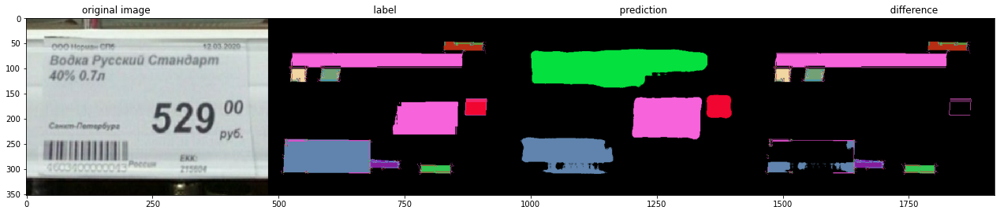

bf9e7a4e699e34ed6a8d4d48d3c9741f.jpg


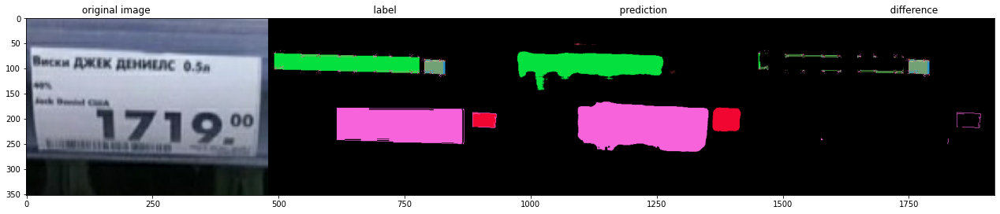

4eba1272dca08a792079212004066207.jpg


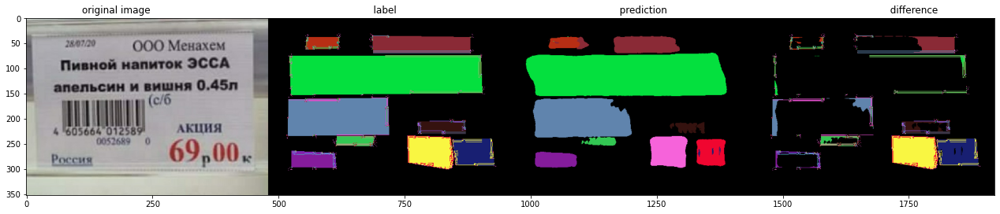

07d988a627905ce3b01911dcf71b0215.jpg


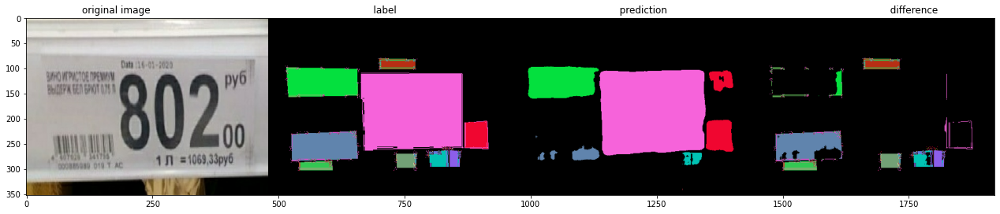

f1f0473ab6179be68e526be09285e964.jpg


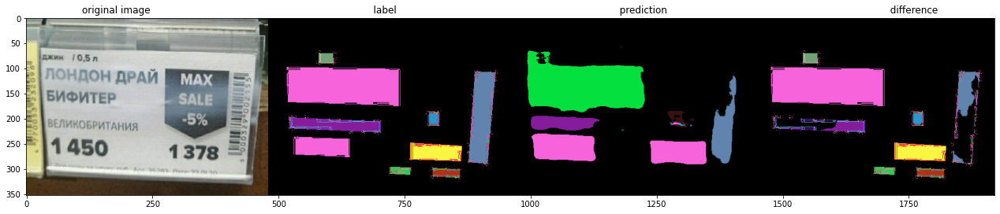

3775ac0bd56f4d14b70e5c396030bf3d.jpg


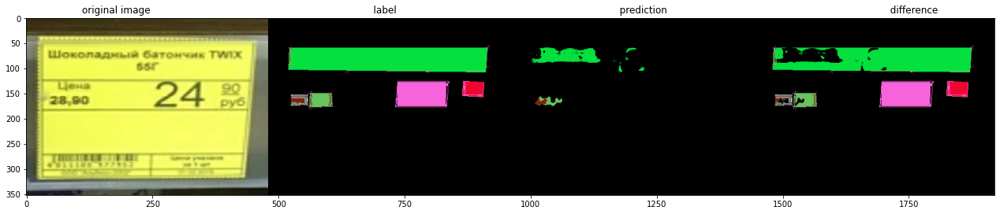

e860e1f4c5f87b83c5eec23e29e62572_0.jpg


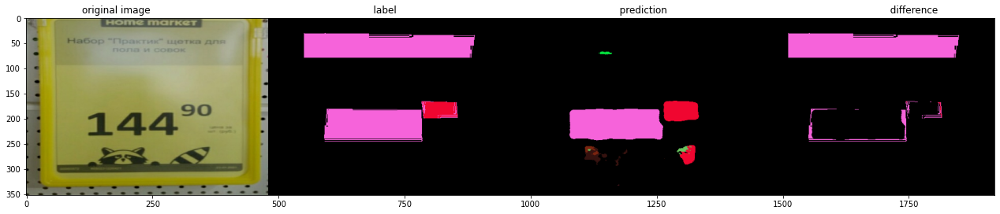

050cd2a9bf111ec38bc93ea55fd68d6d.jpg


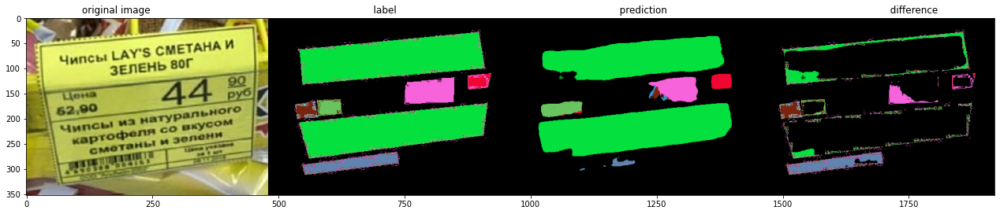

ed579a46237620930e4067bab5cd8c08.jpg


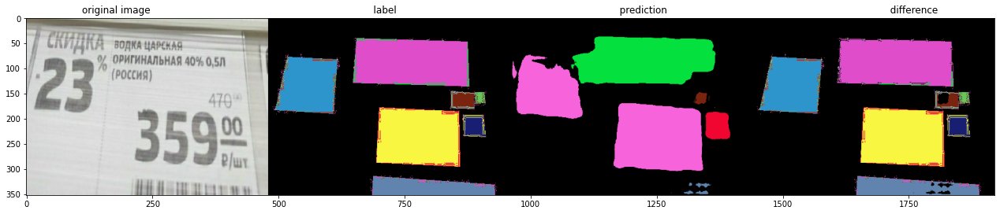

69f0a5f79986ba557d8e97c4b73ff478_0.jpg


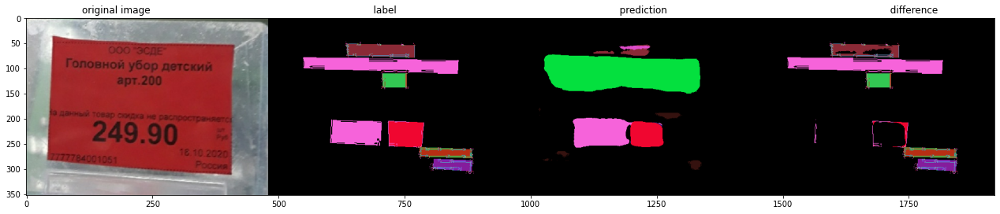

44ca090c85164efb2644b647d7307dd8.jpg


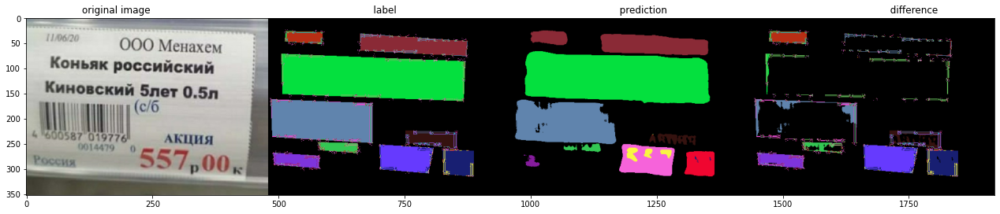

02575807023e42407858bb7651469afe.jpg


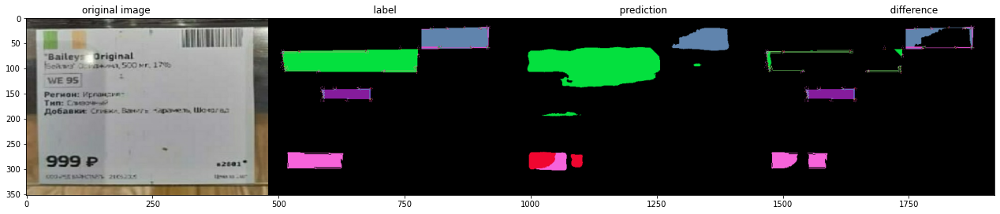

b0c3d77612fb2e2a1fb5bb587f64752f.jpg


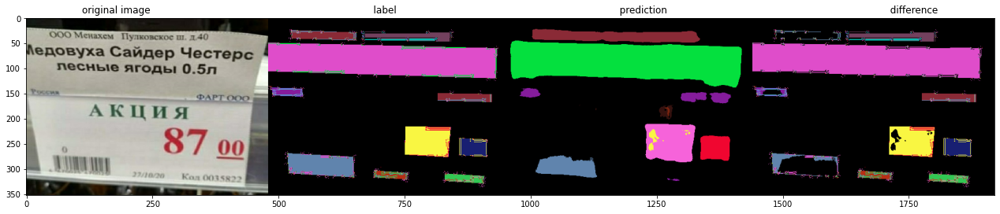

ad37a7b5c9ccb6d85ecdfbbc20d812ce.jpg


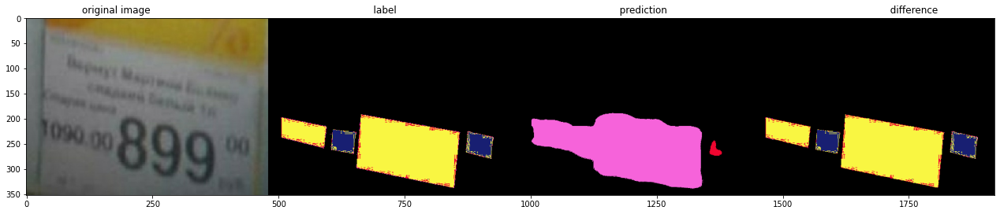

44e34bff3324500d3c1aea7445aec7af.jpg


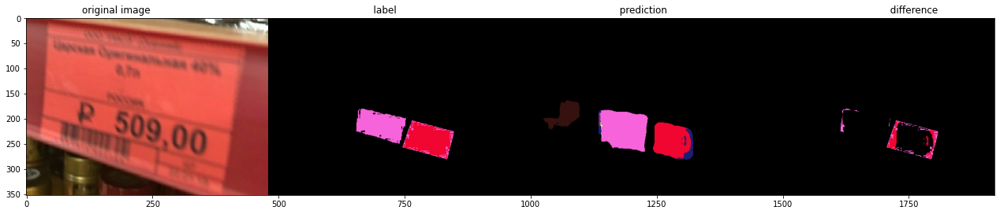

603e454f6f267185beb789d67591d62b_0.jpg


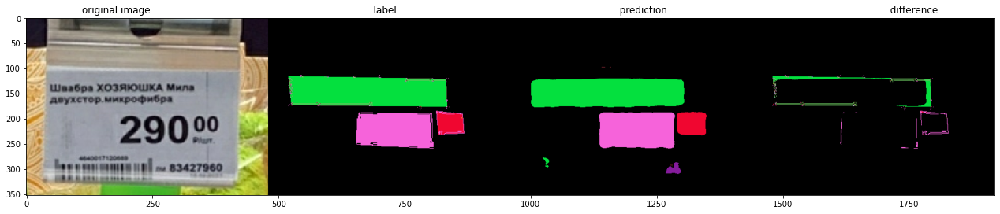

d25b10436d4b316c7e76122c3b5841a8.jpg


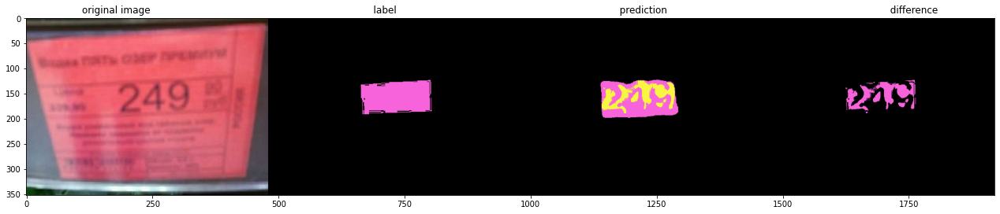

0488a6ca9c50fcaf24c0b70e54f3f998.jpg


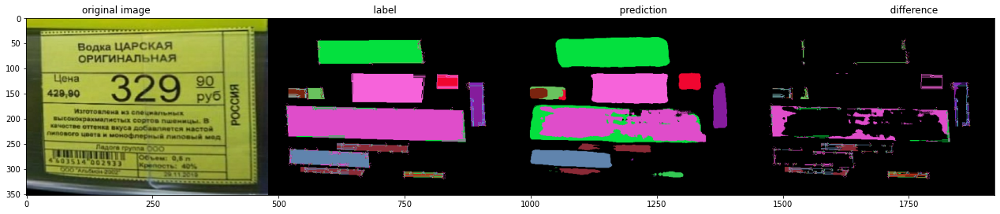

5088a536d0c963068546c8bdaeb44dc3.jpg


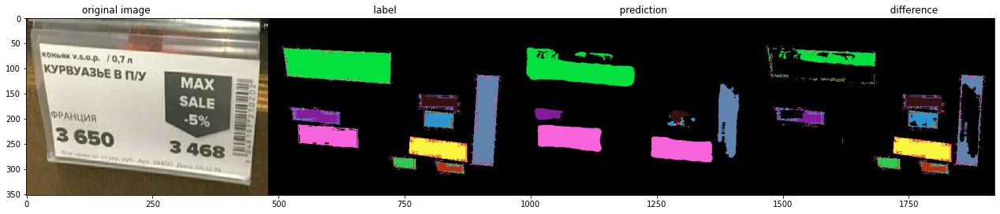

497ecb8618af9b552237d2db8873a06d.jpg


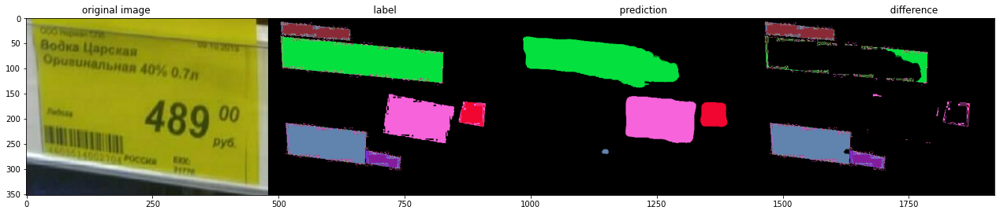

f9d03b2cf7c8d27b4a59f0ec18aeb22d_0.jpg


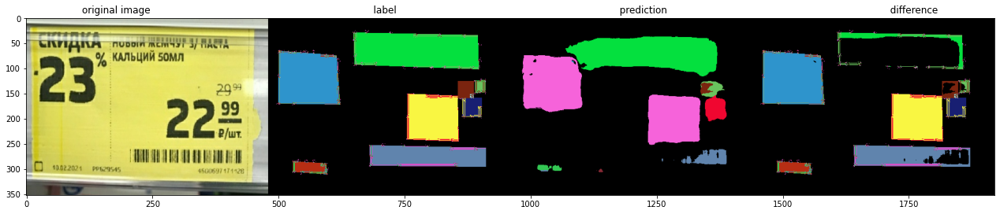

7c2168b4671b0381977f9bab5a79101a_0.jpg


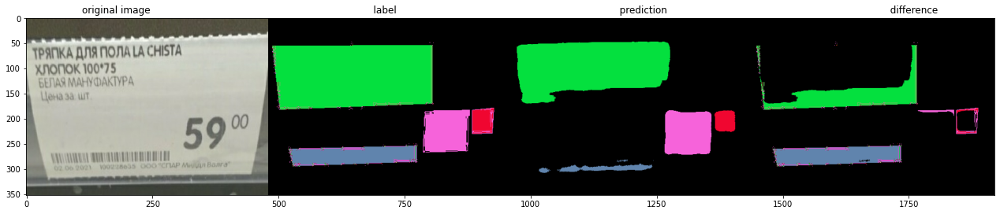

d652218e4bbc51c46879c39ece824276.jpg


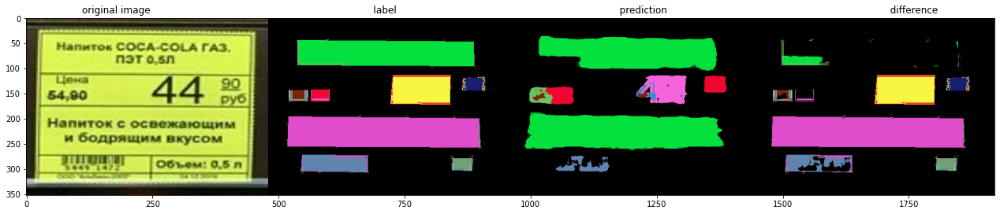

df79b9a9cccb506f98b18eb53a5753cb.jpg


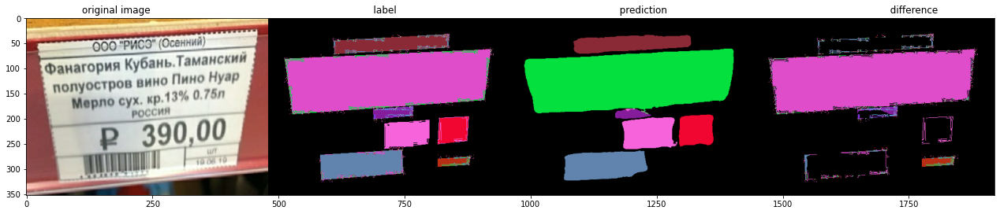

d9c792c80023e053260476817f155869_0.jpg


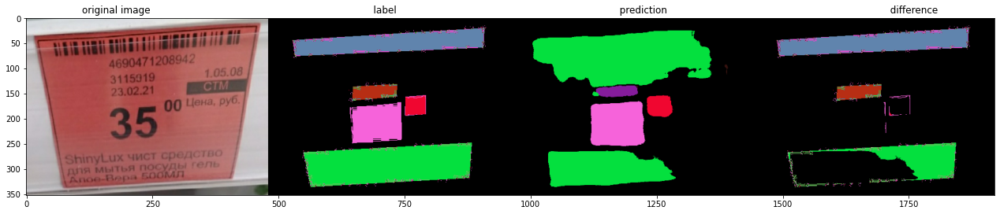

aea9a7aaccaaa373e1cd06b3c6055783.jpg


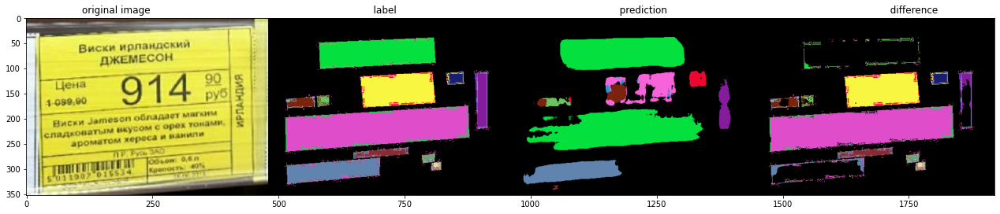

106ad16d0181ee209a98749521d302ef.jpg


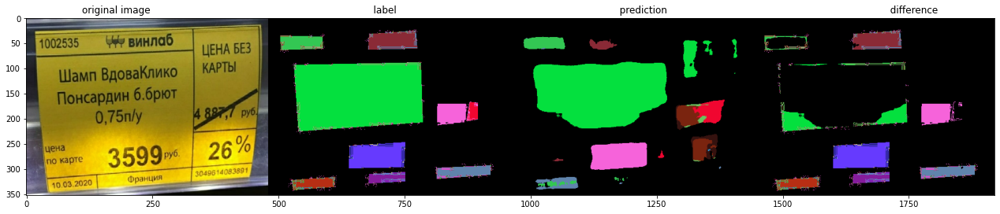

3350ba15544c82e260b3572c38cb5b15_0.jpg


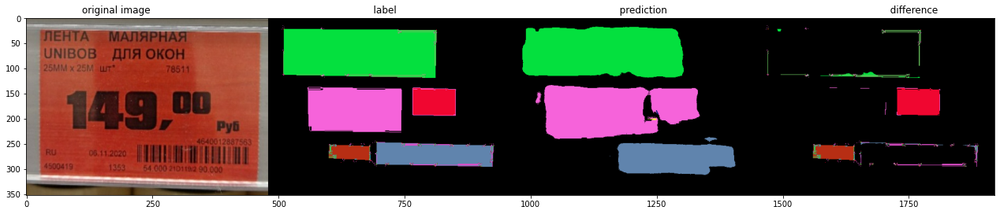

1dc5326b0a54ee03bf729379b74a9f9b.jpg


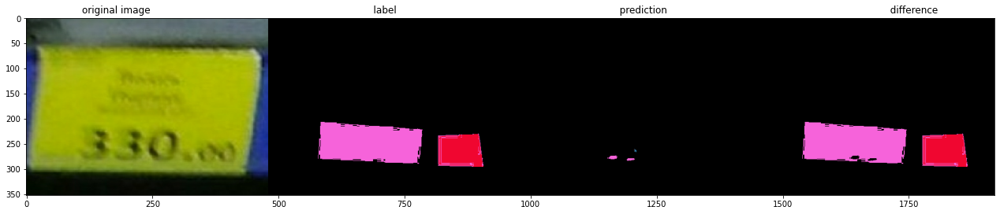

5350698c3b6e7ac91306e9d4bca274cc.jpg


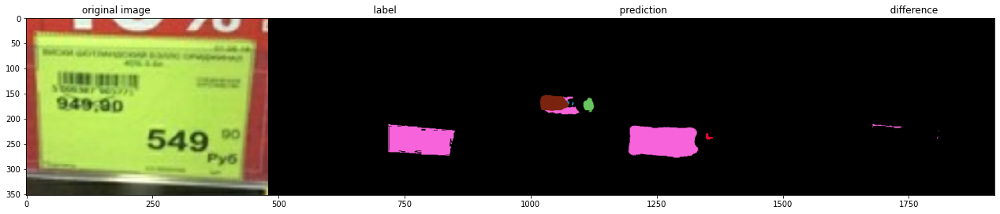

44da56a57dcd90222d4019341cc41b15.jpg


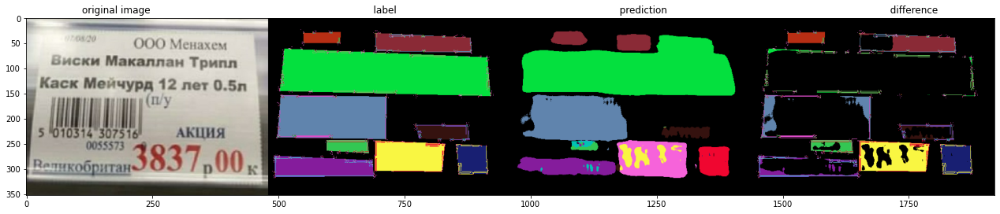

bc522742b13edd6131ded1004e462a7e.jpg


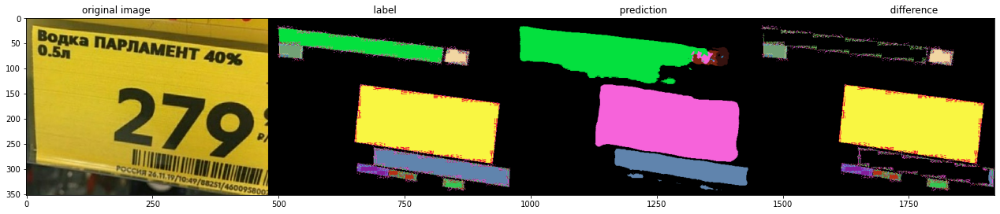

51dad1de4aec0e5dc59f310320006e7e.jpg


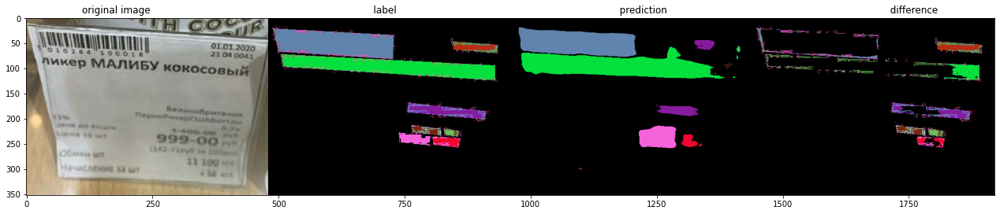

da357c04100af1a1f864d2c2465f66ae.jpg


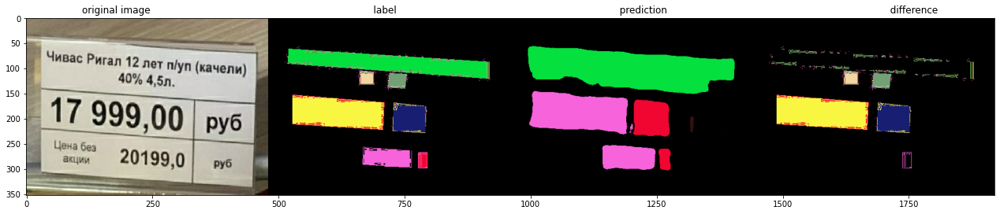

19464be580145ba7cc2621db34c1b5f9.jpg


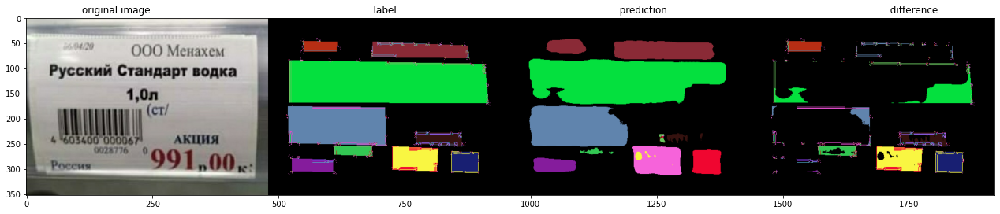

d94df893400e34952a92f8cf9428b7b5.jpg


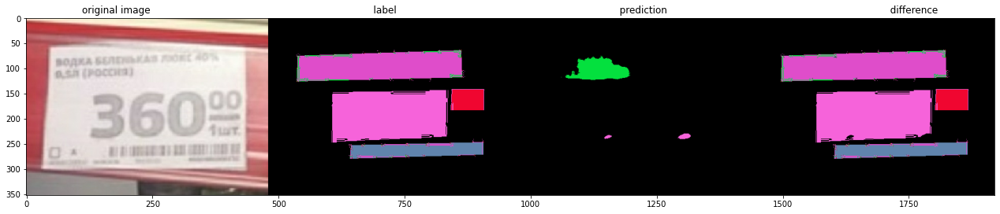

e8ef5e2ffc2a1f2c98678554a23e3584.jpg


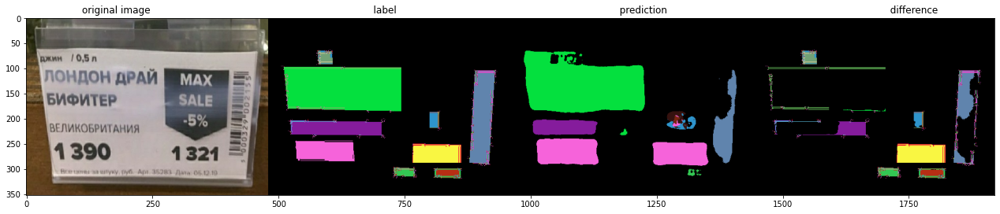

acd81e688fe2f93b4a4799362c6fe0bf.jpg


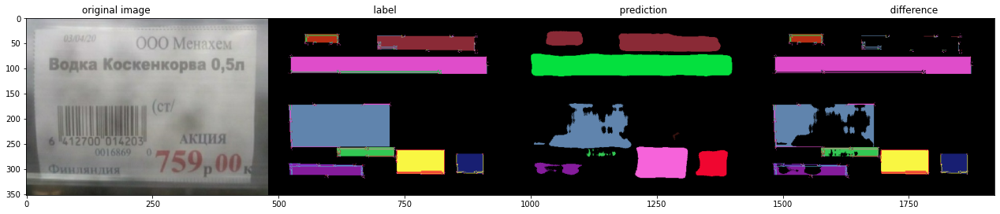

2f74feda088df800c265a42c746d707b.jpg


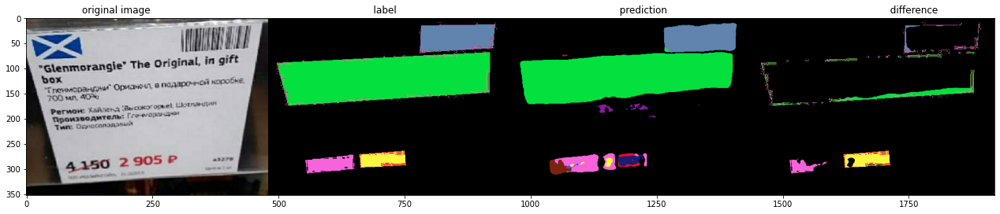

3fa1a646660172c178186a33009f3048.jpg


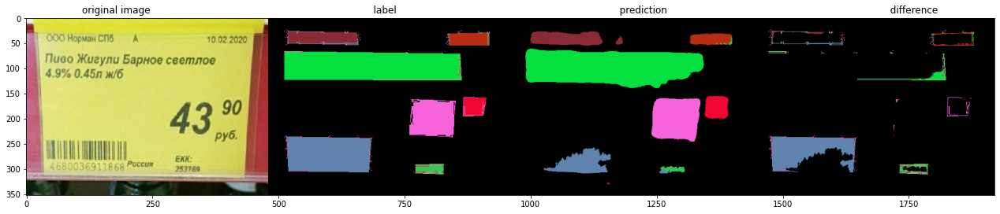

44da56a57dcd90222d4019341cc41b15.jpg


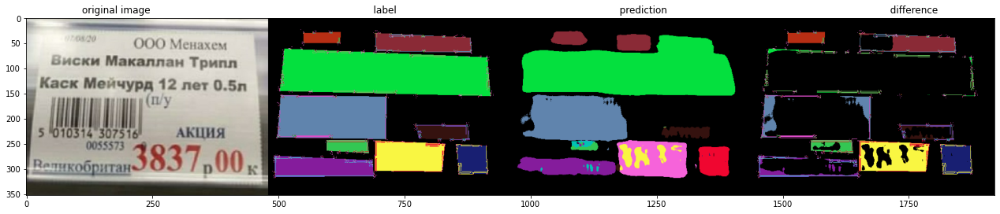

2d8d7d6c46a701c954e88863e293350e_0.jpg


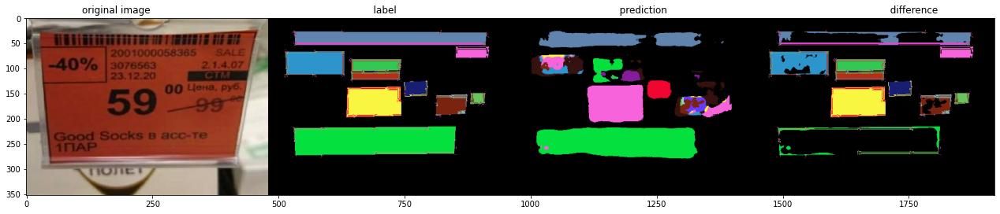

52aa72953715db4b77a7cebc574929e9.jpg


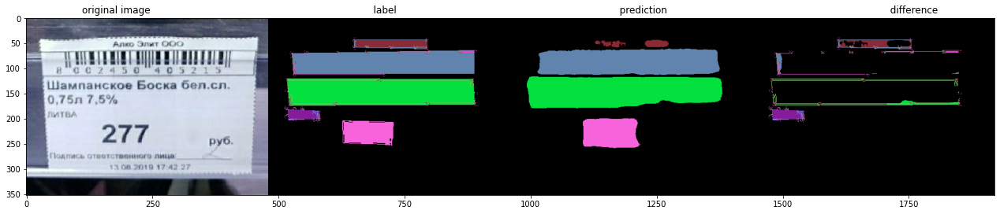

26ba092678c2d222ba2de974a1980e02.jpg


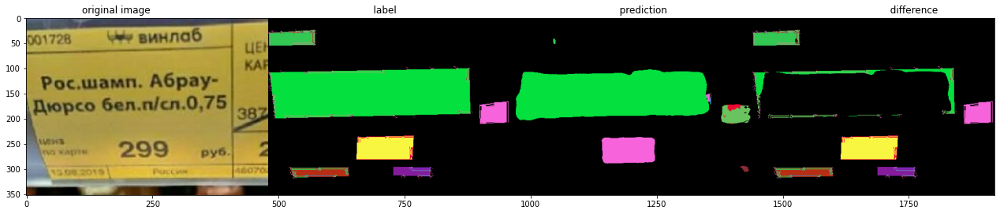

6bfde70037a0ae49a4e4f9a45219a832_0.jpg


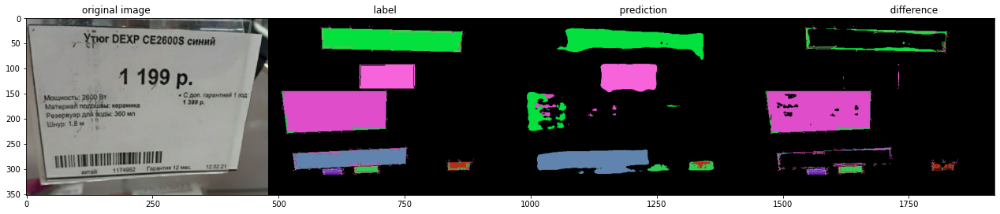

cd8d28b5acf77ff19435805fd80e9930.jpg


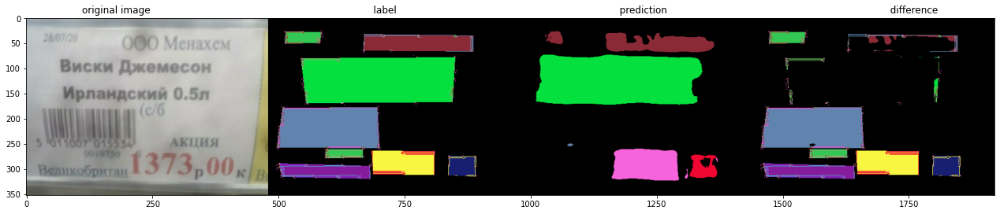

ffae0861bc4293e04d9a9115096b76ec.jpg


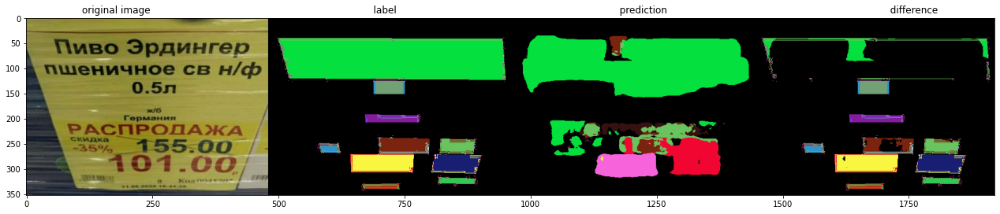

1012017c7eb867d3815dd85d590b8a64.jpg


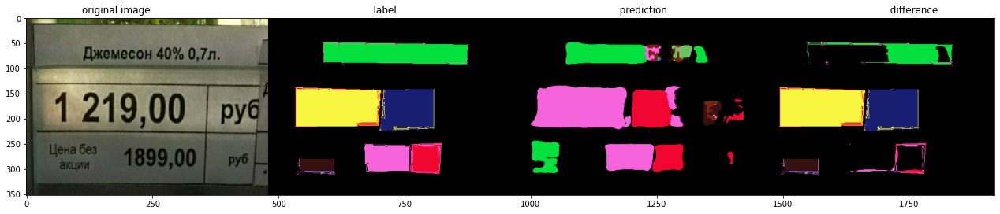

16df14f727c62595c93f620e0ac159c8.jpg


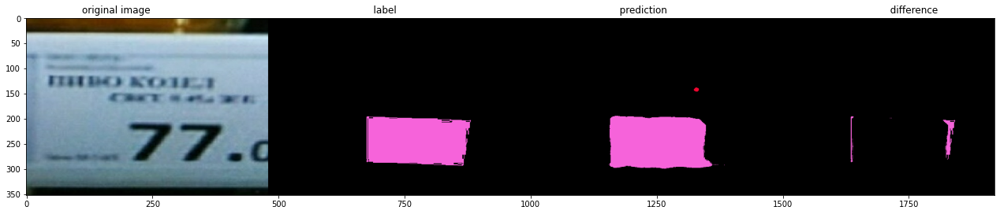

d928c8a790e38f35de64716f111fd8db.jpg


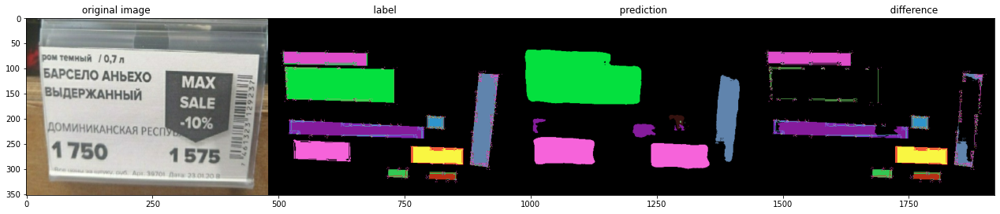

06a85e43ee1e1f13a1d3fa5a8e9d66c2.jpg


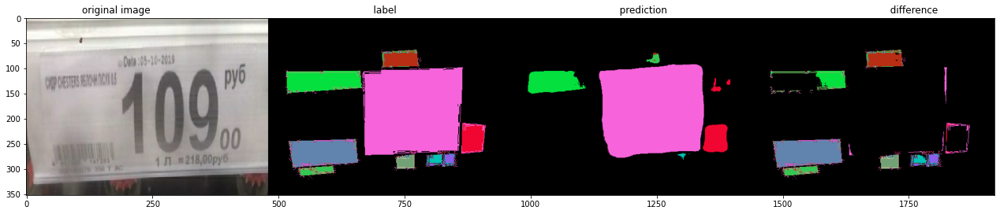

e2949bfcfb38ff41a703d74ca7f9374f.jpg


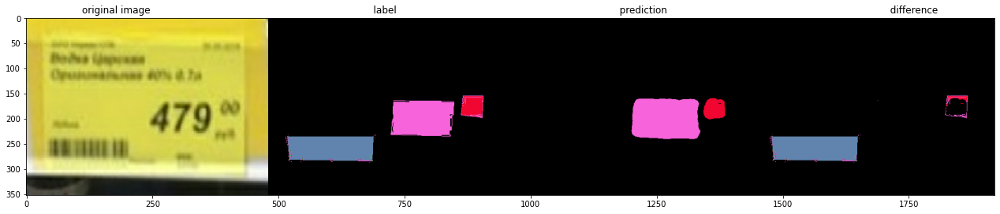

0ea61d0afe0ce07e2b62de6cb3eb50f9.jpg


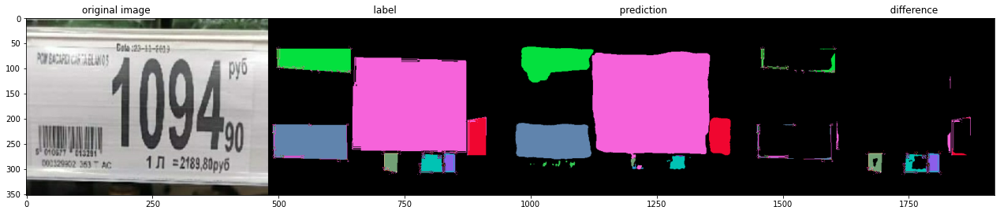

fe9ec2661726b03b7f8e42c835cde4ce.jpg


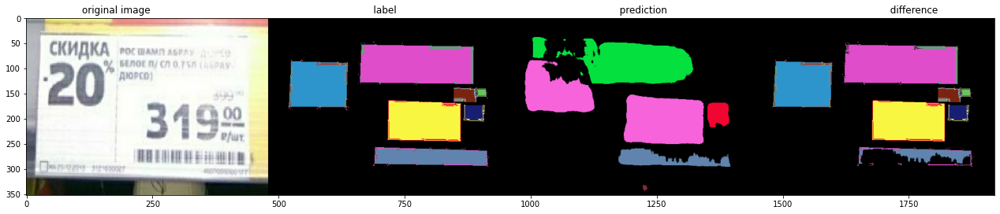

f9fc2c2a6ddadd2846a3acbff4bc288a.jpg


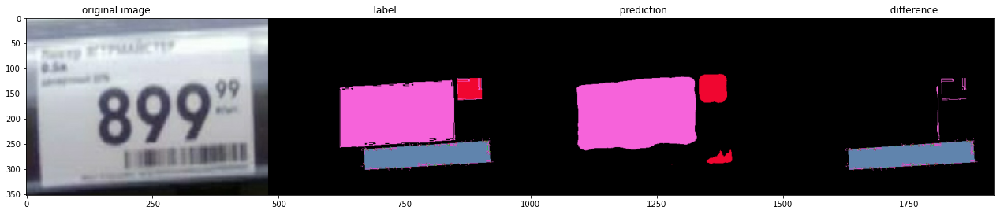

c9e7b0771529b472610e6b445599a7aa.jpg


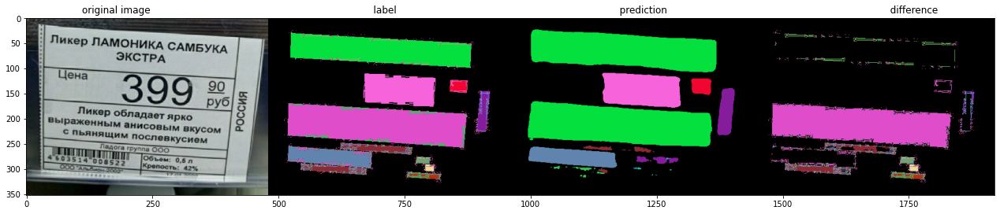

In [41]:
for _ in range(100):
    filename = random.sample(os.listdir(TARGET_IMG_PATH), 1)[0]
    print(filename)
    process_image(filename)

In [50]:
# inference speed test
def test_inference_speed(img_dir, iterations=10):
    fnames = random.sample(os.listdir(TARGET_IMG_PATH), iterations)
    print(f"model inference speed test. iterations = {iterations} time:",end='')
    t1 = time.time()
    for filename in fnames:

        img_np   = load_image(img_dir + filename)
        img = tf.constant(img_np, dtype=tf.float32)
        img  = img[tf.newaxis, ...]
        predictions = model(img)
        predictions = np.argmax(predictions, axis=3)
    t2 = time.time()
    processing_time = t2 - t1
    print(f' {processing_time:.3f} seconds')
    print(f"Avarage inference speed: {iterations/processing_time:.1f} images / sec")
    print(f"Time to process one image: {processing_time/iterations:.3f} sec")


In [51]:
test_inference_speed(TARGET_IMG_PATH, iterations=30)

model inference speed test. iterations = 30 time: 1.691 seconds
Avarage inference speed: 17.7 images / sec
Time to process one image: 0.056 sec


In [52]:
# confusion matrix
# ds_test = load_tfrecord_dataset(DATASET_TEST_PATH)
# # ds_test_batched=ds_test.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE).cache()
# X_test, y_test = ds_test

# lb = LabelBinarizer()

# lb.fit_transform(CLASSES.keys())

# y_pred = model.predict(X_test)

# y_pred = lb.inverse_transform(y_pred, lb.classes_)
# y_test = lb.inverse_transform(y_test, lb.classes_)

# matrix = confusion_matrix(y_train, y_pred, labels=lb.classes_)

# fig, ax = plt.subplots(figsize=(14, 12))
# sns.heatmap(matrix, annot=True, cmap='Greens', fmt='d', ax=ax)
# plt.title('Confusion Matrix for test dataset')
# plt.xlabel('Predicted label')
# plt.ylabel('True label')
# plt.show()

In [55]:
# check for segments extracted


def extract_segments(img_tensor):
    
    segments = dict()

    # get preditcion
#     img_tensor = np.array(img_tensor, dtype=np.uint8)
#     img   = np.expand_dims(img_tensor, axis=0)
#     predictions = model.predict(img)
#     predictions = np.argmax(predictions, axis=3)
#     predictions = predictions[0,:]
#     predictions = predictions.astype(np.uint8)
    img   = tf.constant(img_tensor, dtype=tf.float32)
    img = img[tf.newaxis, ...]
    predictions = model(img)
    predictions = np.argmax(predictions, axis=3)
    predictions = predictions[0,:]
    predictions = predictions.astype(np.uint8)
    
    for cls in CLASSES:
        class_predictions = np.where(np.equal(predictions, cls), 1, 0 )
        if cls > 0: # skip 'Unlabelled'
            segment = class_predictions & 1 
            seg_img = np.full(shape=segment.shape, fill_value=255, dtype=np.uint8)
            seg_img = (segment & seg_img)
            seg_img = seg_img.astype(np.uint8) # bitwised segment           
            blurred = cv2.GaussianBlur(seg_img, (3, 3), 1.0)

            _, thresh = cv2.threshold(blurred,0,255,cv2.THRESH_BINARY + cv2.THRESH_OTSU)

            contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            if len(contours): # if there are no countours, segment is not found   
#                 print(f'found segment: {CLASSES[cls]["id"]}')
                for i, contour in enumerate(contours):
                    area = cv2.contourArea(contour)

                    if area >= MIN_SEGMENT_AREA: # Ignore contours that area is too small                   

                        # get rotated rectangle from outer contour                        
                        rect = cv2.minAreaRect(contour)  
                        box = cv2.boxPoints(rect) 
                        box = np.int0(box)

                        W = rect[1][0]
                        H = rect[1][1]

                        Xs = [i[0] for i in box]
                        Ys = [i[1] for i in box]

                        x1 = min(Xs)
                        x2 = max(Xs)
                        y1 = min(Ys)
                        y2 = max(Ys)

                        angle = rect[2]
                        if angle < -45:
                            angle += 90

                        if angle <= 90 and angle >= 85:
                            angle = 0

                        # Center of rectangle in source image
                        center = ((x1 + x2) / 2, (y1 + y2) / 2)

                        # Size of the upright rectangle bounding the rotated rectangle
                        size = (x2 - x1, y2 - y1)
                        M = cv2.getRotationMatrix2D((size[0] / 2, size[1] / 2), angle, 1.0)

                        # Cropped upright rectangle  
                        cropped = cv2.getRectSubPix(img_tensor, size, center)
                        """                      
                        if cls in CLASSES_TO_ROTATE:
                            cropped = cv2.warpAffine(cropped, M, size)

                            croppedW = H if H > W else W
                            croppedH = H if H < W else W


                            # Final cropped & rotated rectangle
                            cropped = cv2.getRectSubPix(cropped, (int(croppedW), int(croppedH)), (size[0]/2, size[1]/2))
                        """
                        if segments.get(cls) == None:
                            segments[cls] = list()
                        segments[cls].append(cropped)

    return segments

        

2a8630631ab2e24b5c762f9e05d10d33.jpg


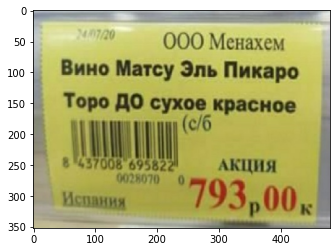

found segment: iBasePrice


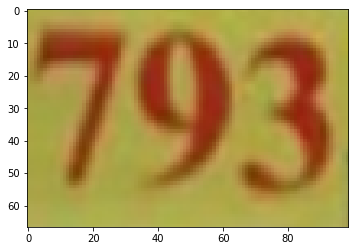

found segment: fBasePrice


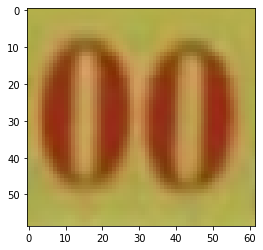

found segment: Name


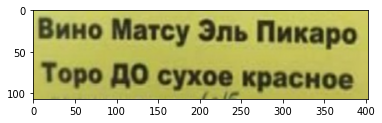

found segment: BarCode


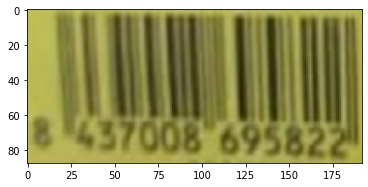

found segment: Vendor


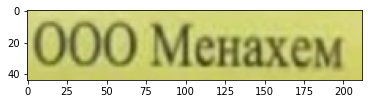

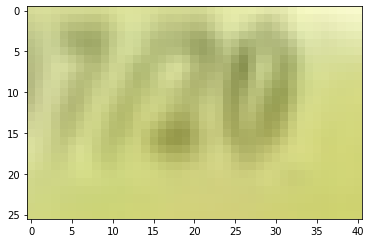

46ebaf64e15318aab524f905da71fab2.jpg


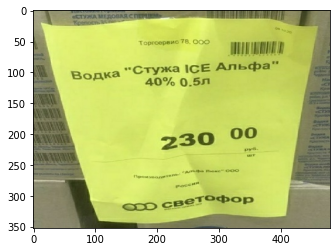

found segment: iBasePrice


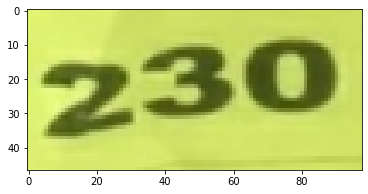

found segment: fBasePrice


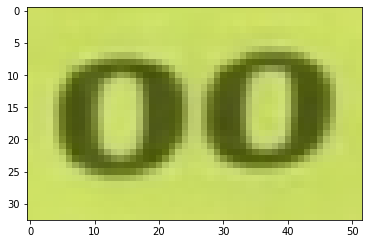

found segment: Name


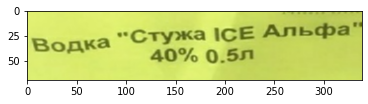

found segment: Vendor


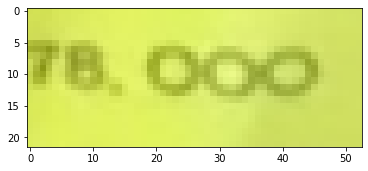

24e2c8a8c1d002675270de3dda65167f.jpg


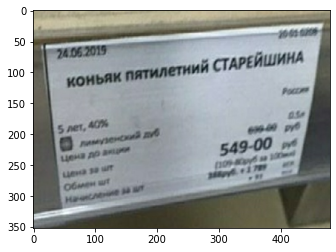

found segment: iOldPrice


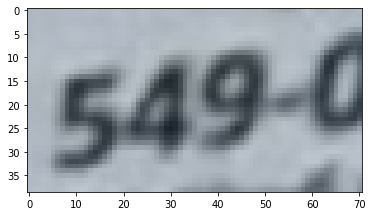

found segment: Name


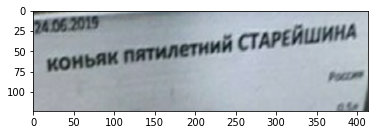

found segment: Vendor


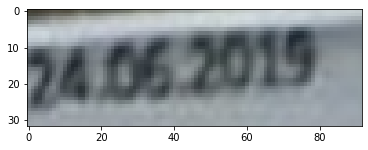

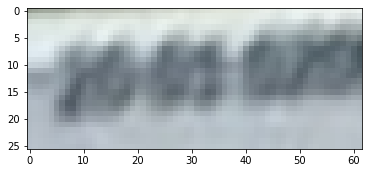

2692344edc3c0dfc1c61acd00c2b49d5.jpg


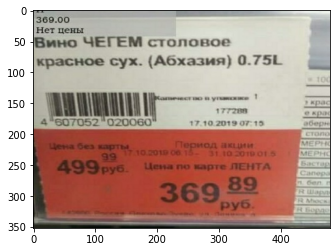

found segment: iBasePrice


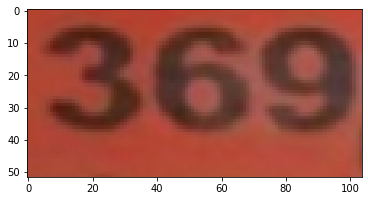

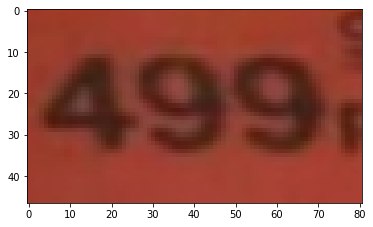

found segment: fBasePrice


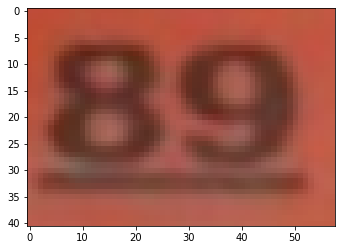

found segment: Name


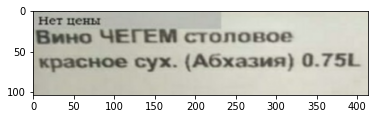

found segment: BarCode


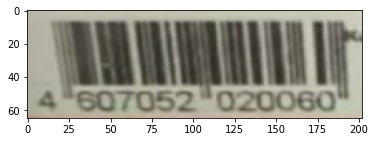

d3a99c6cb95abcd7b1b7554e9228f6cd.jpg


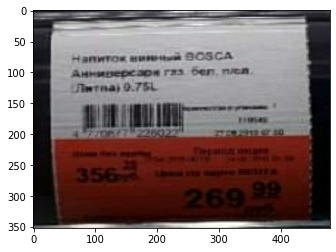

found segment: iBasePrice


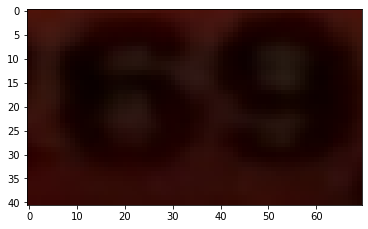

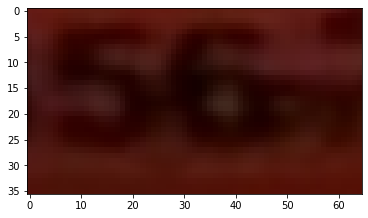

found segment: fBasePrice


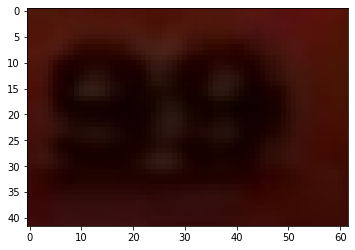

found segment: Name


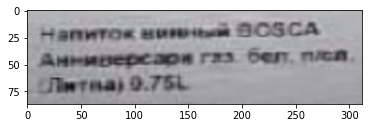

found segment: BarCode


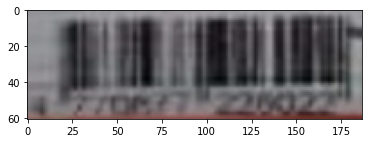

bf917c5924af8395a4a5171cfb89e104.jpg


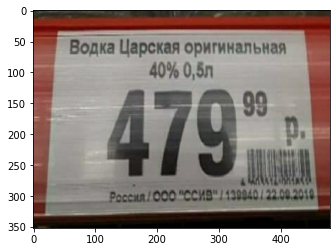

found segment: iBasePrice


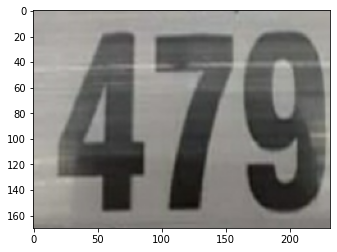

found segment: fBasePrice


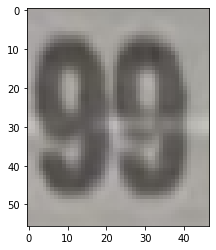

found segment: Name


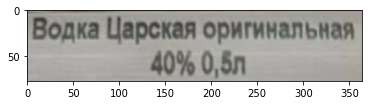

found segment: BarCode


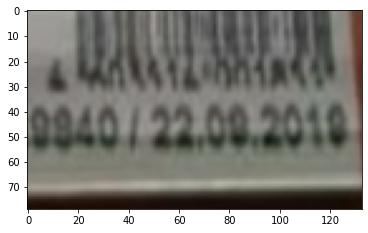

found segment: Country


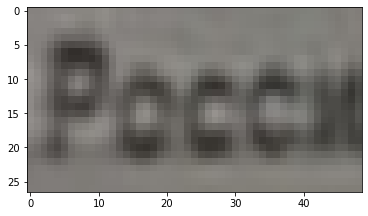

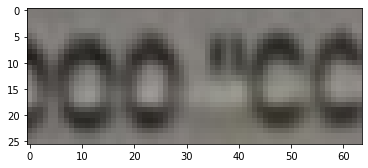

009b5c3417c3b07379cd8f9b00ac72e8.jpg


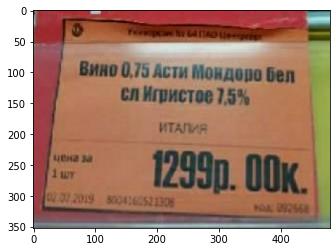

found segment: iBasePrice


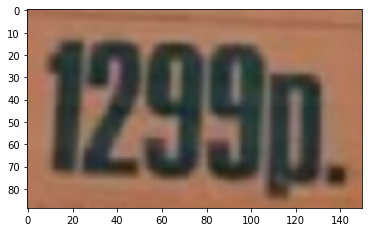

found segment: fBasePrice


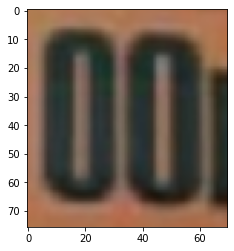

found segment: Name


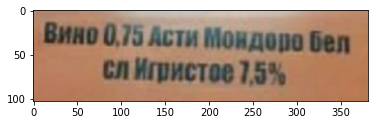

found segment: Vendor


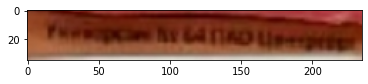

b02b01cbdbff7c57b2b2fa7804c40440.jpg


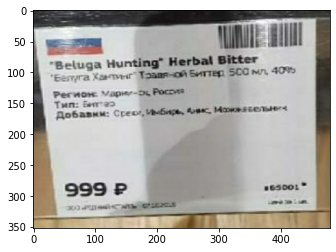

found segment: iBasePrice


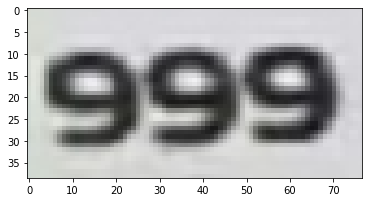

found segment: Name


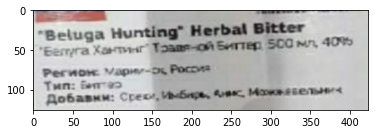

found segment: BarCode


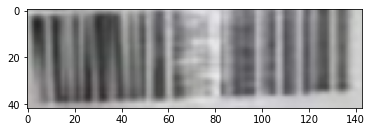

60ea63d68e0d1feb36182284365b149a_0.jpg


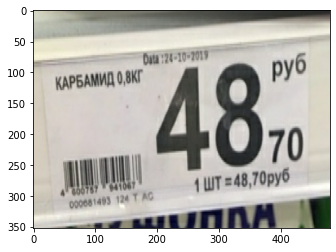

found segment: iBasePrice


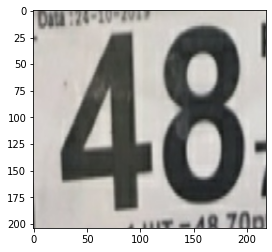

found segment: fBasePrice


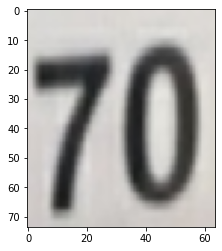

found segment: Name


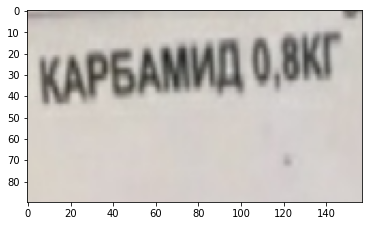

found segment: BarCode


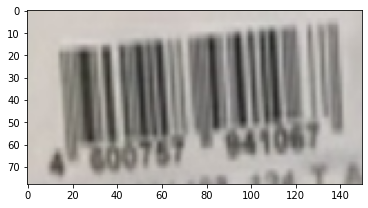

de66fff4a8073761e6136358fa869474.jpg


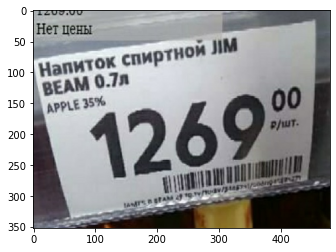

found segment: iBasePrice


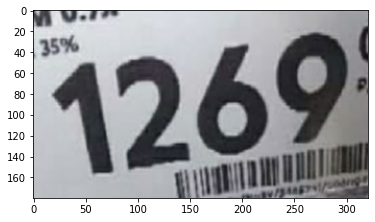

found segment: fBasePrice


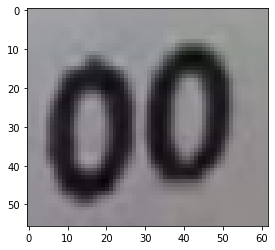

found segment: Name


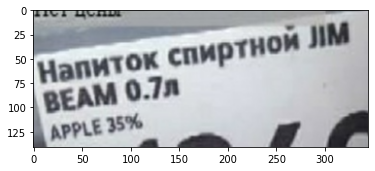

found segment: BarCode


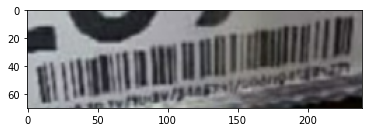

245ca50a91cac33c9d28e8711ed9ee0f.jpg


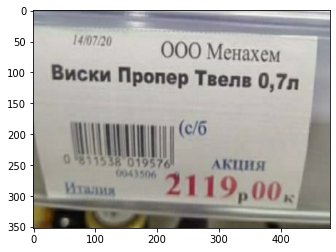

found segment: iBasePrice


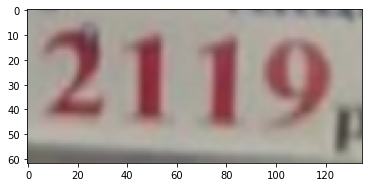

found segment: fBasePrice


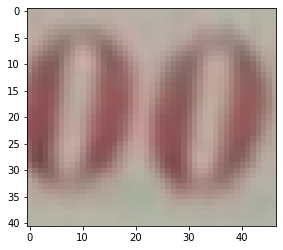

found segment: Name


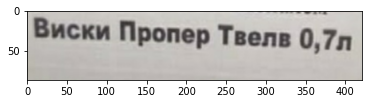

found segment: BarCode


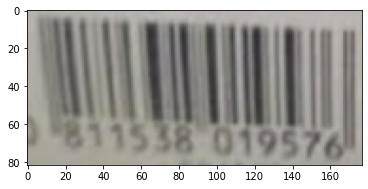

found segment: Vendor


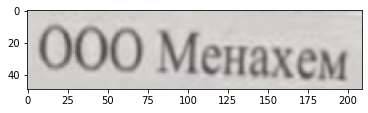

found segment: Date


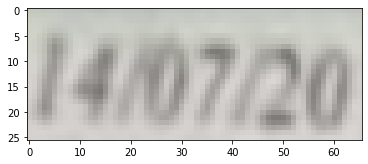

c09014a9dcc596091f86b8ee7909b1c6.jpg


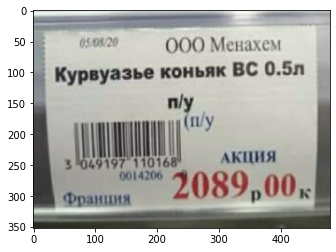

found segment: iBasePrice


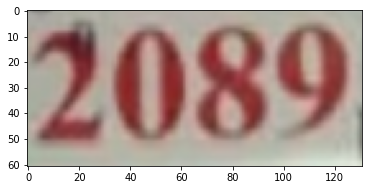

found segment: fBasePrice


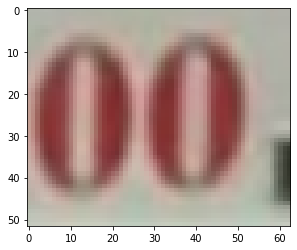

found segment: Name


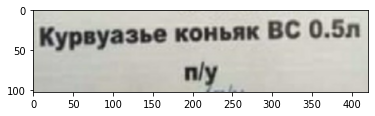

found segment: BarCode


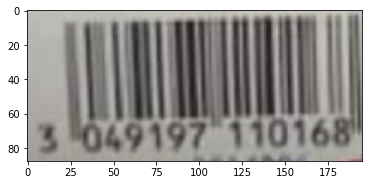

found segment: Vendor


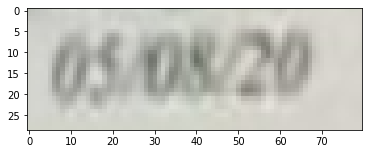

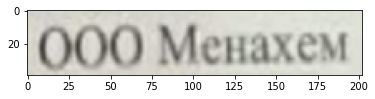

found segment: SKU


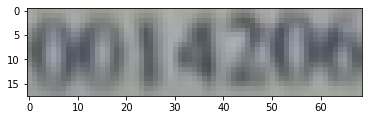

found segment: Country


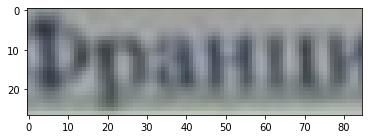

5161eca12642d477ff8efb855206cab3.jpg


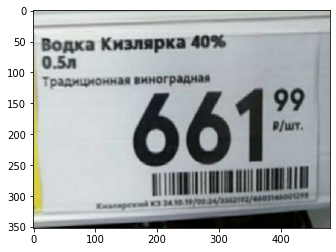

found segment: iBasePrice


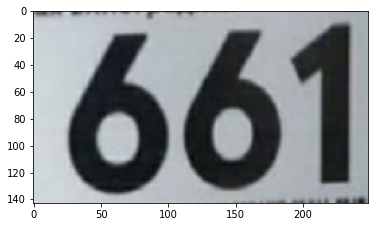

found segment: fBasePrice


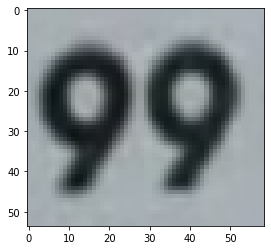

found segment: Name


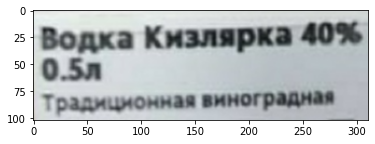

found segment: BarCode


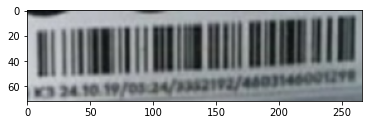

2b138cb31784eae8ac621d50bf86f82d.jpg


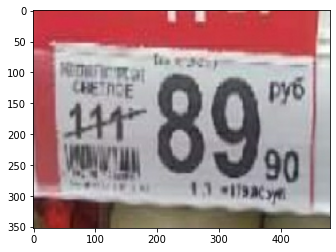

found segment: iBasePrice


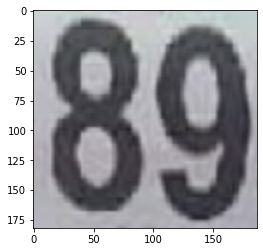

found segment: fBasePrice


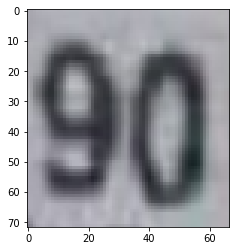

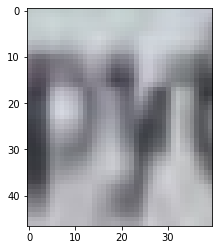

found segment: iOldPrice


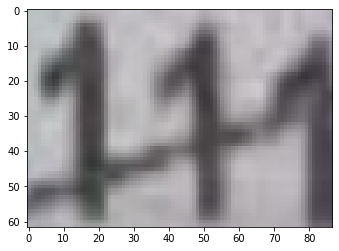

37b924d2c284e08420d4cc12b3f60719.jpg


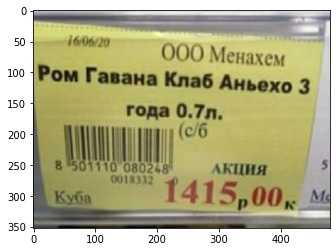

found segment: iBasePrice


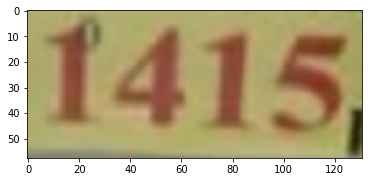

found segment: fBasePrice


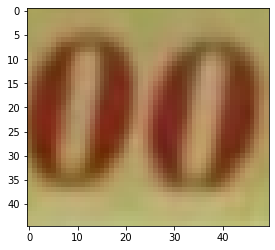

found segment: Name


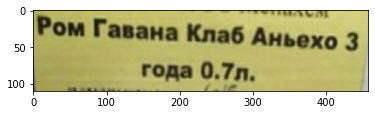

found segment: BarCode


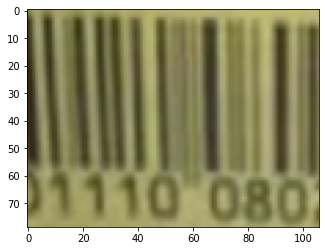

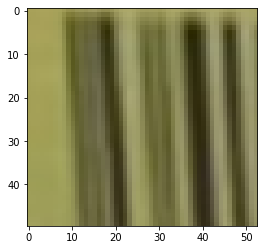

found segment: Vendor


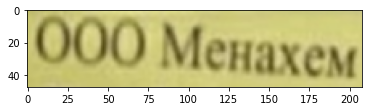

e1623a89bc9661c461c25ac29eff1c1c.jpg


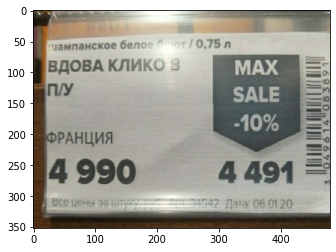

found segment: iBasePrice


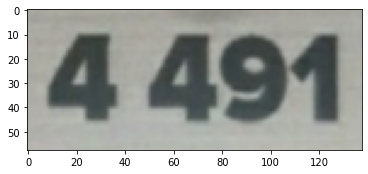

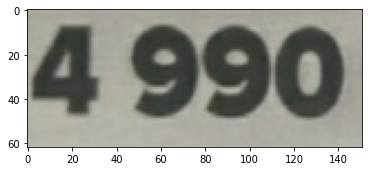

found segment: Name


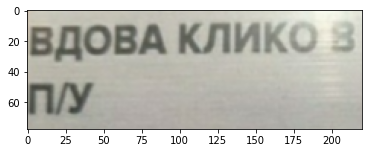

found segment: Country


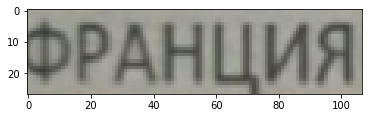

b2abed21c2e23382b52130637eb40e64.jpg


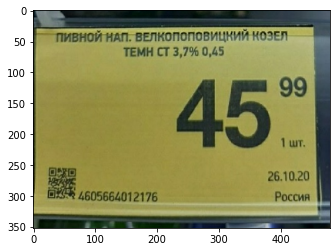

found segment: iBasePrice


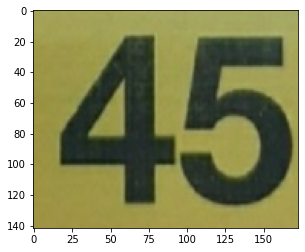

found segment: fBasePrice


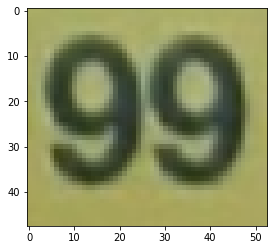

found segment: Name


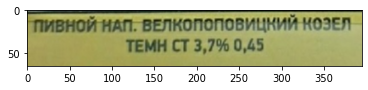

found segment: SKU


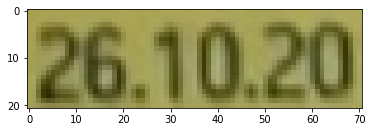

found segment: QR


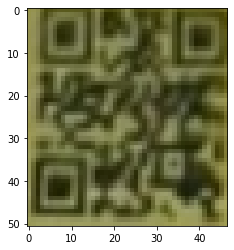

1945df6352567677bbe129bae10d8d8e.jpg


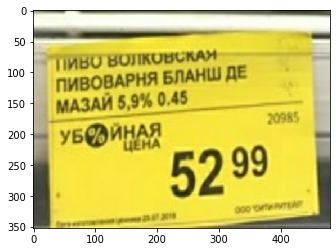

found segment: iBasePrice


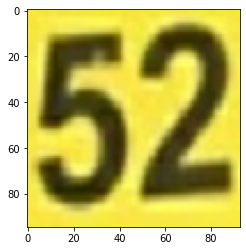

found segment: fBasePrice


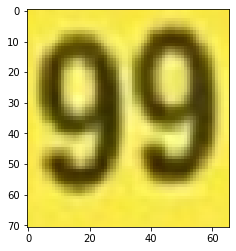

found segment: Name


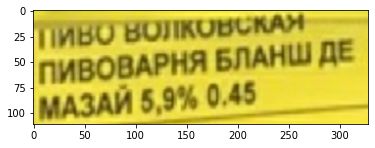

b012c4ab7d09ee75f9b8d710fe9a265e.jpg


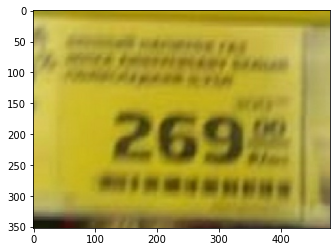

found segment: iBasePrice


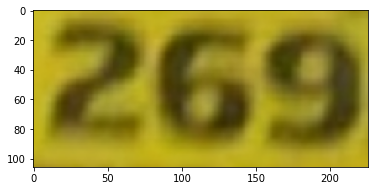

574f1846e3a955ecbe99a4a6812ddf44.jpg


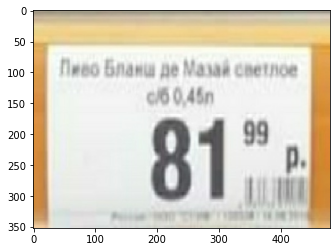

found segment: iBasePrice


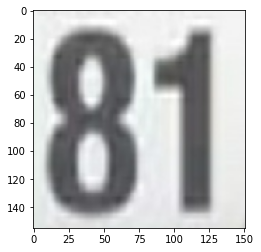

found segment: fBasePrice


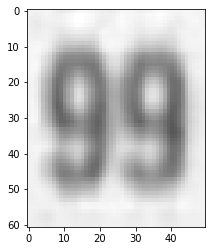

found segment: Name


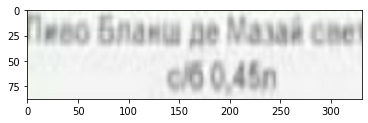

e80682c2a6e4cfbdb026584c653f091f.jpg


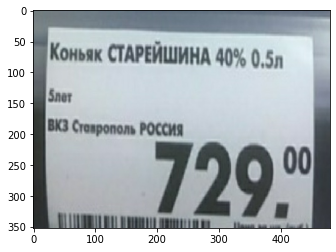

found segment: iBasePrice


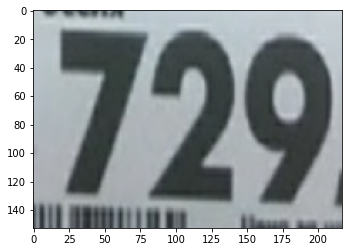

found segment: fBasePrice


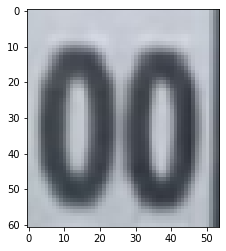

found segment: Name


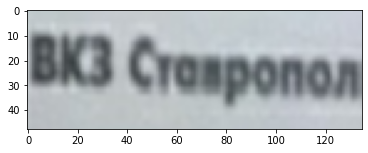

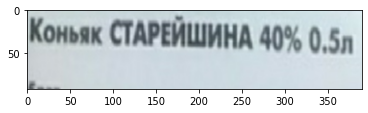

found segment: BarCode


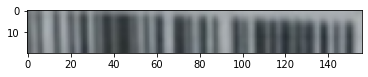

1b6199dcea9c5f82db87206321e3350d.jpg


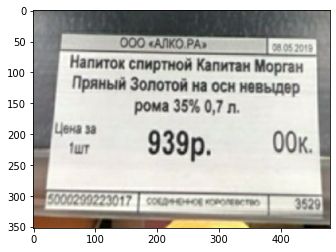

found segment: iBasePrice


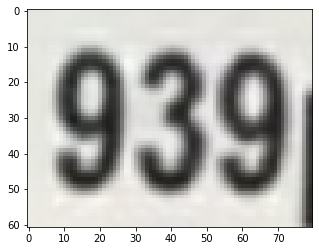

found segment: fBasePrice


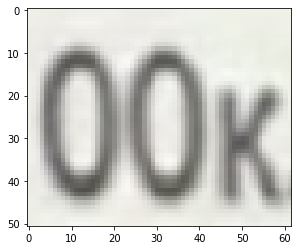

found segment: Name


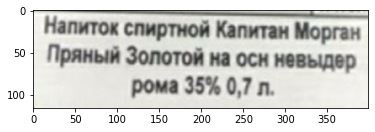

found segment: Vendor


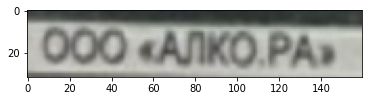

9756be0b59a7eb98457a29515c3ee2ed_0.jpg


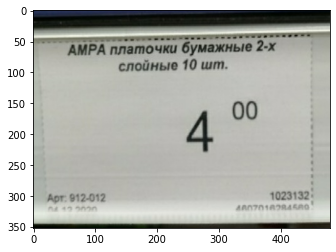

found segment: iBasePrice


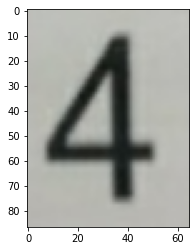

found segment: fBasePrice


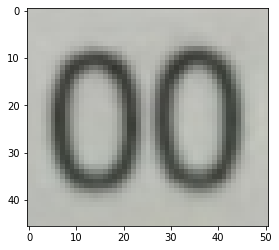

found segment: Name


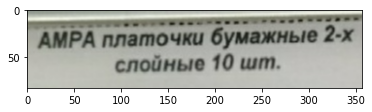

f8f73909ca3b552c30c4a81698ae3124.jpg


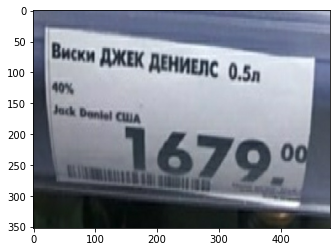

found segment: iBasePrice


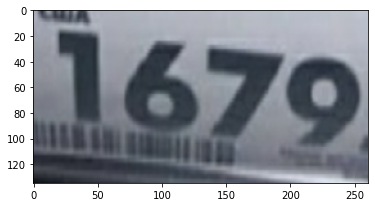

found segment: fBasePrice


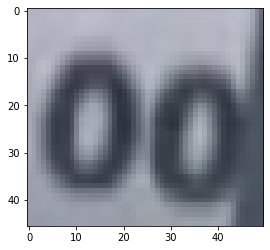

found segment: Name


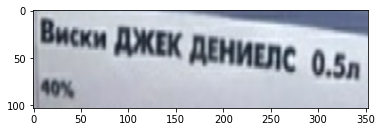

48a8966af2f09ea7845b7debb118a2ac_0.jpg


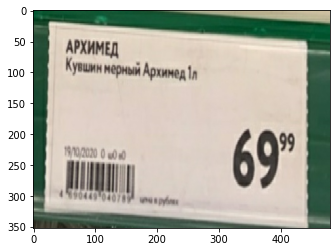

found segment: iBasePrice


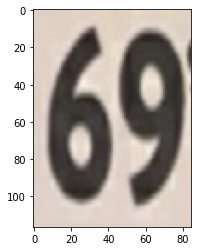

found segment: fBasePrice


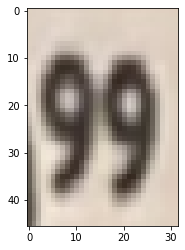

found segment: Name


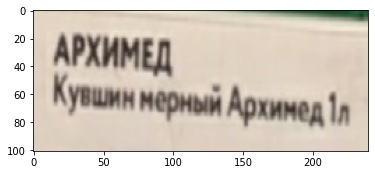

found segment: BarCode


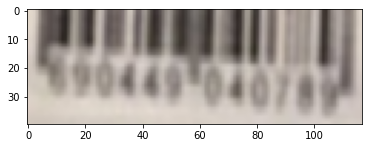

c119e92f9fbb30c60224c753fe6195aa.jpg


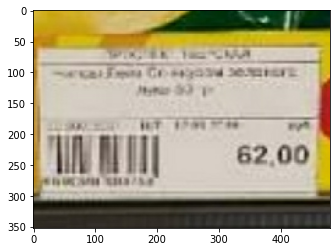

found segment: iBasePrice


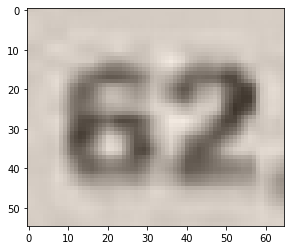

found segment: fBasePrice


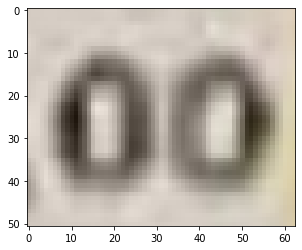

found segment: Name


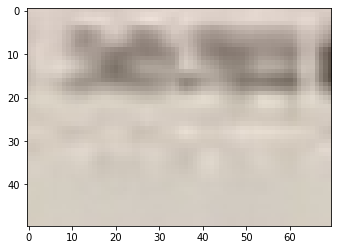

25236c78d7f89ff28b33bda61e678f70.jpg


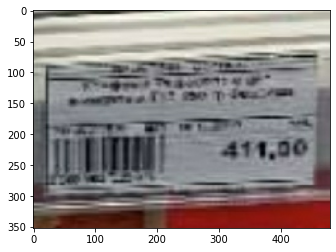

found segment: iBasePrice


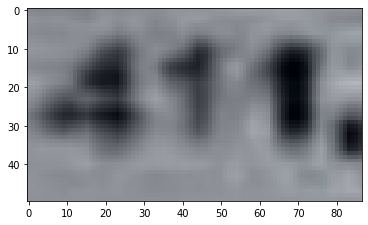

found segment: fBasePrice


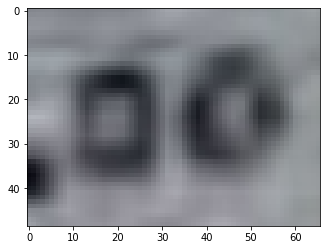

found segment: BarCode


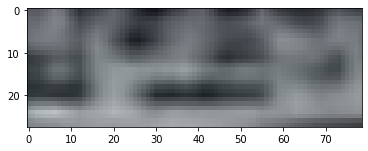

d9032bc6bf0973fd4a4cd649d84d9c7e.jpg


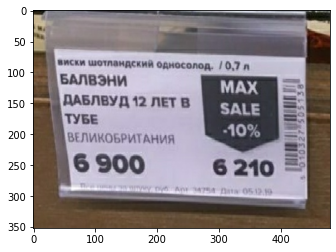

found segment: iBasePrice


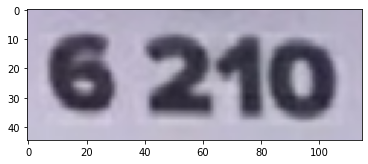

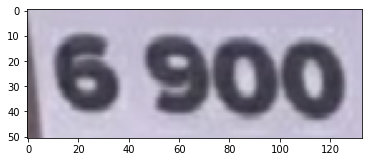

found segment: Name


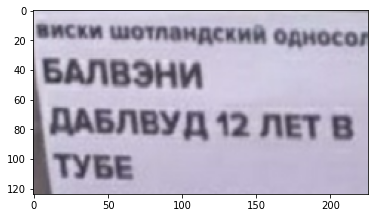

found segment: Country


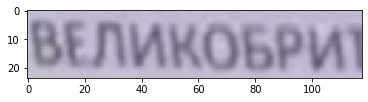

found segment: Promo


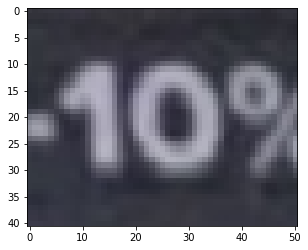

fb5fc4e4f9bacfe389128e8c22e60e16.jpg


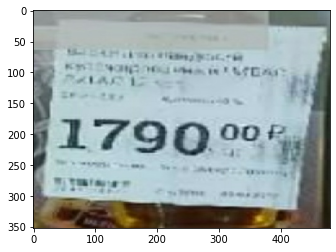

found segment: iBasePrice


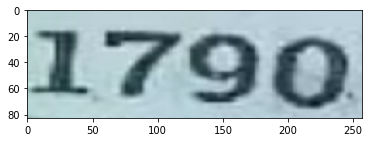

found segment: fBasePrice


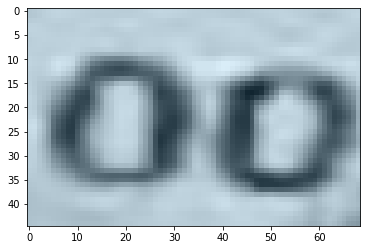

d7925f03662fa523ebf40846e1629b35.jpg


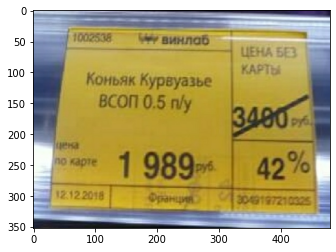

found segment: iBasePrice


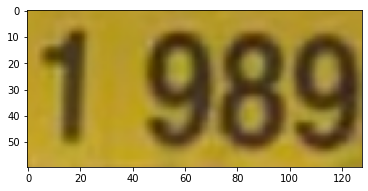

found segment: fBasePrice


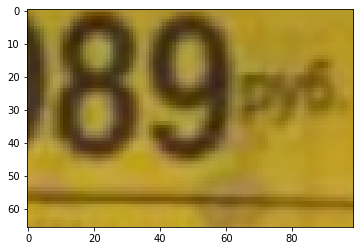

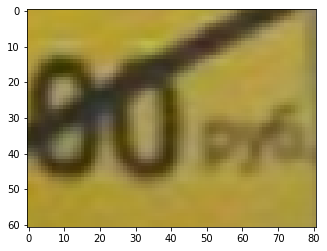

found segment: iOldPrice


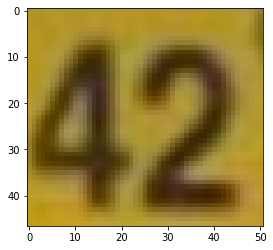

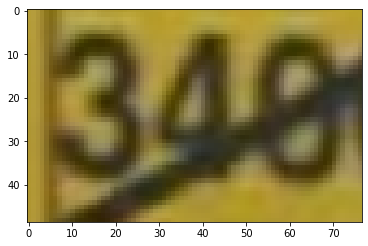

found segment: fOldPrice


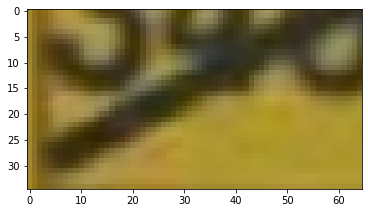

found segment: Name


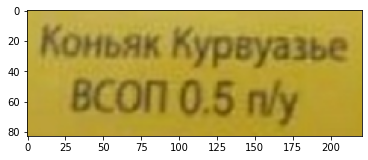

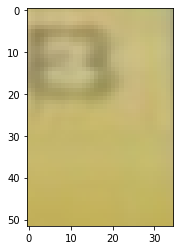

found segment: Promo


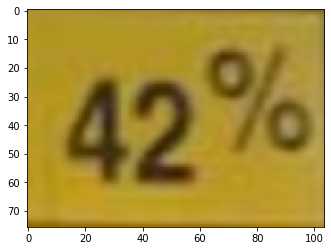

e83430a36b61563938274897162a0aec.jpg


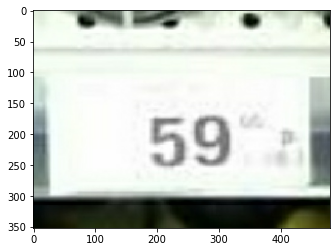

found segment: iBasePrice


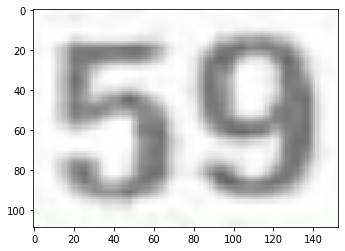

d8285e5a5cf217d180ff0ec5a265f55e.jpg


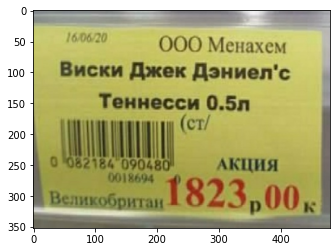

found segment: iBasePrice


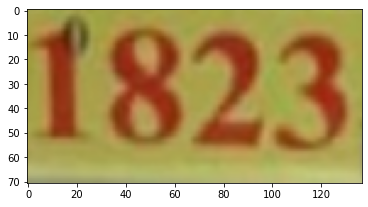

found segment: fBasePrice


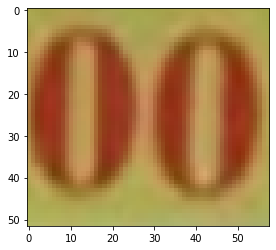

found segment: Name


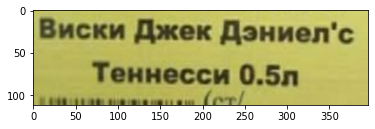

found segment: BarCode


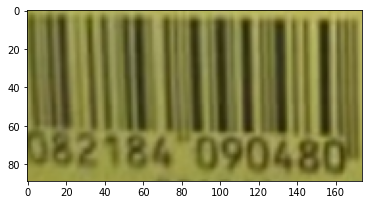

found segment: Vendor


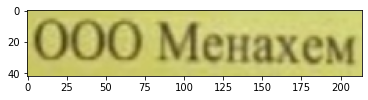

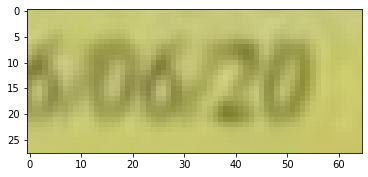

found segment: Country


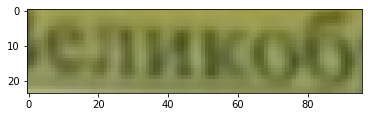

5161eca12642d477ff8efb855206cab3.jpg


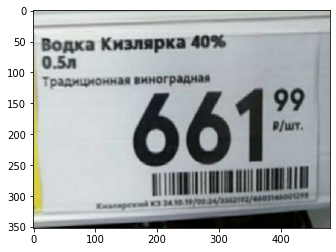

found segment: iBasePrice


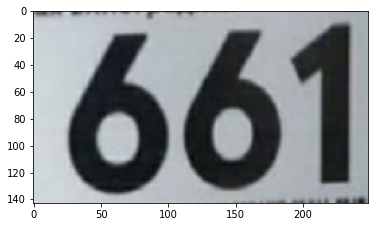

found segment: fBasePrice


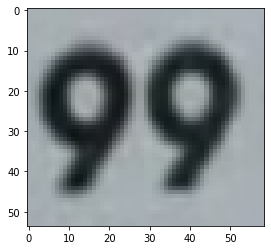

found segment: Name


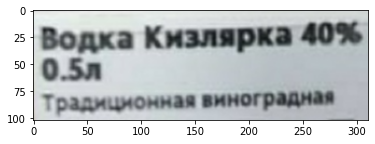

found segment: BarCode


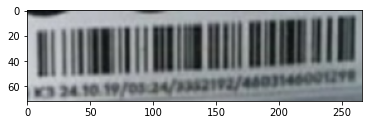

58d631758ac6f0fdc6f7919c7cb5515b.jpg


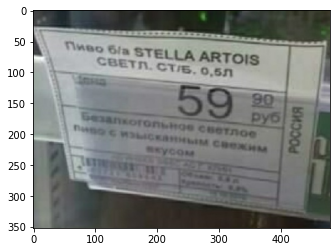

found segment: iBasePrice


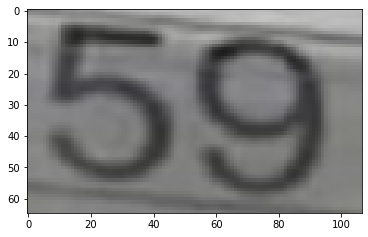

found segment: fBasePrice


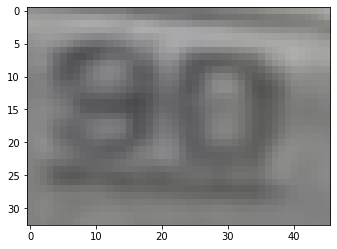

found segment: Name


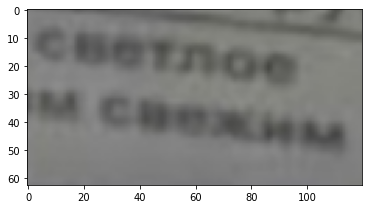

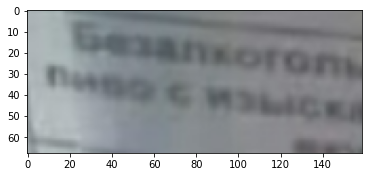

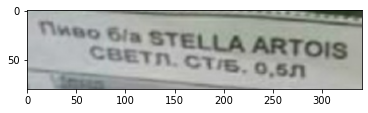

found segment: Country


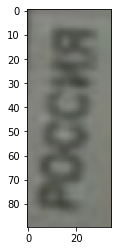

4933b038e5439c9feaf2d99f8d6b90b3.jpg


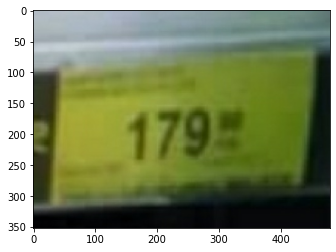

found segment: iBasePrice


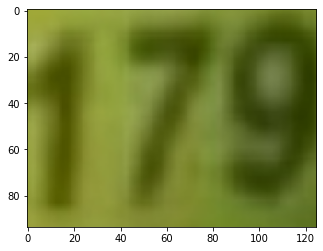

43bf90389be6a58e6097c9c77d4158e9.jpg


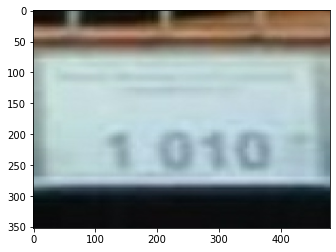

233fb5e1ff20ba461c51164eed13301b.jpg


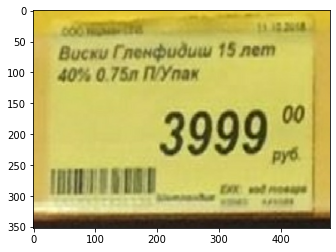

found segment: iBasePrice


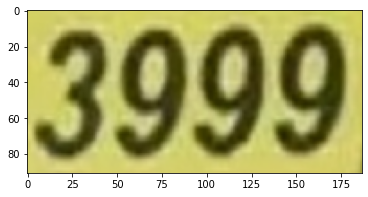

found segment: fBasePrice


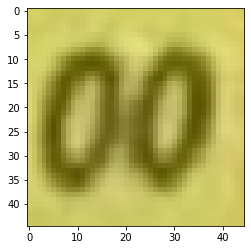

found segment: Name


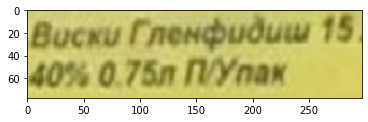

bc39b8c283a5c818d3fb4089a2942ea9.jpg


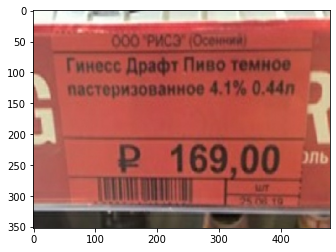

found segment: iBasePrice


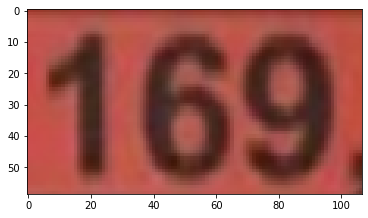

found segment: fBasePrice


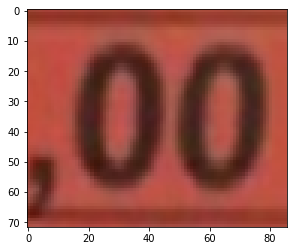

found segment: Name


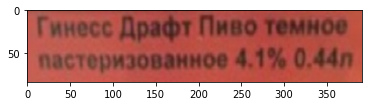

found segment: BarCode


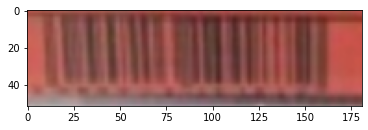

found segment: Vendor


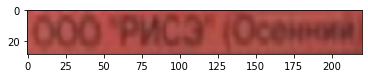

322dba86e74e6793cc7899c5a65a1dfa.jpg


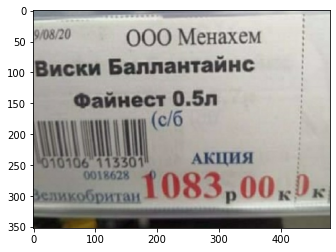

found segment: iBasePrice


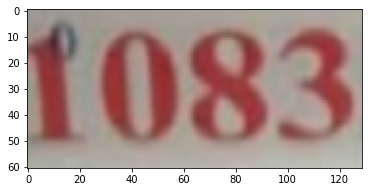

found segment: fBasePrice


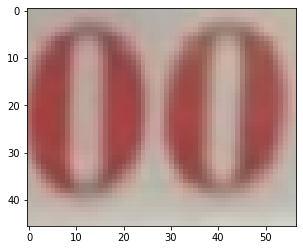

found segment: iPromoPrice


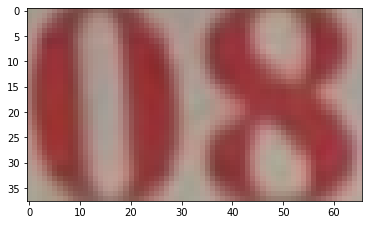

found segment: Name


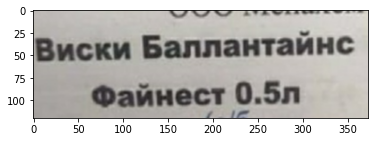

found segment: BarCode


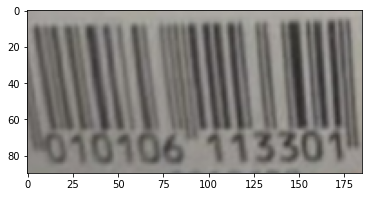

found segment: Vendor


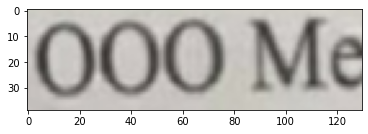

found segment: SKU


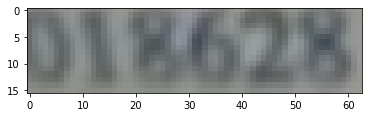

found segment: Country


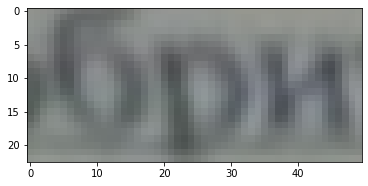

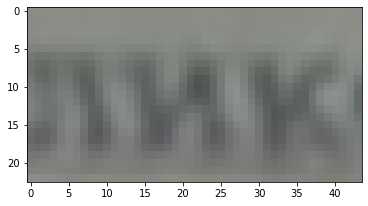

45f0888b32e5144c5e1b88a9104ff4d9.jpg


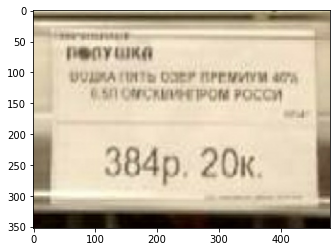

found segment: iBasePrice


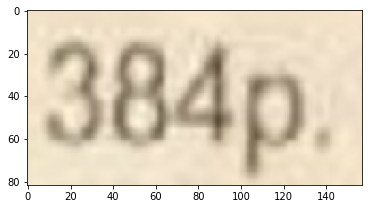

found segment: fBasePrice


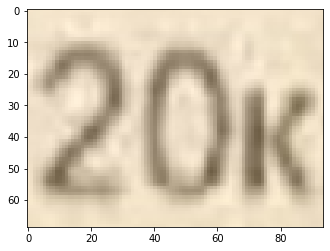

found segment: Name


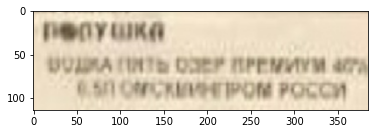

ca6d84a9728e5a67b9e20df466847c54.jpg


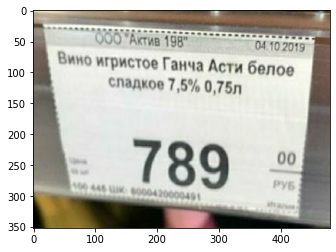

found segment: iBasePrice


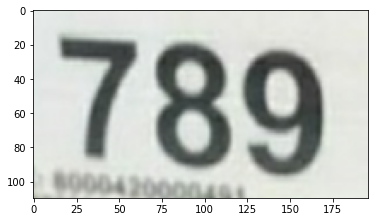

found segment: fBasePrice


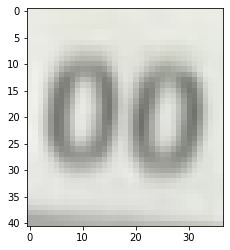

found segment: Name


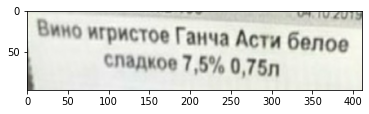

found segment: Vendor


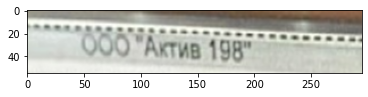

b1bcb5e0182877f543cc784c7b4b5bba.jpg


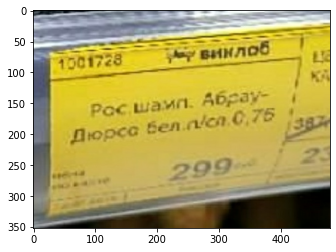

found segment: Name


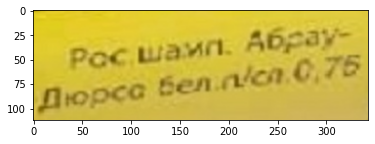

fe9ec2661726b03b7f8e42c835cde4ce.jpg


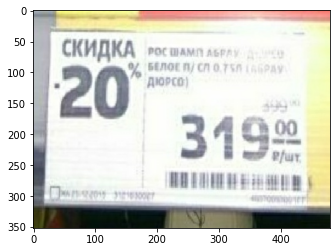

found segment: iBasePrice


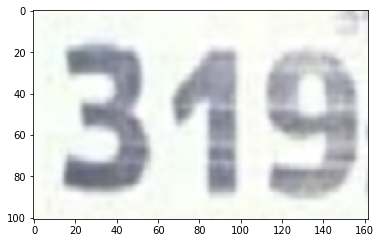

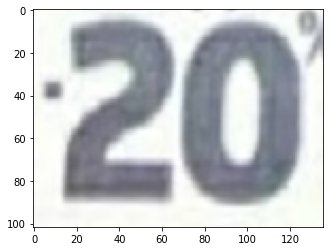

found segment: fBasePrice


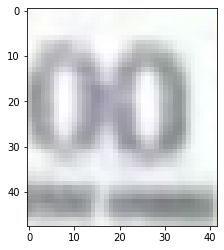

found segment: Name


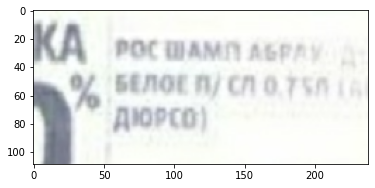

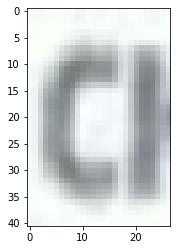

found segment: BarCode


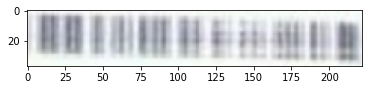

c3c3e8a3853bd12db0209b880f08e4ee.jpg


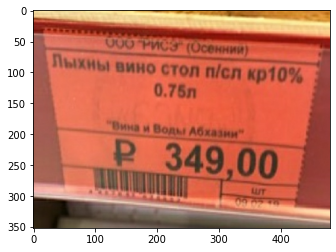

found segment: iBasePrice


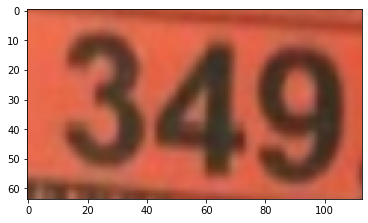

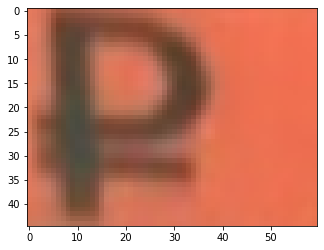

found segment: fBasePrice


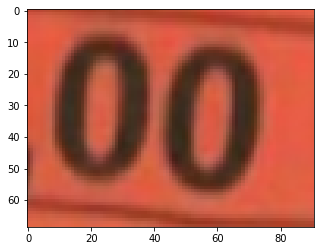

found segment: Name


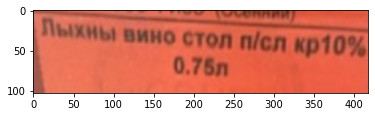

found segment: BarCode


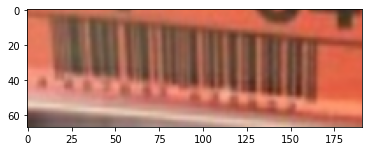

found segment: Vendor


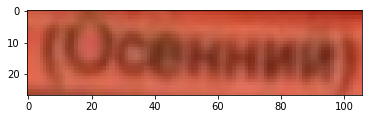

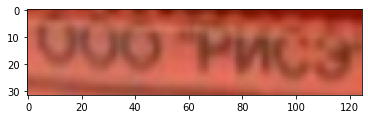

cd2d9fe558f1cce13bfdc0f5bed9b43d.jpg


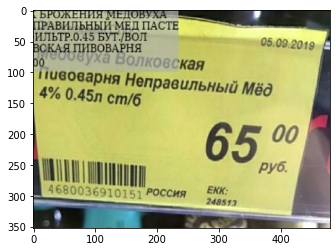

found segment: iBasePrice


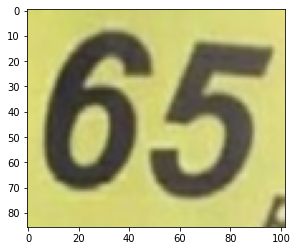

found segment: fBasePrice


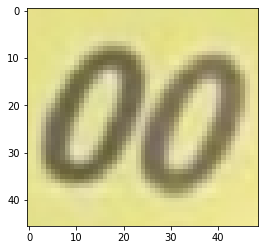

found segment: Name


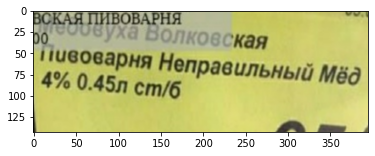

found segment: BarCode


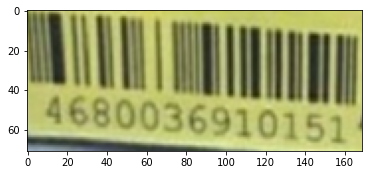

15da88bc3be1b15b8d87d1ba88a478db.jpg


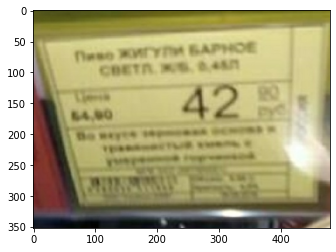

found segment: iBasePrice


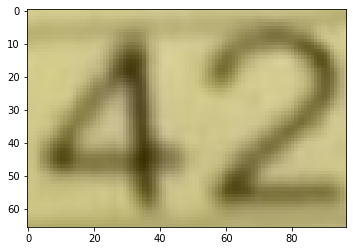

f04c860704b2bdaaf1143e5b5f406c5a.jpg


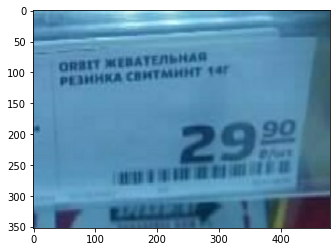

found segment: Name


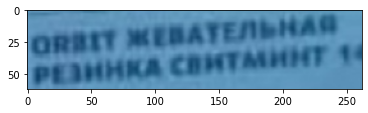

11f56adbd2b96caa6e76b1f0ce7b97fb.jpg


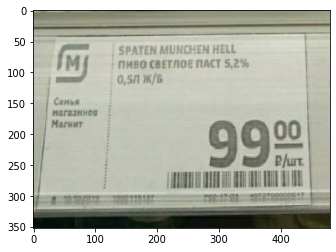

found segment: iBasePrice


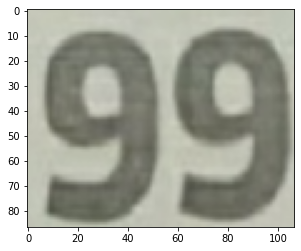

found segment: fBasePrice


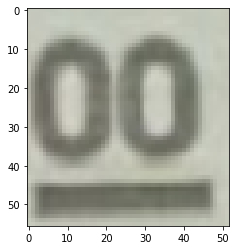

found segment: Name


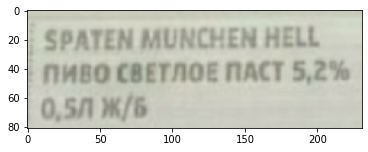

found segment: BarCode


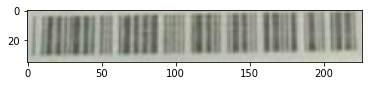

e5dcc55c3f84a3b942b60fd0398886e1.jpg


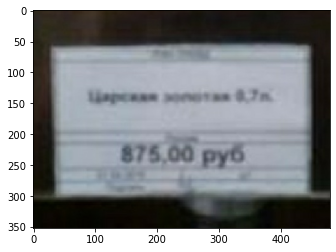

found segment: iBasePrice


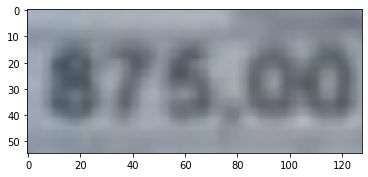

found segment: fBasePrice


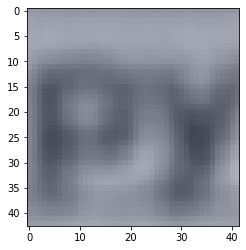

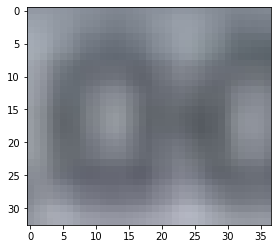

b06e821ce4d55701d794a3b255565163_0.jpg


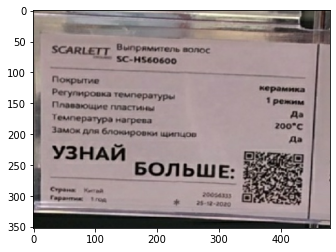

found segment: iBasePrice


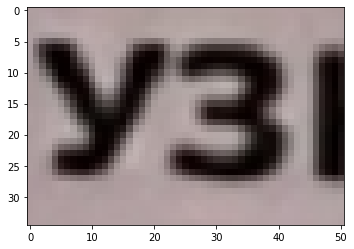

found segment: fBasePrice


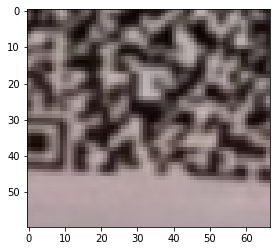

found segment: Name


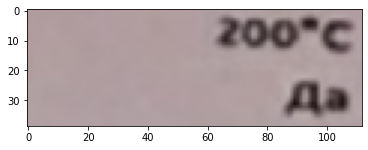

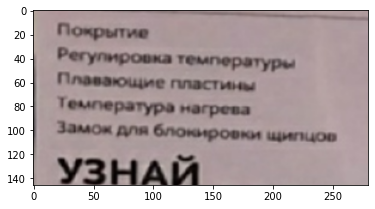

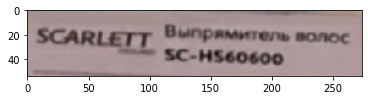

found segment: Description


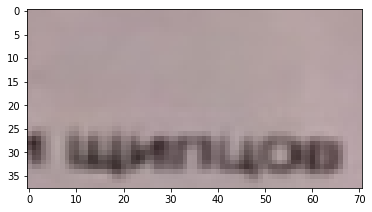

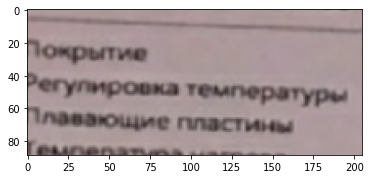

found segment: QR


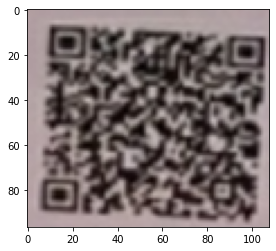

3f47cc01add9290497d4d9c9eeb2fea6.jpg


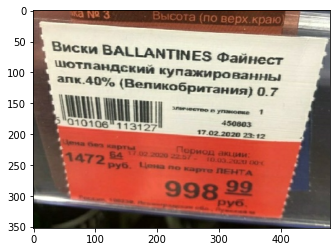

found segment: iBasePrice


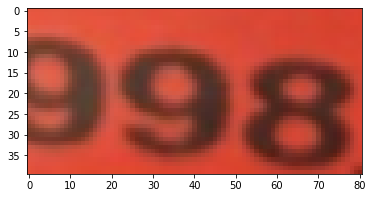

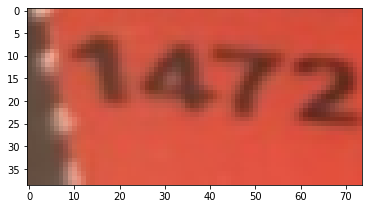

found segment: fBasePrice


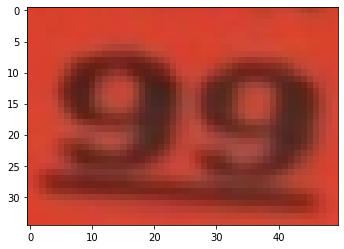

found segment: iPromoPrice


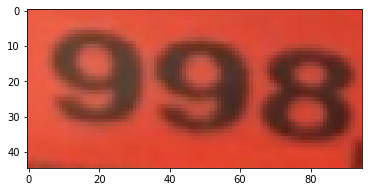

found segment: Name


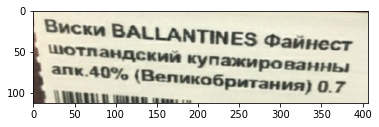

found segment: BarCode


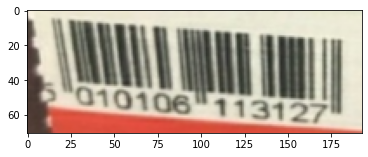

f5dd1f40a5be60afef7cfef2e4d5005e.jpg


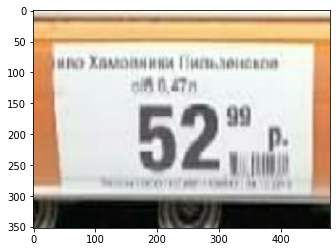

found segment: iBasePrice


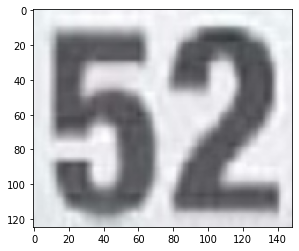

found segment: fBasePrice


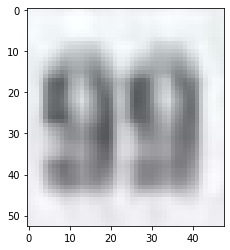

found segment: Name


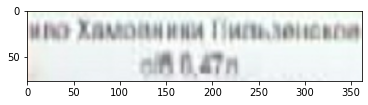

376d0f5024804479738ed8904d1e5a24_0.jpg


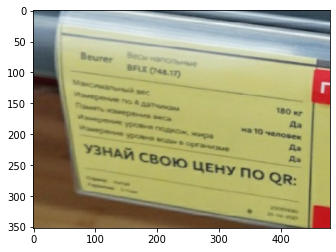

found segment: Name


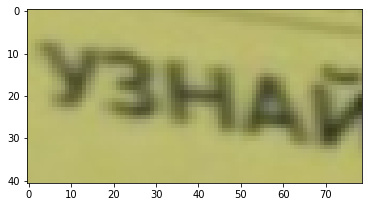

4199c682acd4536d0b287ee179973581.jpg


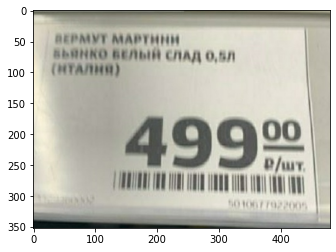

found segment: iBasePrice


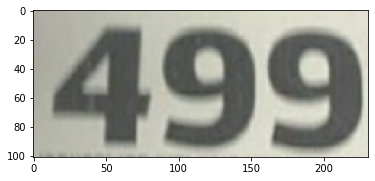

found segment: fBasePrice


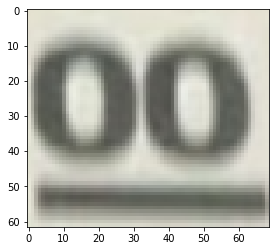

found segment: Name


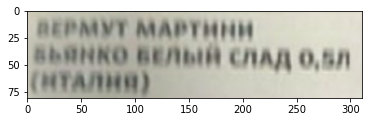

08117b9cc6e938be893148f8d948a54a.jpg


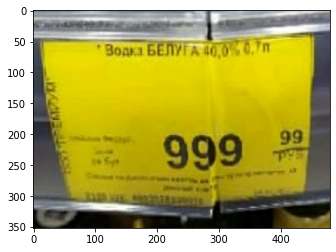

found segment: iBasePrice


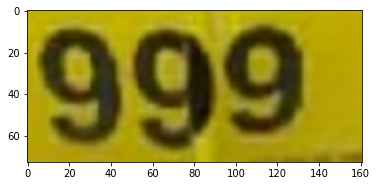

found segment: fBasePrice


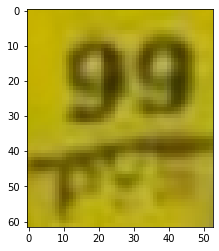

found segment: Name


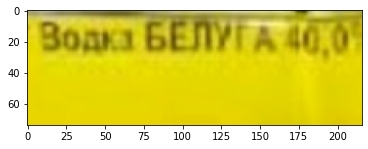

020170e11ce2039018968edb4fdbf142_0.jpg


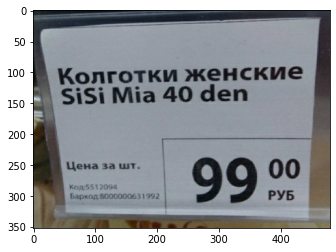

found segment: iBasePrice


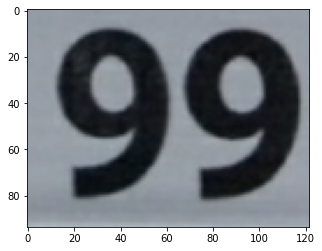

found segment: fBasePrice


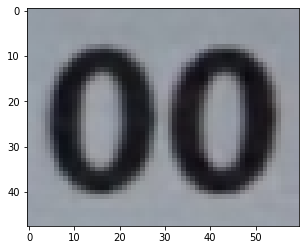

found segment: Name


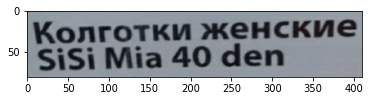

0199155bbc79ca2b154421f896fb1f10.jpg


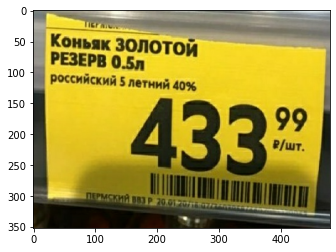

found segment: iBasePrice


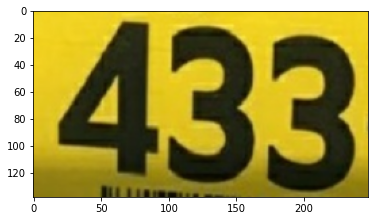

found segment: fBasePrice


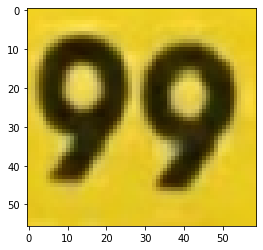

found segment: Name


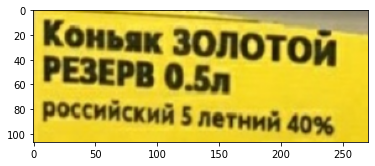

found segment: BarCode


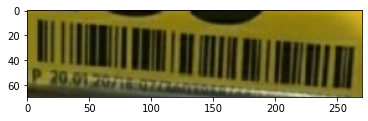

d9d18a8da5e3c3d0ca76e44d8f76ce87.jpg


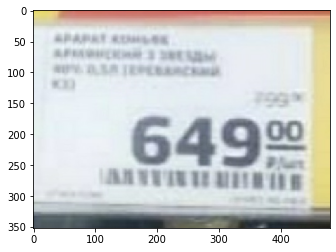

found segment: iBasePrice


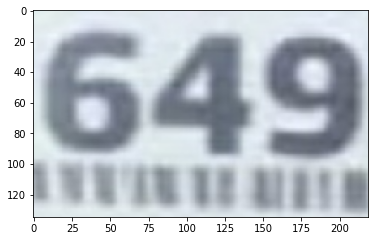

found segment: fBasePrice


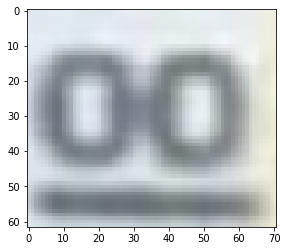

be545793d036a9d8074b1ea5dfa2eb12_0.jpg


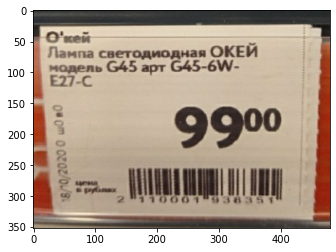

found segment: iBasePrice


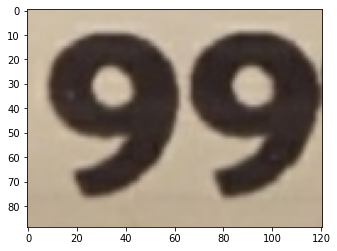

found segment: fBasePrice


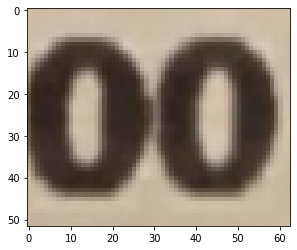

found segment: Name


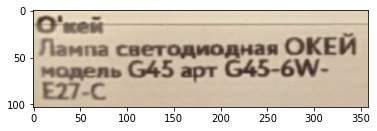

found segment: BarCode


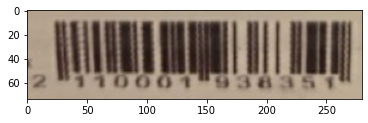

found segment: Promo


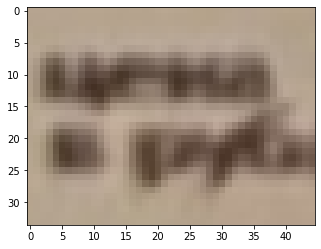

ed579a46237620930e4067bab5cd8c08.jpg


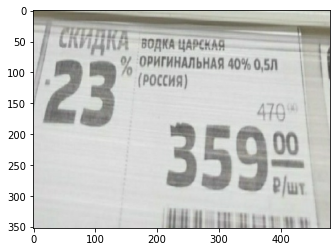

found segment: iBasePrice


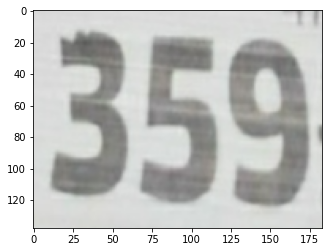

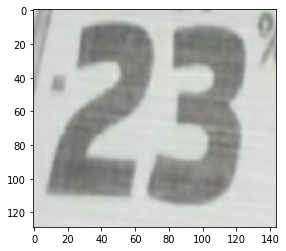

found segment: fBasePrice


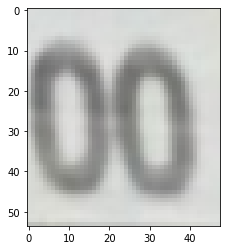

found segment: Name


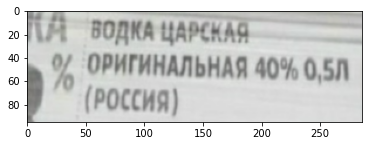

be6a92a41b989ecf2ba9f8212972f2d0.jpg


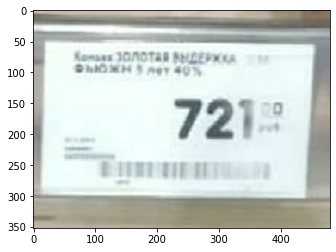

found segment: iBasePrice


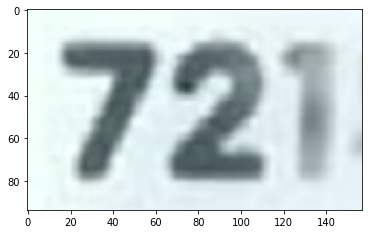

found segment: fBasePrice


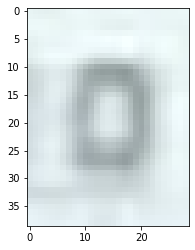

found segment: Name


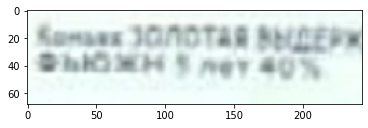

f8f73909ca3b552c30c4a81698ae3124.jpg


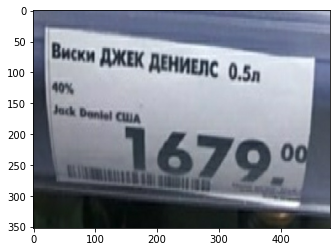

found segment: iBasePrice


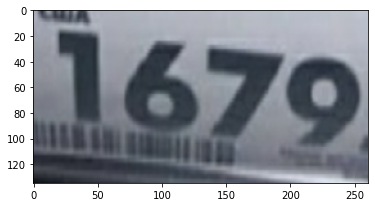

found segment: fBasePrice


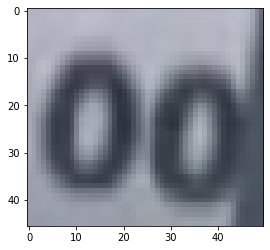

found segment: Name


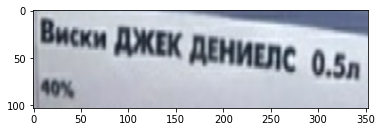

1bb9272c0c7f78b6d38459d502b386e3.jpg


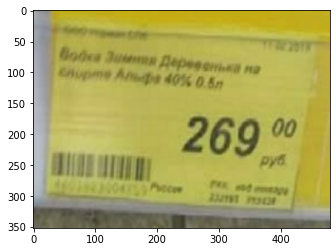

found segment: iBasePrice


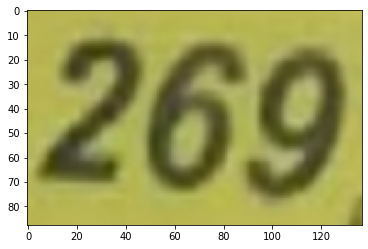

found segment: fBasePrice


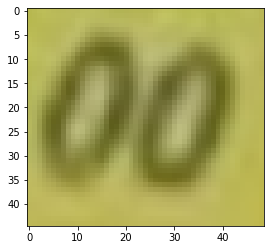

found segment: Name


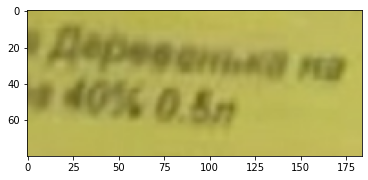

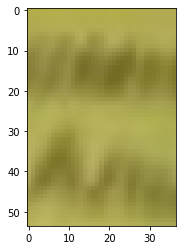

174916cc98e78876d16f178dc4a8e1e1.jpg


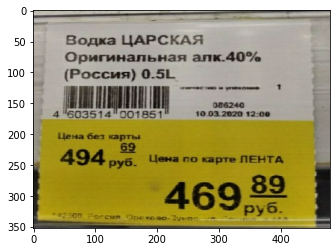

found segment: iBasePrice


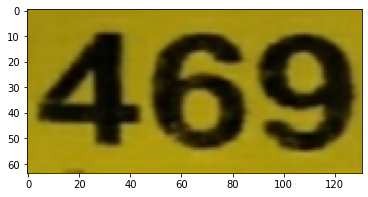

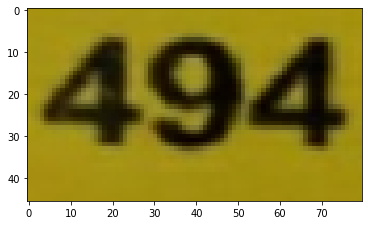

found segment: fBasePrice


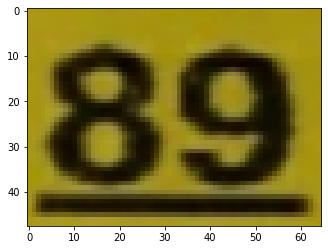

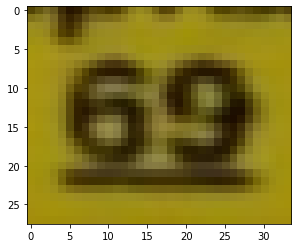

found segment: Name


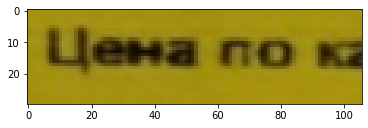

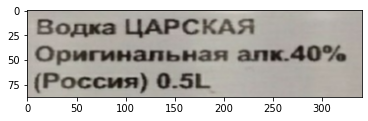

found segment: BarCode


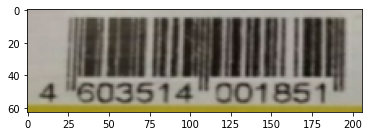

488a461e8c035a0e6d9cc8b2d9ee3526_0.jpg


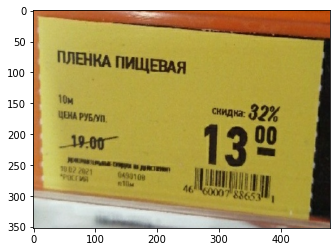

found segment: iBasePrice


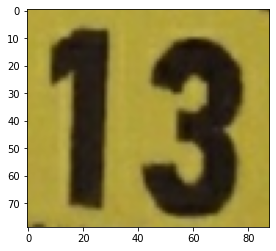

found segment: fBasePrice


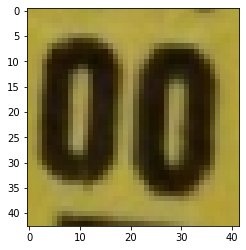

found segment: iOldPrice


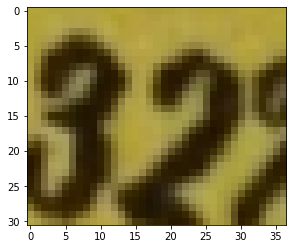

found segment: Name


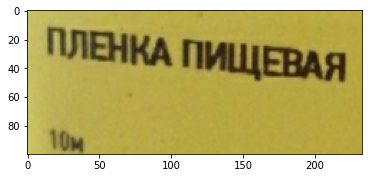

found segment: BarCode


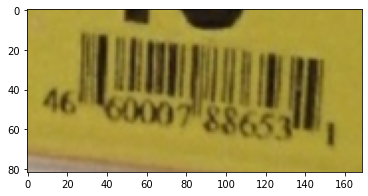

fb86f738b13736d64742fb222fcbfae3.jpg


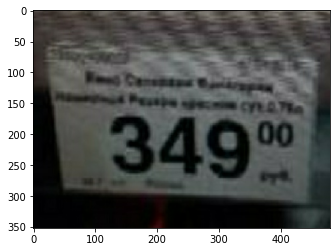

found segment: iBasePrice


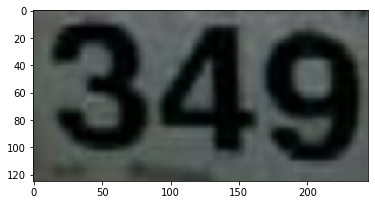

found segment: fBasePrice


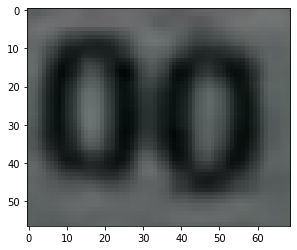

found segment: Name


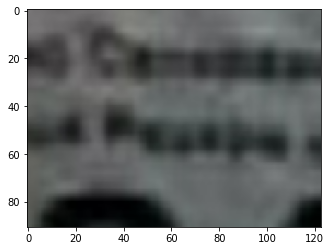

158e238d68b27258d9a2201b7c003173.jpg


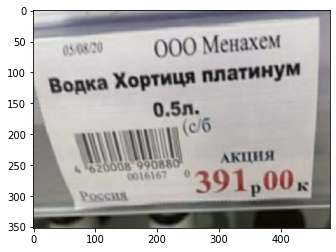

found segment: iBasePrice


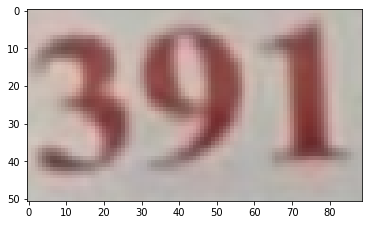

found segment: fBasePrice


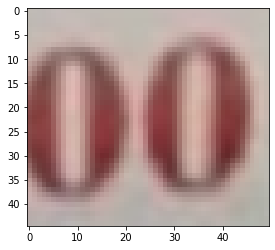

found segment: iPromoPrice


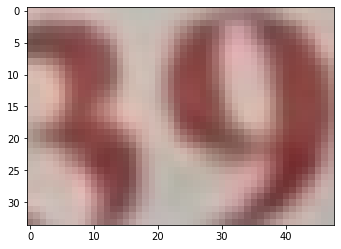

found segment: Name


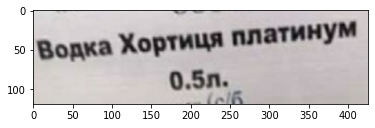

found segment: BarCode


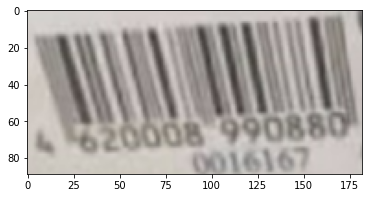

found segment: Vendor


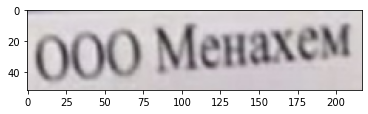

133bdd12369092d71f1218c4a93102e3.jpg


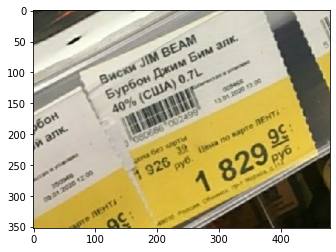

found segment: fBasePrice


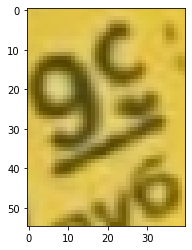

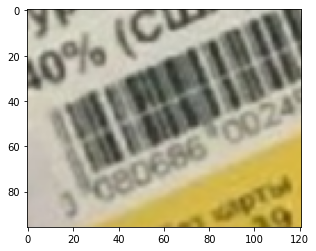

found segment: iOldPrice


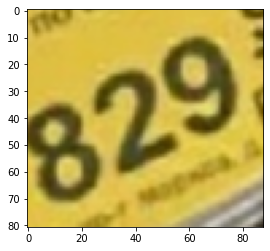

found segment: Name


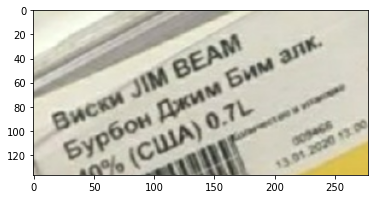

found segment: Promo


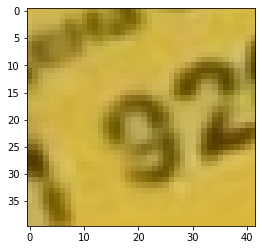

3699f3a641d731df5ab848e5eb4291b4.jpg


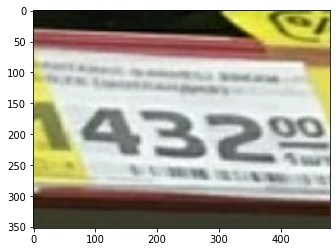

found segment: iBasePrice


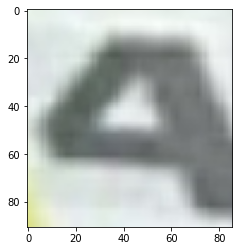

5f1a743ad51b885a4e8d6dcd668c4efa_0.jpg


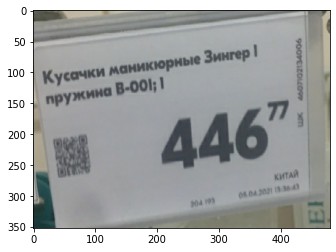

found segment: iBasePrice


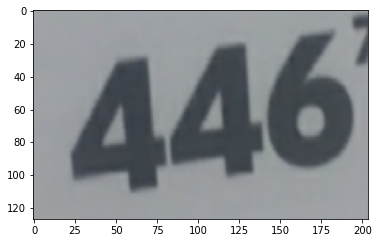

found segment: fBasePrice


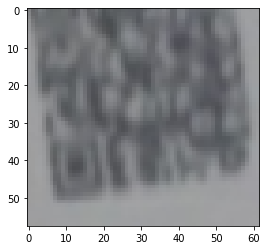

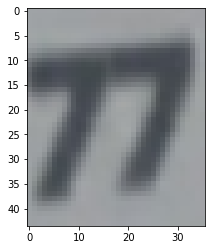

found segment: Name


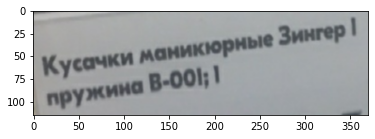

e1ba744a19e0267159f2a83e04d81407.jpg


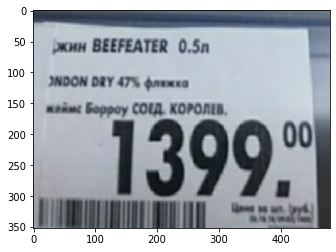

found segment: iBasePrice


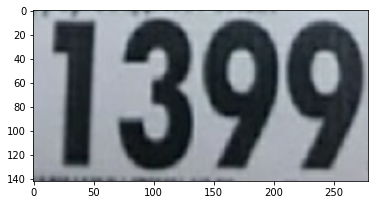

found segment: fBasePrice


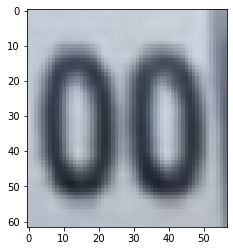

found segment: Name


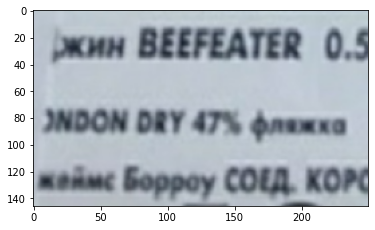

found segment: BarCode


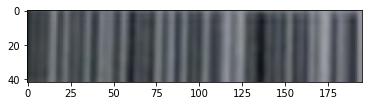

0bff6f2690926cbb5af8cdc194ee2eee_0.jpg


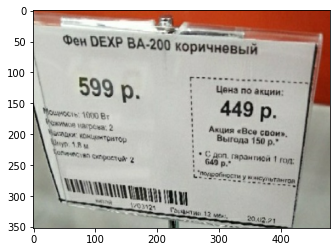

found segment: iBasePrice


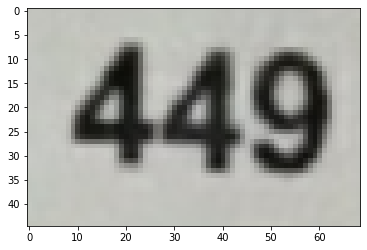

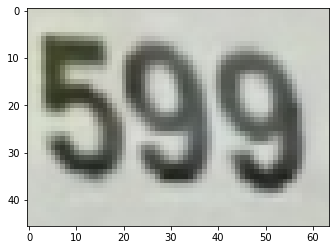

found segment: Name


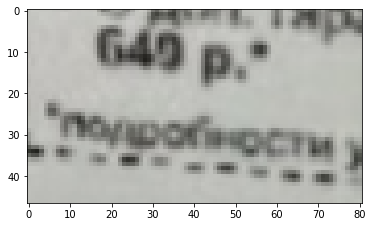

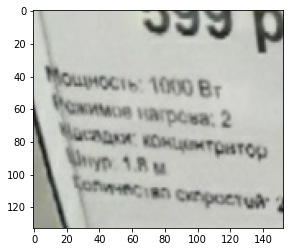

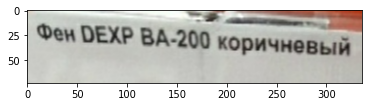

found segment: BarCode


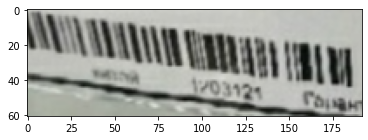

3239976a941a21260dc027e27387f62d.jpg


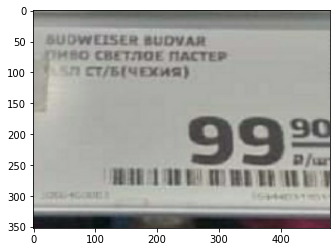

found segment: iBasePrice


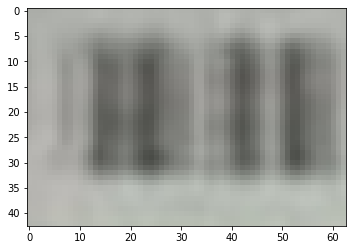

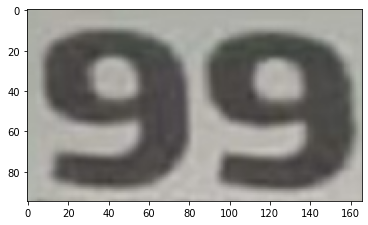

found segment: fBasePrice


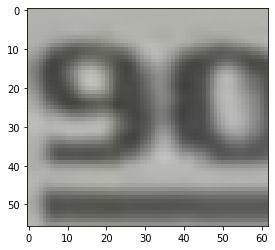

found segment: Name


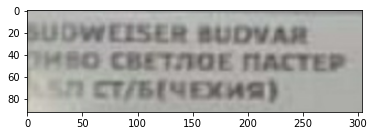

dfd3644d652f2f4c80a80617b8d53440_0.jpg


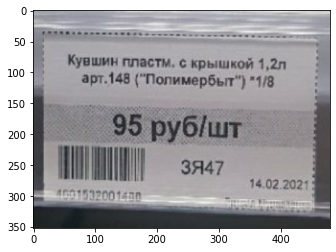

found segment: iBasePrice


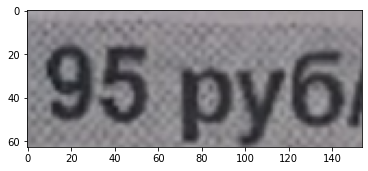

found segment: iOldPrice


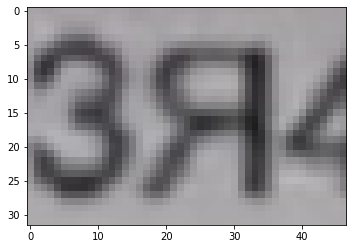

found segment: Name


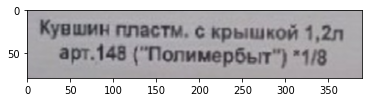

found segment: BarCode


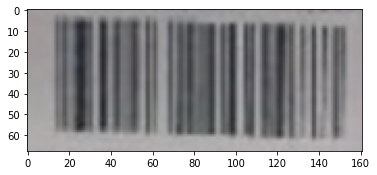

found segment: Vendor


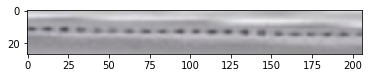

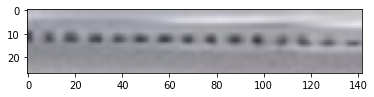

found segment: SKU


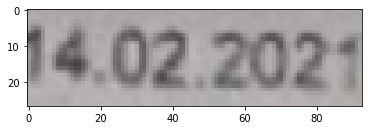

b5e6bedc6511ab4cedc6c6f303ef258a.jpg


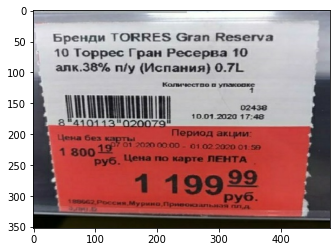

found segment: iBasePrice


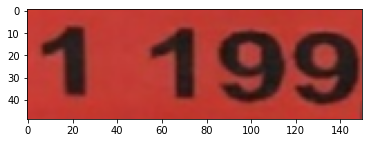

found segment: fBasePrice


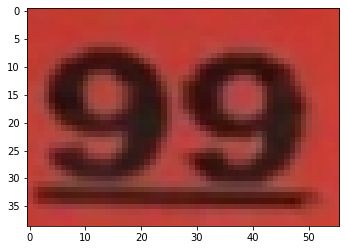

found segment: Name


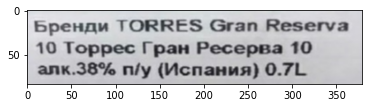

found segment: BarCode


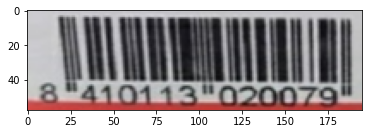

found segment: Promo


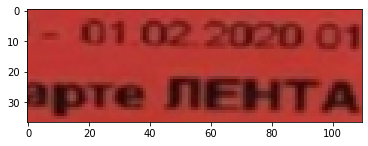

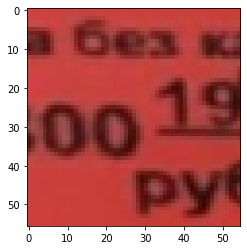

af772512986e7105eb5ccf70855c7d9b.jpg


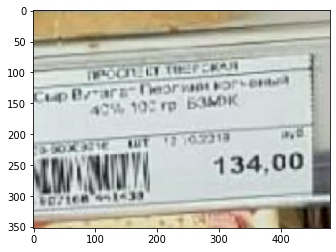

found segment: iBasePrice


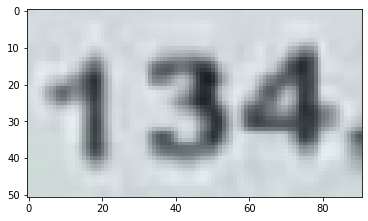

found segment: fBasePrice


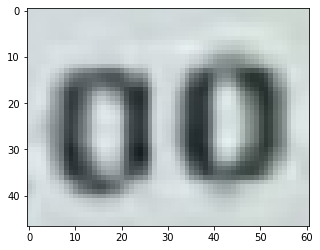

found segment: Name


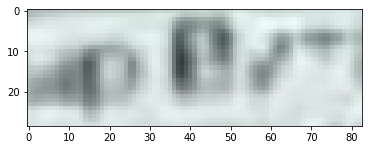

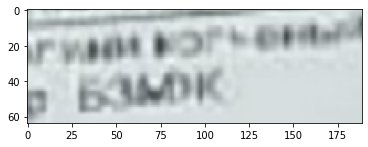

b4fe91af866d70c67a3841907cc76cee.jpg


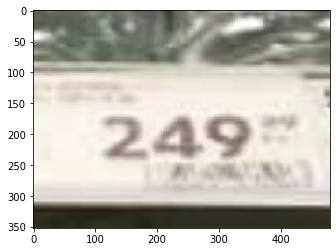

found segment: iBasePrice


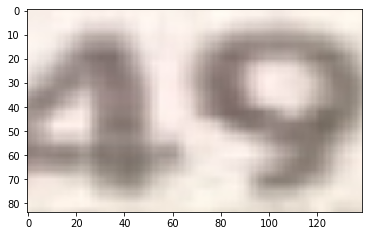

d80d4c53f8c1ae56119b38f47c64ff3a.jpg


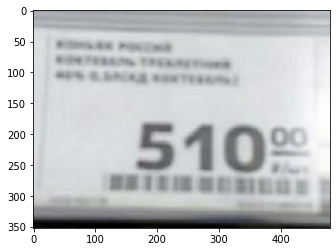

found segment: iBasePrice


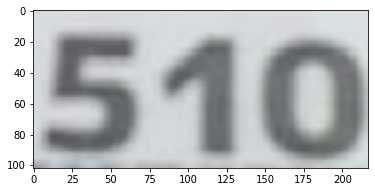

found segment: fBasePrice


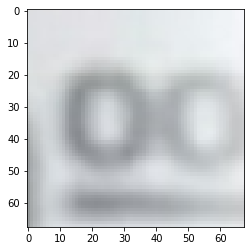

found segment: Name


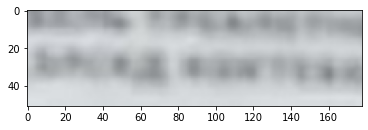

0ac81dece5a919ef43dd9716be7a7d08.jpg


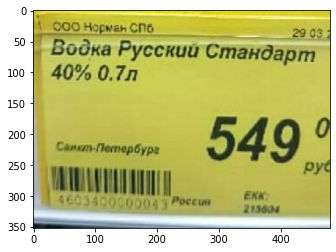

found segment: iBasePrice


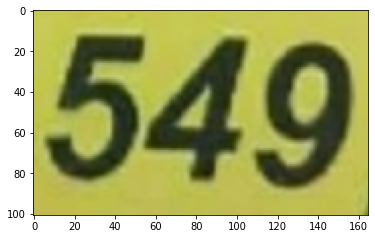

found segment: Name


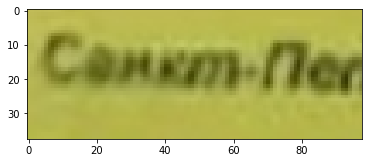

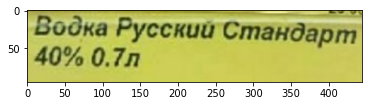

found segment: BarCode


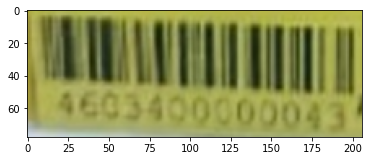

found segment: Vendor


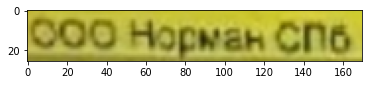

found segment: Date


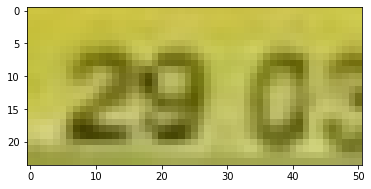

fa86a161cd64302010ea2ef7ede31aad.jpg


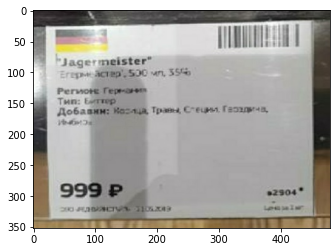

found segment: iBasePrice


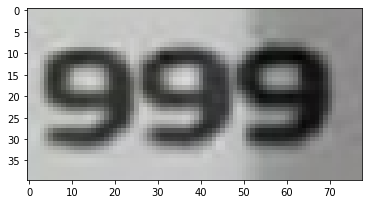

found segment: Name


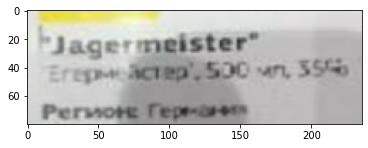

found segment: BarCode


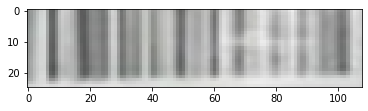

a8032a390ad1599c4190863e02d96db4_0.jpg


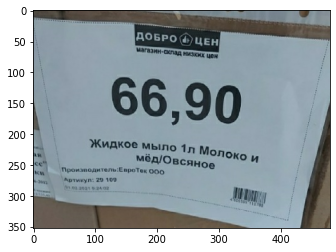

found segment: iBasePrice


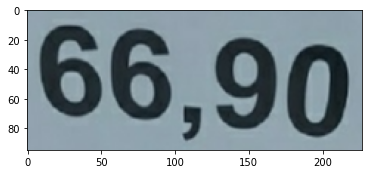

found segment: fBasePrice


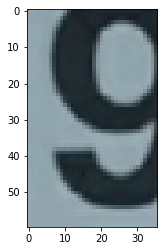

found segment: Name


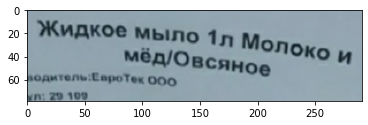

found segment: BarCode


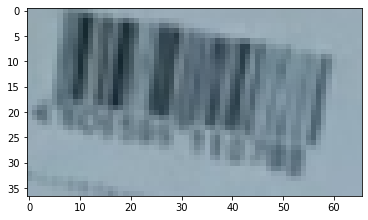

ec22443976cf0cd42f668ddcac4ad5b2_0.jpg


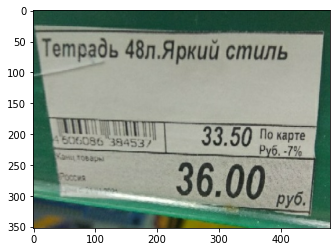

found segment: iBasePrice


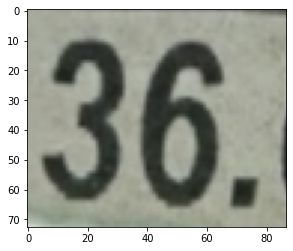

found segment: fBasePrice


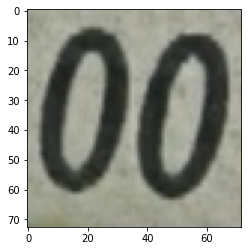

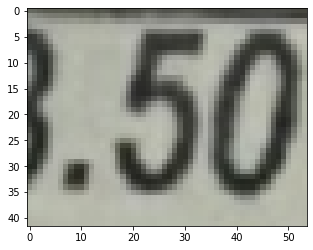

found segment: iOldPrice


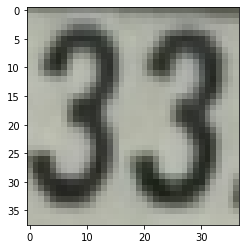

found segment: Name


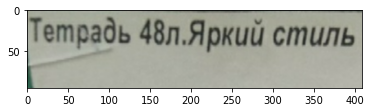

found segment: BarCode


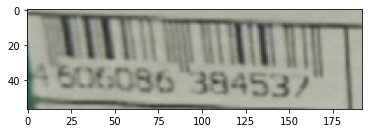

e2e35c517d926c8328629ee83c418504_0.jpg


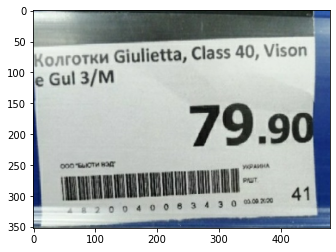

found segment: iBasePrice


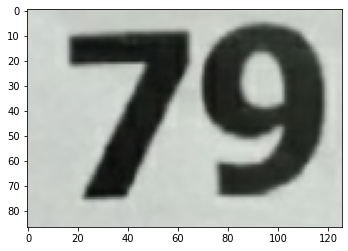

found segment: fBasePrice


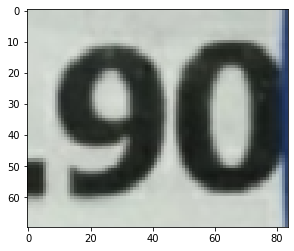

found segment: Name


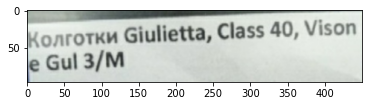

found segment: BarCode


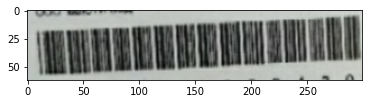

eeefe1c73a6be87b8bbf4867ecb4c143.jpg


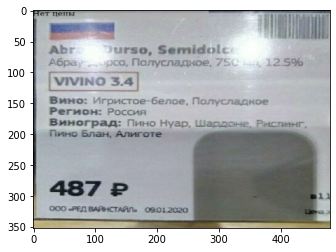

found segment: iBasePrice


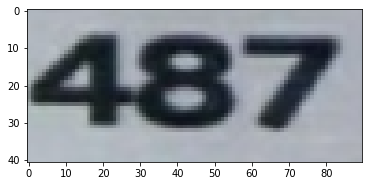

found segment: fBasePrice


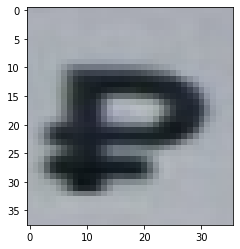

found segment: Name


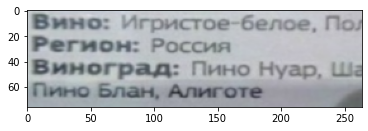

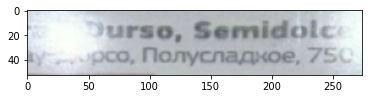

f3e9413b4a15844332bdb48de779688a.jpg


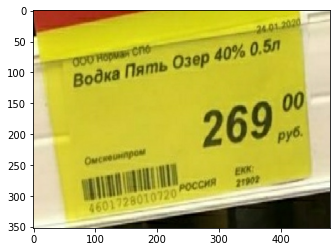

found segment: iBasePrice


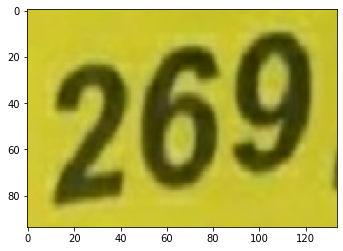

found segment: fBasePrice


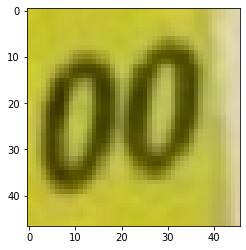

found segment: Name


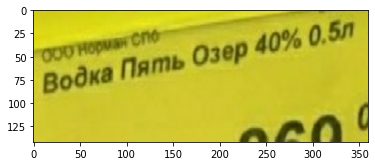

found segment: BarCode


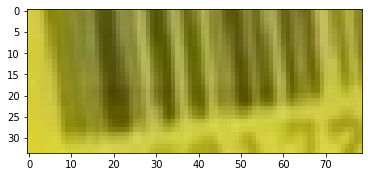

abeff229f24d99960d4be998222c709a.jpg


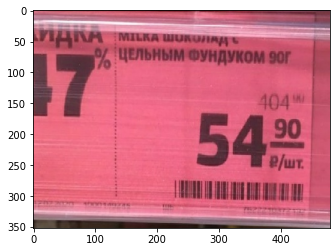

found segment: iBasePrice


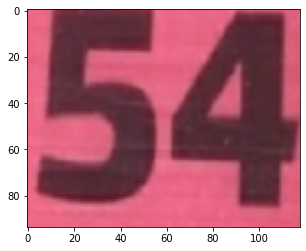

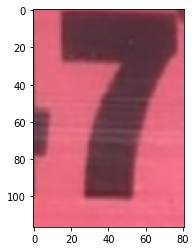

found segment: fBasePrice


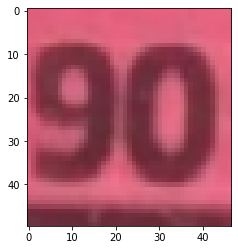

found segment: iPromoPrice


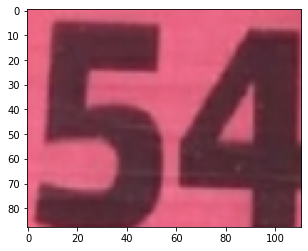

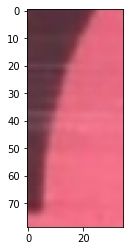

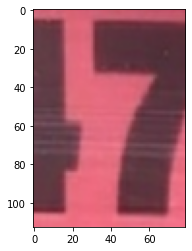

found segment: fPromoPrice


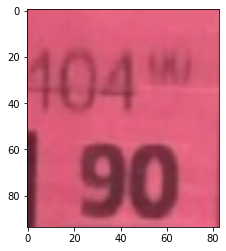

found segment: Name


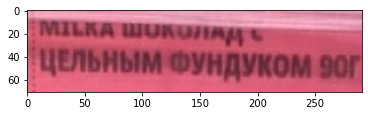

found segment: BarCode


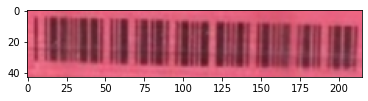

f2856460e1bf48fbf7641f6622f1818d.jpg


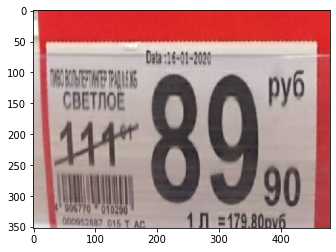

found segment: iBasePrice


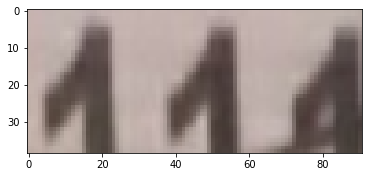

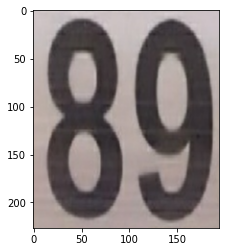

found segment: fBasePrice


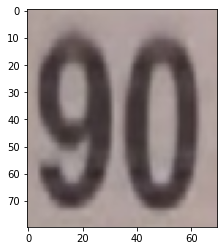

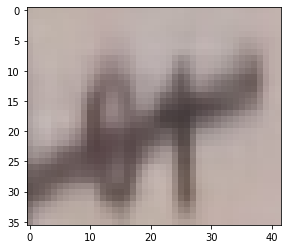

found segment: iOldPrice


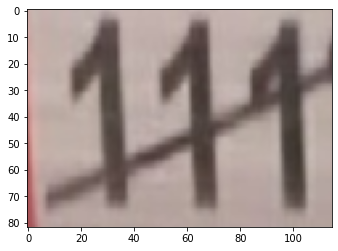

found segment: Name


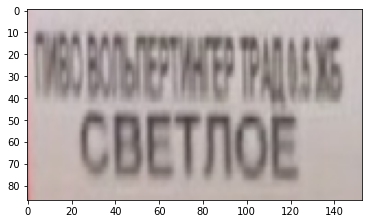

found segment: BarCode


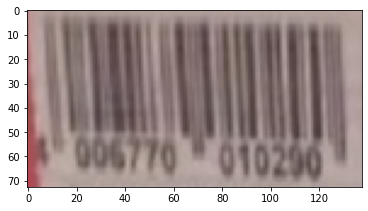

found segment: SKU


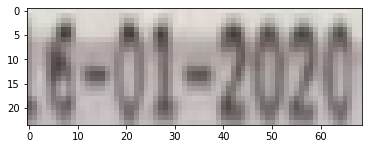

284093aaf2d3e0b3bb1df813b8a84879.jpg


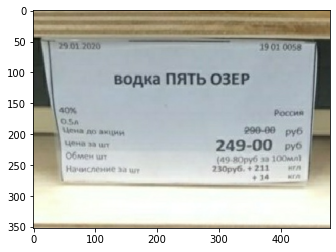

found segment: iBasePrice


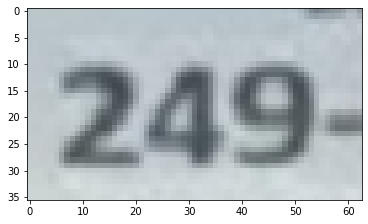

found segment: Name


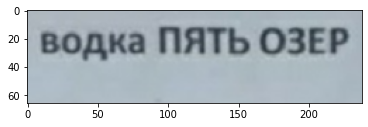

1a300a3bf011f8d8278e0233accbbbfd.jpg


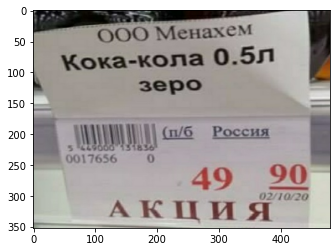

found segment: iBasePrice


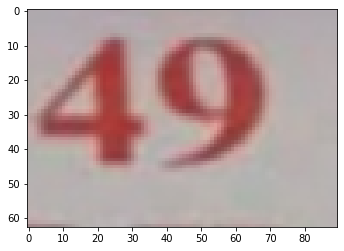

found segment: fBasePrice


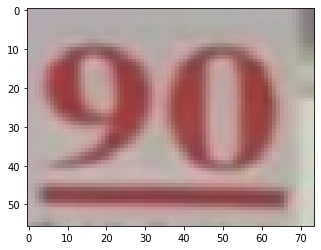

found segment: Name


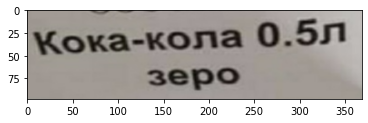

found segment: BarCode


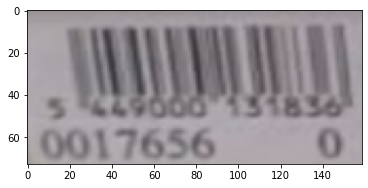

found segment: Vendor


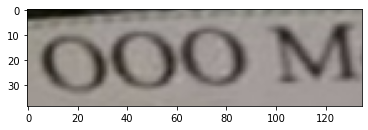

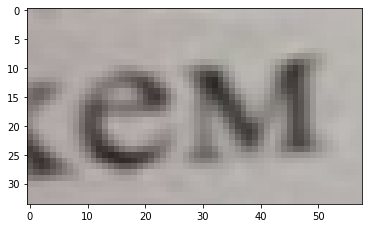

found segment: Country


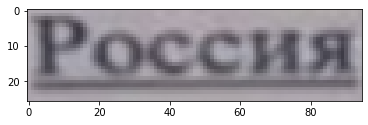

found segment: Promo


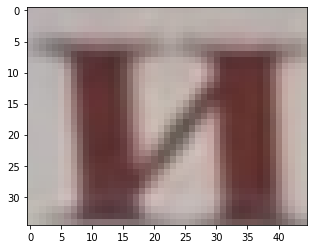

31485cab49d6f1dbee6f9b69c44d11d7_0.jpg


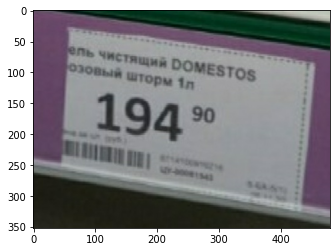

found segment: iBasePrice


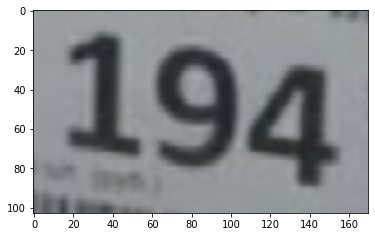

found segment: fBasePrice


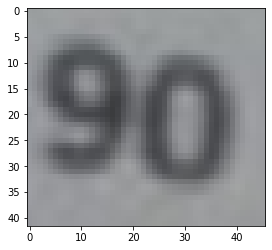

found segment: Name


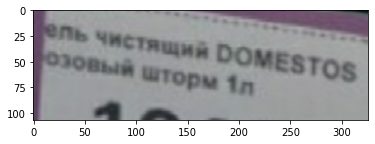

found segment: BarCode


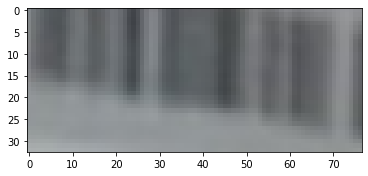

6411ff17a5e0f79cc25e86910f8b86d8_0.jpg


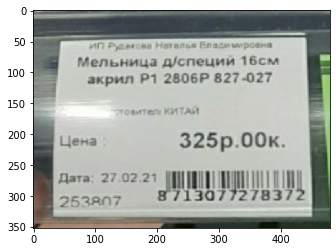

found segment: iBasePrice


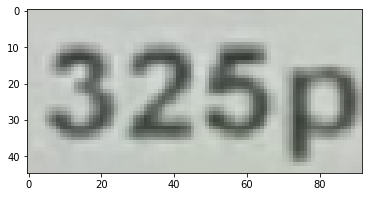

found segment: fBasePrice


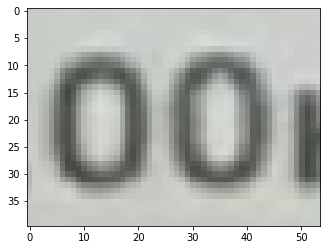

found segment: Name


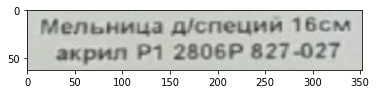

found segment: BarCode


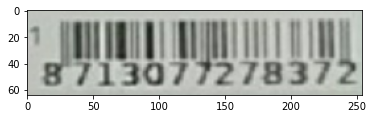

found segment: Vendor


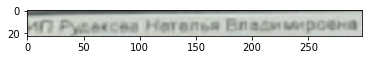

found segment: Country


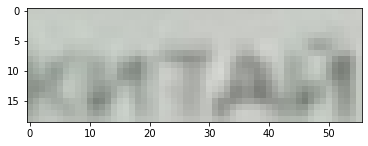

c152952f1718d6761a688012636a4361.jpg


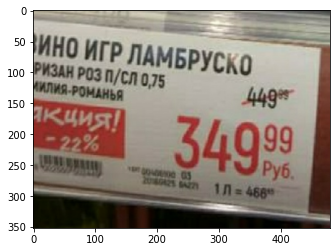

found segment: iBasePrice


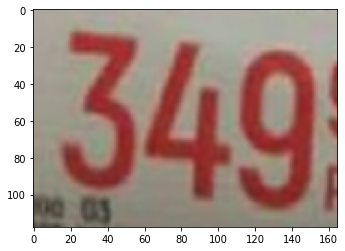

found segment: fBasePrice


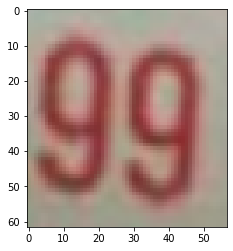

found segment: iOldPrice


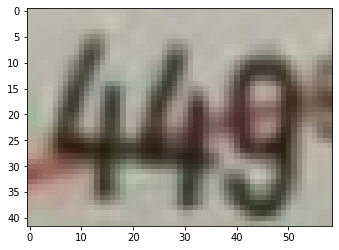

found segment: Name


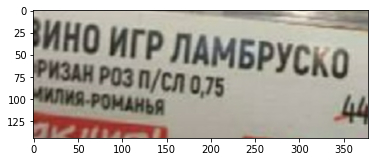

05e91d1f30f0cffa09e0e00a9b397e01.jpg


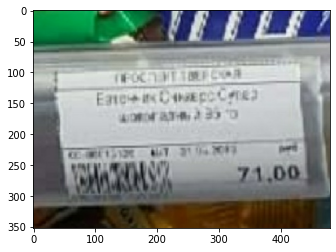

found segment: iBasePrice


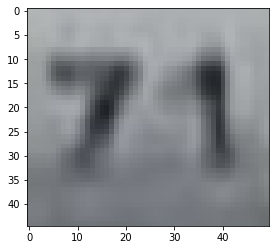

found segment: fBasePrice


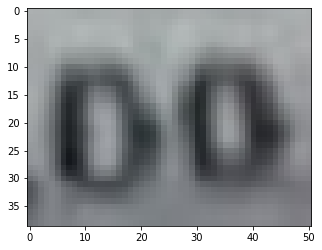

found segment: Name


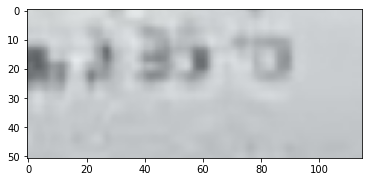

found segment: Promo


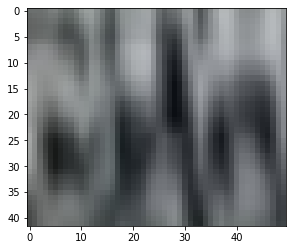

3642f3eb7dfe2bf584e1e14a5fd754b2_0.jpg


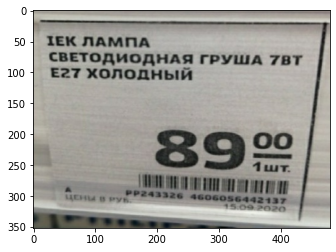

found segment: iBasePrice


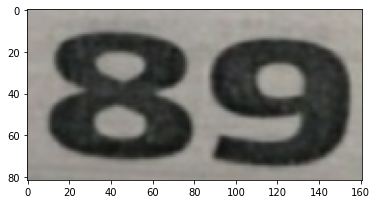

found segment: fBasePrice


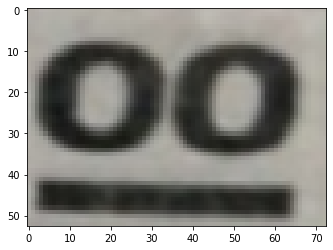

found segment: Name


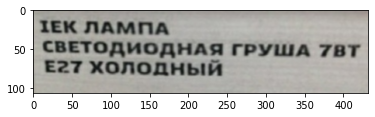

found segment: BarCode


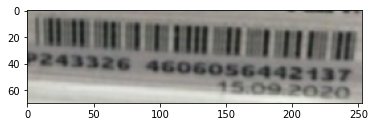

bed26029a1d5946842af6f33910b9269.jpg


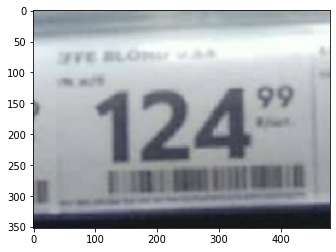

found segment: iBasePrice


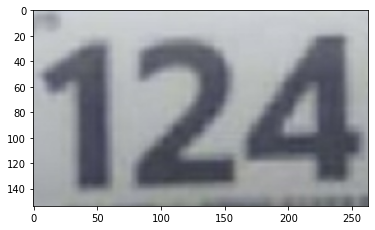

found segment: fBasePrice


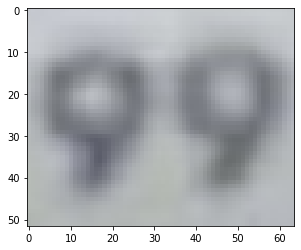

5826171c50674a172d7d304b7d5ca65c.jpg


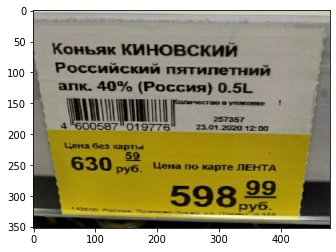

found segment: iBasePrice


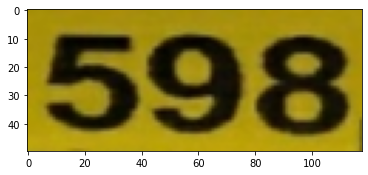

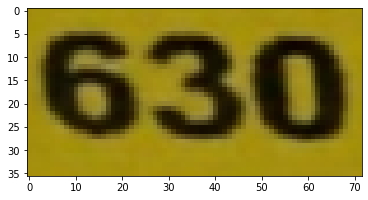

found segment: fBasePrice


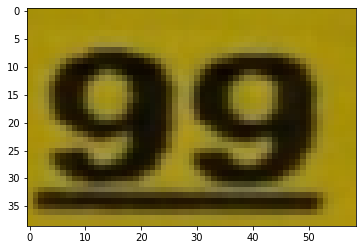

found segment: Name


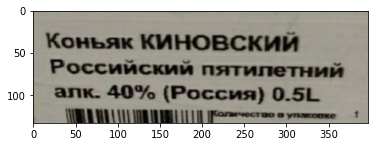

found segment: BarCode


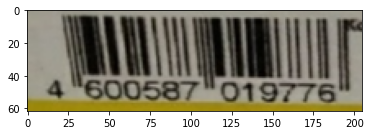

322dba86e74e6793cc7899c5a65a1dfa.jpg


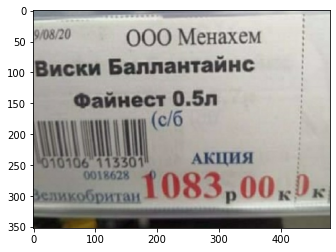

found segment: iBasePrice


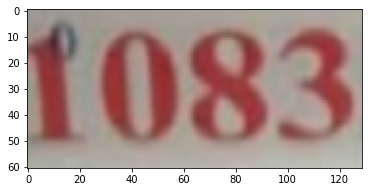

found segment: fBasePrice


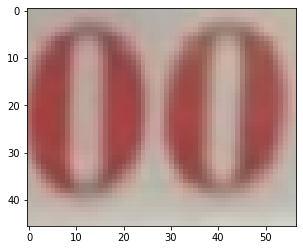

found segment: iPromoPrice


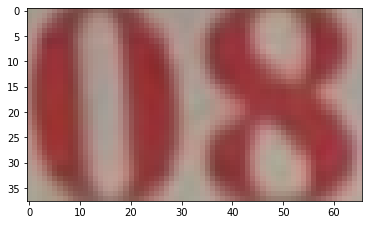

found segment: Name


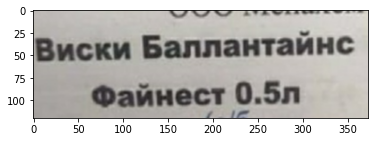

found segment: BarCode


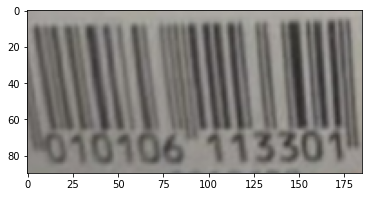

found segment: Vendor


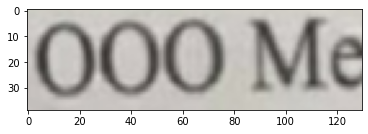

found segment: SKU


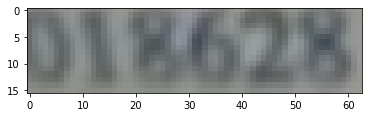

found segment: Country


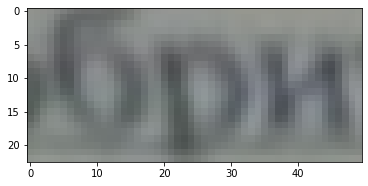

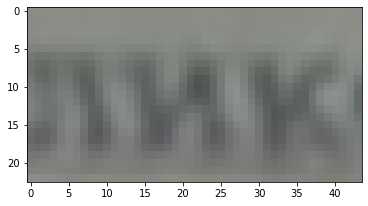

b7c3150ddfa35900d8e9996bec51b2c8.jpg


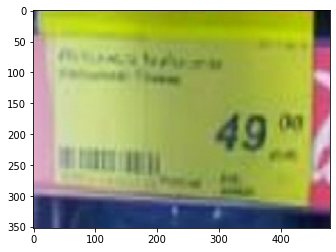

found segment: iBasePrice


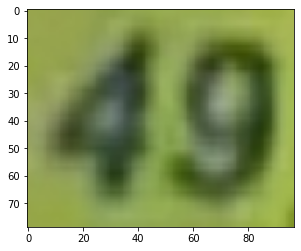

found segment: fBasePrice


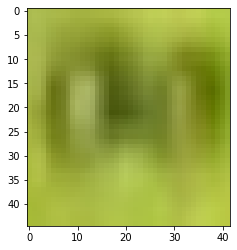

e92be9bf0ed7fffce51a81b9294745e1.jpg


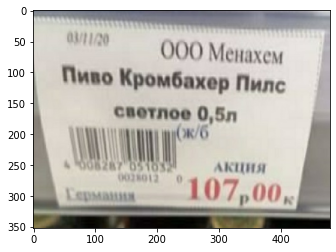

found segment: iBasePrice


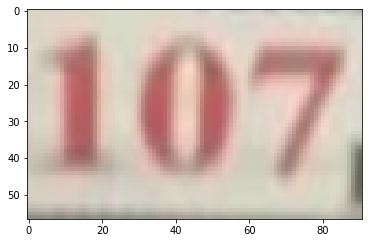

found segment: Name


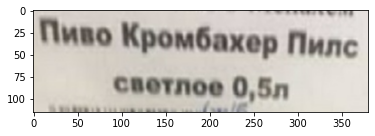

found segment: BarCode


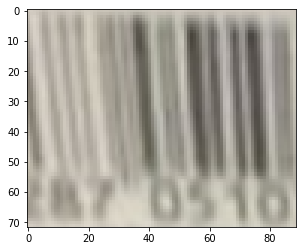

found segment: Vendor


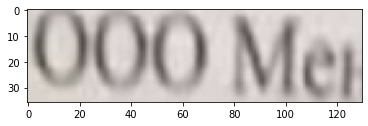

41efa8fdc0d65fd78b6fa0a64466c8af_0.jpg


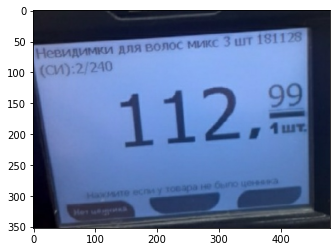

found segment: iBasePrice


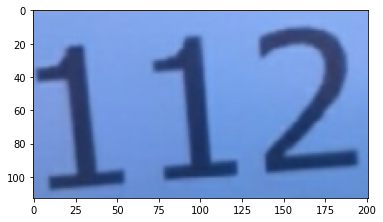

found segment: fBasePrice


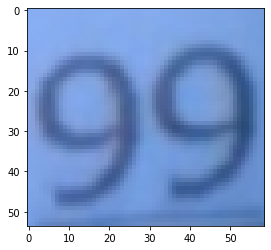

found segment: Name


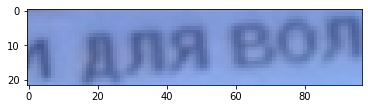

In [56]:
for _ in range(100):
    filename = random.sample(os.listdir(TARGET_IMG_PATH), 1)[0]
    print(filename)
    img = load_image(TARGET_IMG_PATH + filename)#, target_size=IMG_SIZE)   
    plt.imshow(img)
    plt.show()
    segments = extract_segments(img)
    
    for seg_index in segments:
        print(f'found segment: {CLASSES[seg_index]["id"]}')
        
        for img in segments[seg_index]:
            plt.imshow(img)
            plt.show()